In [1]:
import sys

sys.path.append("../")

In [2]:
%load_ext autoreload
%autoreload 2

In [138]:
from rumboost.rumboost import rum_train
from rumboost.datasets import load_preprocess_LPMC
from rumboost.metrics import cross_entropy
from rumboost.utility_smoothing import optimal_knots_position, map_x_knots, smooth_predict, updated_utility_collection
from rumboost.utility_plotting import plot_spline, weights_to_plot_v2, plot_VoT, plot_pop_VoT

import lightgbm
import numpy as np
import hyperopt

# Example: Utility smoothing and VoT

This notebook shows features implemented in RUMBoost through an example on the LPMC dataset, a mode choice dataset in London developed Hillel et al. (2018). You can find the original source of data [here](https://www.icevirtuallibrary.com/doi/suppl/10.1680/jsmic.17.00018) and the original paper [here](https://www.icevirtuallibrary.com/doi/full/10.1680/jsmic.17.00018).

We first load the preprocessed dataset and its folds for cross-validation. You can find the data under the Data folder

In [139]:
#load dataset
LPMC_train, LPMC_test, folds = load_preprocess_LPMC(path="../Data/")

## Utility smoothing

The utility is smoothed using piece-wise cubic hermite splines. Each spline is linked through knots where they have equal values and derivatives. The number of knots is treated as a hyperparameter and is optimised with hyperopt, while their positions are locally optimised using a local optimizer (scipy.minimize). In this example, for computational purposes, the optimal number of knots is taken from a previous hyperparameter search and only their position is optimized. Note that the code used for the hyperparameter search is in comments, and it is possible to use it by uncommenting the appropriate lines.

### Training of a RUMBoost model

As smoothing is a post-processing tool, we first need to train a RUMBoost model. Therefore, we train the final model from the example simple_rumboost.

In [140]:
# parameters
general_params = {
    "n_jobs": -1,
    "num_classes": 4,  # important
    "verbosity": 1,  # specific RUMBoost parameter
    "num_iterations": 1276,
}

In [141]:
rum_structure = [
    {
        "utility": [0],
        "variables": [
            "age",
            "female",
            "day_of_week",
            "start_time_linear",
            "car_ownership",
            "driving_license",
            "purpose_B",
            "purpose_HBE",
            "purpose_HBO",
            "purpose_HBW",
            "purpose_NHBO",
            "fueltype_Average",
            "fueltype_Diesel",
            "fueltype_Hybrid",
            "fueltype_Petrol",
            "distance",
            "dur_walking",
        ],
        "boosting_params": {
            "monotone_constraints_method": "advanced",
            "max_depth": 1,
            "n_jobs": -1,
            "learning_rate": 0.1,
            "monotone_constraints": [
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                -1,
                -1,
            ],
            "interaction_constraints": [
                [0],
                [1],
                [2],
                [3],
                [4],
                [5],
                [6],
                [7],
                [8],
                [9],
                [10],
                [11],
                [12],
                [13],
                [14],
                [15],
                [16],
            ],
        },
        "shared": False,
    },
    {
        "utility": [1],
        "variables": [
            "age",
            "female",
            "day_of_week",
            "start_time_linear",
            "car_ownership",
            "driving_license",
            "purpose_B",
            "purpose_HBE",
            "purpose_HBO",
            "purpose_HBW",
            "purpose_NHBO",
            "fueltype_Average",
            "fueltype_Diesel",
            "fueltype_Hybrid",
            "fueltype_Petrol",
            "distance",
            "dur_cycling",
        ],
        "boosting_params": {
            "monotone_constraints_method": "advanced",
            "max_depth": 1,
            "n_jobs": -1,
            "learning_rate": 0.1,
            "monotone_constraints": [
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                -1,
                -1,
            ],
            "interaction_constraints": [
                [0],
                [1],
                [2],
                [3],
                [4],
                [5],
                [6],
                [7],
                [8],
                [9],
                [10],
                [11],
                [12],
                [13],
                [14],
                [15],
                [16],
            ],
        },
        "shared": False,
    },
    {
        "utility": [2],
        "variables": [
            "age",
            "female",
            "day_of_week",
            "start_time_linear",
            "car_ownership",
            "driving_license",
            "purpose_B",
            "purpose_HBE",
            "purpose_HBO",
            "purpose_HBW",
            "purpose_NHBO",
            "fueltype_Average",
            "fueltype_Diesel",
            "fueltype_Hybrid",
            "fueltype_Petrol",
            "distance",
            "dur_pt_access",
            "dur_pt_bus",
            "dur_pt_rail",
            "dur_pt_int_waiting",
            "dur_pt_int_walking",
            "pt_n_interchanges",
            "cost_transit",
        ],
        "boosting_params": {
            "monotone_constraints_method": "advanced",
            "max_depth": 1,
            "n_jobs": -1,
            "learning_rate": 0.1,
            "monotone_constraints": [
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                -1,
                -1,
                -1,
                -1,
                -1,
                -1,
                -1,
                -1,
            ],
            "interaction_constraints": [
                [0],
                [1],
                [2],
                [3],
                [4],
                [5],
                [6],
                [7],
                [8],
                [9],
                [10],
                [11],
                [12],
                [13],
                [14],
                [15],
                [16],
                [17],
                [18],
                [19],
                [20],
                [21],
                [22],
            ],
        },
        "shared": False,
    },
    {
        "utility": [3],
        "variables": [
            "age",
            "female",
            "day_of_week",
            "start_time_linear",
            "car_ownership",
            "driving_license",
            "purpose_B",
            "purpose_HBE",
            "purpose_HBO",
            "purpose_HBW",
            "purpose_NHBO",
            "fueltype_Average",
            "fueltype_Diesel",
            "fueltype_Hybrid",
            "fueltype_Petrol",
            "distance",
            "dur_driving",
            "cost_driving_fuel",
            "congestion_charge",
            "driving_traffic_percent",
        ],
        "boosting_params": {
            "monotone_constraints_method": "advanced",
            "max_depth": 1,
            "n_jobs": -1,
            "learning_rate": 0.1,
            "monotone_constraints": [
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                0,
                -1,
                -1,
                -1,
                -1,
                -1,
            ],
            "interaction_constraints": [
                [0],
                [1],
                [2],
                [3],
                [4],
                [5],
                [6],
                [7],
                [8],
                [9],
                [10],
                [11],
                [12],
                [13],
                [14],
                [15],
                [16],
                [17],
                [18],
                [19],
            ],
        },
        "shared": False,
    },
]

In [142]:
model_specification = {
    "general_params": general_params,
    "rum_structure": rum_structure,
}

In [143]:
# features and label column names
features = [f for f in LPMC_train.columns if f != "choice"]
label = "choice"

# create lightgbm dataset
lgb_train_set = lightgbm.Dataset(
    LPMC_train[features], label=LPMC_train[label], free_raw_data=False
)
lgb_test_set = lightgbm.Dataset(
    LPMC_test[features], label=LPMC_test[label], free_raw_data=False
)

In [144]:
#train the model
LPMC_model_fully_trained = rum_train(lgb_train_set, model_specification)

#predicts classes on test set
preds = LPMC_model_fully_trained.predict(lgb_test_set)

#compute cross entropy on the test set
ce_test = cross_entropy(preds, lgb_test_set.get_label().astype(int))

print('-'*50)
print(f'Final negative cross-entropy on the test set: {ce_test}')

/Users/leovilardo/rumboost/examples/../rumboost/rumboost.py:1917: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000762 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 854
[LightGBM] [Info] Number of data points in the train set: 54766, number of used features: 17
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001351 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 854
[LightGBM] [Info] Number of data points in the train set: 54766, number of used features: 17
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1834
[LightGBM] [Info] Number of

### Hyperparameter search: optimal number of knots

The optimal number of knots is found with hyperopt. For computational purposes we show here only one iteration, but we ran that code with 25 iterations for the paper. Given a number of knots, the optimal positions of knots can be found with the ```optimal_knots_position()``` function.

**The basic settings for functions smoothing are**:

- First and last knots fixed
- Optimisation of the BIC
- Optimisation of the postion with scipy.minimize

In [166]:
param_space = {'0':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_0', 3, 7,1)),
                    'dur_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_walking', 3, 7,1))},
            '1':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_1', 3, 7,1)),
                    'dur_cycling': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_cycling', 3, 7,1))},
            '2':{'cost_transit': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_transit', 3, 7,1)),
                    #'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_2', 3, 7,1)),
                    'dur_pt_access': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_access', 3, 7,1)),
                    'dur_pt_bus': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_bus', 3, 7,1)),
                    'dur_pt_int_waiting': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_waiting', 3, 7,1)),
                    'dur_pt_int_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_walking', 3, 7,1)),
                    'dur_pt_rail': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_rail', 3, 7,1))},
            '3':{'cost_driving_fuel': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_driving_fuel', 3, 7,1)),
                    'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_3', 3, 7,1)),
                    'driving_traffic_percent': hyperopt.pyll.scope.int(hyperopt.hp.quniform('driving_traffic_percent', 3, 7,1)),
                    'dur_driving': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_driving', 3, 7,1))}
                }

#optimal number of splines (number of knots-1)
#param_space = {'0':{'distance': 5,
#                    'dur_walking': 5},
#            '1':{'distance': 5,
#                    'dur_cycling': 6},
#            '2':{'cost_transit': 3,
#                    #'distance': 5,
#                    'dur_pt_access': 3,
#                    'dur_pt_bus': 3,
#                    'dur_pt_int_waiting': 7,
#                    'dur_pt_int_walking': 6,
#                    'dur_pt_rail': 3},
#            '3':{'cost_driving_fuel': 5,
#                    'distance': 3,
#                    'driving_traffic_percent': 7,
#                    'dur_driving': 4}
#                }

Optimisation of knots position for hyperopt

In [167]:
def objective(space):
    dataset_train, _, _ = load_preprocess_LPMC(path="../Data/")
        
    weights = weights_to_plot_v2(LPMC_model_fully_trained)

    spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['distance', 'dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_access', 'dur_pt_int_walking', 'dur_pt_int_waiting'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}

    target = 'choice'

    spline_collection = space

    x_opt, x_first, x_last, loss = optimal_knots_position(weights, dataset_train, dataset_train, dataset_train[target], spline_utilities, spline_collection, max_iter = 200, optimise = True, n_iter=1, first_last_knot_fixed=True)

    return {'loss': loss, 'x_opt':x_opt.x, 'status': hyperopt.STATUS_OK, 'x_first': x_first, 'x_last': x_last}

n=25
# n=1
trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n,
                                trials=trials)

best_classifier['_best_loss'] = trials.best_trial['result']['loss']
best_classifier['_x_opt'] = trials.best_trial['result']['x_opt']
best_classifier['_x_first'] = trials.best_trial['result']['x_first']
best_classifier['_x_last'] = trials.best_trial['result']['x_last']

  0%|          | 0/25 [00:00<?, ?trial/s, best loss=?]

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)
            Current function value:                   
71760.55526070406                                     
            Iterations:                               
97                                                    
            Function evaluations:                     
5855                                                  
            Gradient evaluations:                     
93                                                    
1/1:71760.55526070406 with knots at: [ 2.10355838  9.68591676 18.10880971  0.32847223  3.16467184  3.46561693
  3.78712608  4.73006524  5.68516642  1.63728938  8.11985722 11.14552041
 15.17100787 20.45962219  0.38389711  0.77588022  1.1866339   1.65296777
  1.69348544  4.03433482  7.7699853   9.28984407  0.35768649  0.44070047
  0.67886887  0.4396774   0.73830346  0.80418278  0.87138172  1.2739368
  1.44321606  0.26974173  0.37035316  0.50946069  0.54920437  0.05057494
  0.07854725  0.119789

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                                
            Current function value:                                                   
71749.79714215396                                                                     
            Iterations:                                                               
91                                                                                    
            Function evaluations:                                                     
5323                                                                                  
            Gradient evaluations:                                                     
88                                                                                    
1/1:71749.79714215396 with knots at: [ 2.22713839  8.10595906 16.90909895  0.32847338  2.33033938  3.56218264
  6.46186316  6.67536714  3.08768539 18.29361425 21.25985814  0.26637858
  0.57300478  0.70429265  0.80127999

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                   
71768.65004094693                                                                     
            Iterations:                                                               
119                                                                                   
            Function evaluations:                                                     
6751                                                                                  
            Gradient evaluations:                                                     
115                                                                                   
1/1:71768.65004094693 with knots at: [ 0.97332412  9.5820331  18.82737511 23.72008749  0.67597218  1.69064131
  6.43363231  3.55916212 17.13882005 23.72945712 27.45731628  0.17401276
  0.68383495  0.82307284  1.717927

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                   
71590.88921047775                                                                     
            Iterations:                                                               
123                                                                                   
            Function evaluations:                                                     
6648                                                                                  
            Gradient evaluations:                                                     
119                                                                                   
1/1:71590.88921047775 with knots at: [ 2.10760788  3.89336268  5.2665499   8.7707462  15.62132218  0.32847222
  2.01020396  3.78674544  4.17859261  4.73725132  5.56755276  1.52039607
  4.49254907 10.28153615 17.440351

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                   
75625.08411327281                                                                     
            Iterations:                                                               
93                                                                                    
            Function evaluations:                                                     
5468                                                                                  
            Gradient evaluations:                                                     
89                                                                                    
1/1:75625.08411327281 with knots at: [2.58083119e-01 6.83717727e-01 1.87719903e+01 5.43504581e-01
 7.92113850e+00 8.63639595e+00 3.20305825e-01 3.78996908e-01
 1.72927650e+01 2.50815270e+01 3.62425345e-02 5.99339365e-

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                                  
            Current function value:                                                   
73047.26813429731                                                                     
            Iterations:                                                               
68                                                                                    
            Function evaluations:                                                     
3689                                                                                  
            Gradient evaluations:                                                     
65                                                                                    
1/1:73047.26813429731 with knots at: [ 1.6795     14.55728362 17.26355405 20.45887256  1.19488766  2.98409285
  5.40441805 12.03221492 15.40706287 19.00102617  0.48758656  0.92915245
  1.14358628  1.60169123  5.592961

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                   
71729.52947705328                                                                     
            Iterations:                                                               
152                                                                                   
            Function evaluations:                                                     
10488                                                                                 
            Gradient evaluations:                                                     
148                                                                                   
1/1:71729.52947705328 with knots at: [ 1.29820662 10.2856196  12.56386245 14.35528527 18.98880919  0.50484291
  1.65029396  2.43008882  4.44840332  1.27345111  5.36477618 12.57051967
 19.52660389  0.29328616  0.659354

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                                 
            Current function value:                                                   
71658.66157476185                                                                     
            Iterations:                                                               
63                                                                                    
            Function evaluations:                                                     
3468                                                                                  
            Gradient evaluations:                                                     
61                                                                                    
1/1:71658.66157476185 with knots at: [ 1.0758343  11.23350878 17.41850175 20.81876726  0.82896442  2.07227119
  5.99119416  2.19050017 18.87102611 20.34422658 27.12441388  0.48966618
  1.81913511  2.22842034  1.781186

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                   
71723.12517770819                                                                     
            Iterations:                                                               
105                                                                                   
            Function evaluations:                                                     
6177                                                                                  
            Gradient evaluations:                                                     
101                                                                                   
1/1:71723.12517770819 with knots at: [ 2.34356867 15.10996901  0.32847232  2.16777536  7.02975606  3.46726362
 14.44568997 16.97946204 18.37641028 19.39909382 24.15145273  0.19494104
  0.7524945   1.38724701  2.391140

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                      
            Current function value:                                                  
71831.56565003107                                                                    
            Iterations:                                                              
124                                                                                  
            Function evaluations:                                                    
8926                                                                                 
            Gradient evaluations:                                                    
120                                                                                  
1/1:71831.56565003107 with knots at: [ 1.22549997 11.22683251 17.49563814 21.36673384 24.70205651  0.68347257
  1.54714312  3.25606616  4.82552497  1.959749    4.33583828  5.84591303
 17.99112691  0.32707018  0.45499912  0.617

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                                   
            Current function value:                                                    
71892.68137513196                                                                      
            Iterations:                                                                
97                                                                                     
            Function evaluations:                                                      
5559                                                                                   
            Gradient evaluations:                                                      
93                                                                                     
1/1:71892.68137513196 with knots at: [ 2.29339035 15.51563552 20.2025191  24.82349657  0.26875001  0.8962129
  1.17259033  3.40588254  3.70219122  5.59130878  1.4216999  19.11586025
 23.48111459  0.42057425  

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                   
71916.87221903465                                                                     
            Iterations:                                                               
123                                                                                   
            Function evaluations:                                                     
7882                                                                                  
            Gradient evaluations:                                                     
119                                                                                   
1/1:71916.87221903465 with knots at: [ 1.11034918  2.96725019  6.26517108 11.47421569 13.1573296  17.56335864
  0.7750596   1.73879102  3.25251084  4.70956415  2.39485673  8.98256444
 18.2650869   0.33061286  1.387502

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                   
71934.80330619881                                                                     
            Iterations:                                                               
116                                                                                   
            Function evaluations:                                                     
7327                                                                                  
            Gradient evaluations:                                                     
112                                                                                   
1/1:71934.80330619881 with knots at: [ 2.78858657 14.8082374   0.32847222  2.35288016  5.90075937  6.34281881
  6.73346915  3.33519183 17.31574625 20.32243276 23.83117194 27.53885068
  0.19296879  0.74543194  1.550029

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                   
71614.94884571261                                                                     
            Iterations:                                                               
111                                                                                   
            Function evaluations:                                                     
6187                                                                                  
            Gradient evaluations:                                                     
107                                                                                   
1/1:71614.94884571261 with knots at: [ 2.29667109  6.84312424 17.12574823  0.33669452  2.48075832  2.85297421
  4.56172191  2.37069258 14.14733335 19.76411273 21.71523151 24.17354357
  0.38892715  0.77816361  1.318366

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                   
72397.90419905244                                                                     
            Iterations:                                                               
80                                                                                    
            Function evaluations:                                                     
4699                                                                                  
            Gradient evaluations:                                                     
76                                                                                    
1/1:72397.90419905244 with knots at: [ 1.22835263  3.00672411  5.70503812  7.78312172 12.11316356 16.12127424
  1.43817906  4.09855828  3.60247595 18.62351713  0.2980947   0.63774721
  1.08124578  1.22599615  1.744703

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                       
            Current function value:                                                    
171769.49155864914                                                                     
            Iterations:                                                                
81                                                                                     
            Function evaluations:                                                      
4762                                                                                   
            Gradient evaluations:                                                      
77                                                                                     
1/1:171769.49155864914 with knots at: [1.56269210e-01 7.70011151e-02 7.70021151e-02 1.90193320e-01
 4.09408932e+01 3.66051883e-02 2.52779780e-02 2.52780780e-02
 5.98273121e-01 9.27833333e+00 3.37550790e+01 3.4

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                                  
            Current function value:                                                    
71832.11734716187                                                                      
            Iterations:                                                                
25                                                                                     
            Function evaluations:                                                      
1431                                                                                   
            Gradient evaluations:                                                      
24                                                                                     
1/1:71832.11734716187 with knots at: [ 1.5065     13.08704218 21.61965738  0.62505707  2.9389299   5.17031257
  2.58167712 18.12366643 23.16237764 24.61826565 27.00011206  0.30837756
  0.52833252  1.71753881 

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                        
            Current function value:                                                    
71735.93747901433                                                                      
            Iterations:                                                                
141                                                                                    
            Function evaluations:                                                      
8342                                                                                   
            Gradient evaluations:                                                      
137                                                                                    
1/1:71735.93747901433 with knots at: [ 1.07250005 10.78309068 23.57401948  0.82492631  2.25436224  5.9431349
  1.84450001 10.59199995 14.36343974 19.06267446 24.05028226  0.51182774
  2.37631104  2.16589185  

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                                  
            Current function value:                                                    
71735.75550036845                                                                      
            Iterations:                                                                
94                                                                                     
            Function evaluations:                                                      
5421                                                                                   
            Gradient evaluations:                                                      
92                                                                                     
1/1:71735.75550036845 with knots at: [ 1.2255     10.30250558 22.64369117  0.72481174  1.62709974  5.45541518
  3.5589458  23.71146002  0.18631955  0.87568575  1.40093803  2.15012411
  1.87600261  4.2547573  

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                        
            Current function value:                                                    
71726.39452532257                                                                      
            Iterations:                                                                
114                                                                                    
            Function evaluations:                                                      
7181                                                                                   
            Gradient evaluations:                                                      
110                                                                                    
1/1:71726.39452532257 with knots at: [2.14449999e+00 1.78040768e+01 2.12294856e+01 2.40173357e+01
 3.29801785e-01 3.01113194e+00 3.38323180e+00 3.83633856e+00
 6.24675740e+00 2.66968991e+00 4.67212198e+00 1.2

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                        
            Current function value:                                                    
71678.12887216767                                                                      
            Iterations:                                                                
96                                                                                     
            Function evaluations:                                                      
5062                                                                                   
            Gradient evaluations:                                                      
92                                                                                     
1/1:71678.12887216767 with knots at: [ 2.16492879  4.01572762  5.81452345  9.73270822 15.1388737   0.42430568
  1.11182727  1.51197024  2.55459158  3.32997458  4.25715167  1.44456736
  5.57658921  7.09865609 

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                        
            Current function value:                                                    
71532.97681160114                                                                      
            Iterations:                                                                
130                                                                                    
            Function evaluations:                                                      
7376                                                                                   
            Gradient evaluations:                                                      
126                                                                                    
1/1:71532.97681160114 with knots at: [ 1.21660432  3.52725243  5.78320084 11.15520747 12.97575803 18.21155525
  0.70590404  1.05009719  1.38797642  1.87904795  2.76662604  4.489355
  1.45675972  4.29747593  6

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                                   
            Current function value:                                                    
71821.62686640919                                                                      
            Iterations:                                                                
93                                                                                     
            Function evaluations:                                                      
5048                                                                                   
            Gradient evaluations:                                                      
90                                                                                     
1/1:71821.62686640919 with knots at: [ 1.2255      3.13077243  4.51006936  7.78363824  9.30043871 18.09785751
  0.79547299  1.1109055   1.38226182  2.47364694  3.24461427  5.01027504
  3.61577589 18.97327212 

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Positive directional derivative for linesearch    (Exit mode 8)                        
            Current function value:                                                    
71546.93498366443                                                                      
            Iterations:                                                                
197                                                                                    
            Function evaluations:                                                      
12093                                                                                  
            Gradient evaluations:                                                      
193                                                                                    
1/1:71546.93498366443 with knots at: [ 1.12218096  2.54378903  4.02886058 10.29666685 17.32226348 21.17838353
  0.58165538  1.01356906  1.33961787  5.83702752  6.63893572  7.05405484
  1.34088139  3.3669104  

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                                   
            Current function value:                                                    
71785.07741964959                                                                      
            Iterations:                                                                
122                                                                                    
            Function evaluations:                                                      
7124                                                                                   
            Gradient evaluations:                                                      
118                                                                                    
1/1:71785.07741964959 with knots at: [ 1.2255      3.59549998  7.42701437 11.36451572 14.13849439 21.27922495
  0.71647192  1.35815795  2.23519879  2.67770058  4.26501218  1.61546265
  5.20656694  6.50047886 

## Testing on out-of-sample data

Given the optimal knot position, we can validate our approach by computing the cross entropy loss on out-of-sample data. 
This can vary from the value displayed in the paper due to randomness in the optimisation solver

In [168]:
weights = weights_to_plot_v2(LPMC_model_fully_trained)

spline_collection = {'0':{'distance': int(best_classifier['distance_0']),
                    'dur_walking': int(best_classifier['dur_walking'])},
            '1':{'distance': int(best_classifier['distance_1']),
                    'dur_cycling': int(best_classifier['dur_cycling'])},
            '2':{'cost_transit': int(best_classifier['cost_transit']),
                    #'distance': int(best_classifier['distance_2']),
                    'dur_pt_access': int(best_classifier['dur_pt_access']),
                    'dur_pt_bus': int(best_classifier['dur_pt_bus']),
                    'dur_pt_int_waiting': int(best_classifier['dur_pt_int_waiting']),
                    'dur_pt_int_walking': int(best_classifier['dur_pt_int_walking']),
                    'dur_pt_rail': int(best_classifier['dur_pt_rail'])},
            '3':{'cost_driving_fuel': int(best_classifier['cost_driving_fuel']),
                    'distance': int(best_classifier['distance_3']),
                    'driving_traffic_percent': int(best_classifier['driving_traffic_percent']),
                    'dur_driving': int(best_classifier['dur_driving'])}
                }

print(f"Knot numbers: {spline_collection}")
#spline_collection = {'0':{'distance': 4,
#                    'dur_walking': 5},
#            '1':{'distance': 7,
#                    'dur_cycling': 6},
#            '2':{'cost_transit': 3,
#                    #'distance': 3,
#                    'dur_pt_access': 3,
#                    'dur_pt_bus': 7,
#                    'dur_pt_int_waiting': 4,
#                    'dur_pt_int_walking': 7,
#                    'dur_pt_rail': 3},
#            '3':{'cost_driving_fuel': 5,
#                    'distance': 3,
#                    'driving_traffic_percent': 7,
#                    'dur_driving': 4}
#                }
spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_int_waiting', 'dur_pt_int_walking', 'dur_pt_access'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}
x_knots_dict = map_x_knots(trials.best_trial['result']['x_opt'], spline_collection, trials.best_trial['result']['x_first'], trials.best_trial['result']['x_last'])
util_collection = updated_utility_collection(weights, LPMC_train, spline_collection, spline_utilities, mean_splines=False, x_knots = x_knots_dict)

y_pred = smooth_predict(LPMC_test, util_collection)
CE_final = cross_entropy(y_pred, LPMC_test['choice'])
best_classifier['_on_test_set'] = CE_final

print(f'Smoothed final cross entropy loss: {CE_final}')

Knot numbers: {'0': {'distance': 7, 'dur_walking': 7}, '1': {'distance': 7, 'dur_cycling': 6}, '2': {'cost_transit': 3, 'dur_pt_access': 5, 'dur_pt_bus': 3, 'dur_pt_int_waiting': 4, 'dur_pt_int_walking': 3, 'dur_pt_rail': 7}, '3': {'cost_driving_fuel': 3, 'distance': 3, 'driving_traffic_percent': 5, 'dur_driving': 4}}
Smoothed final cross entropy loss: 0.6726482617170773


## Plotting smoothed utility functions

We can use the result to plot the utility functions.

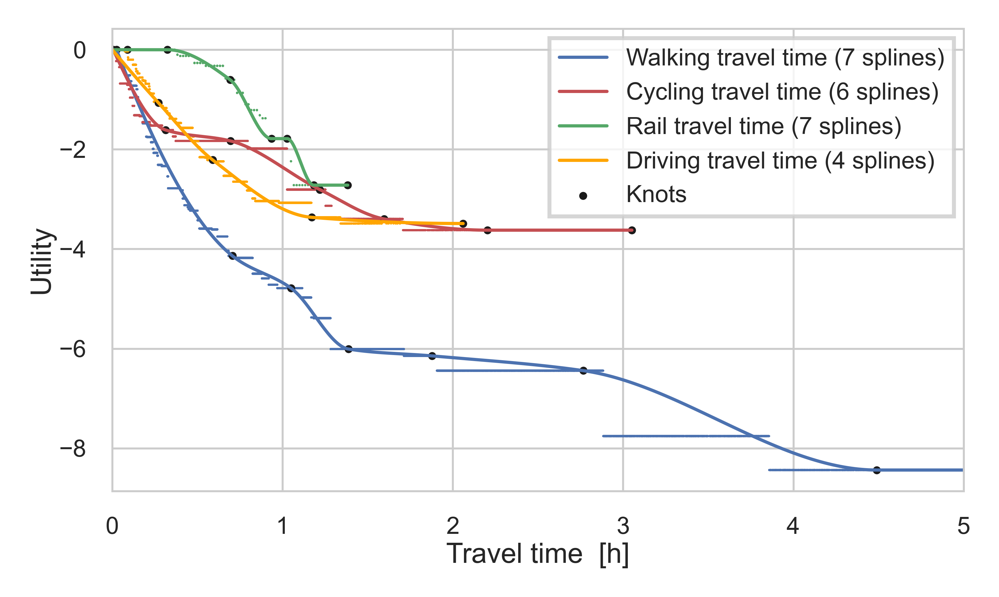

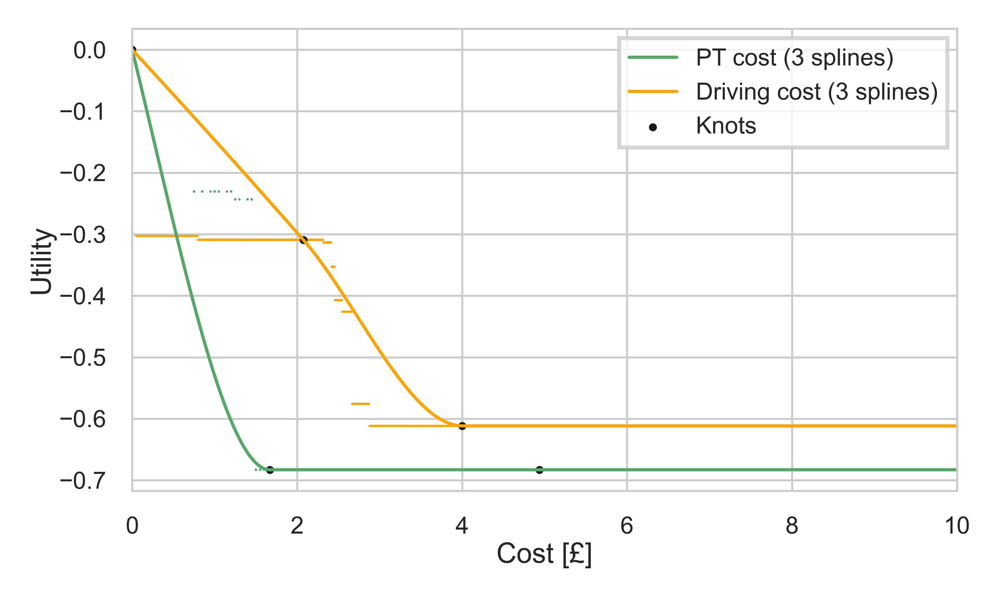

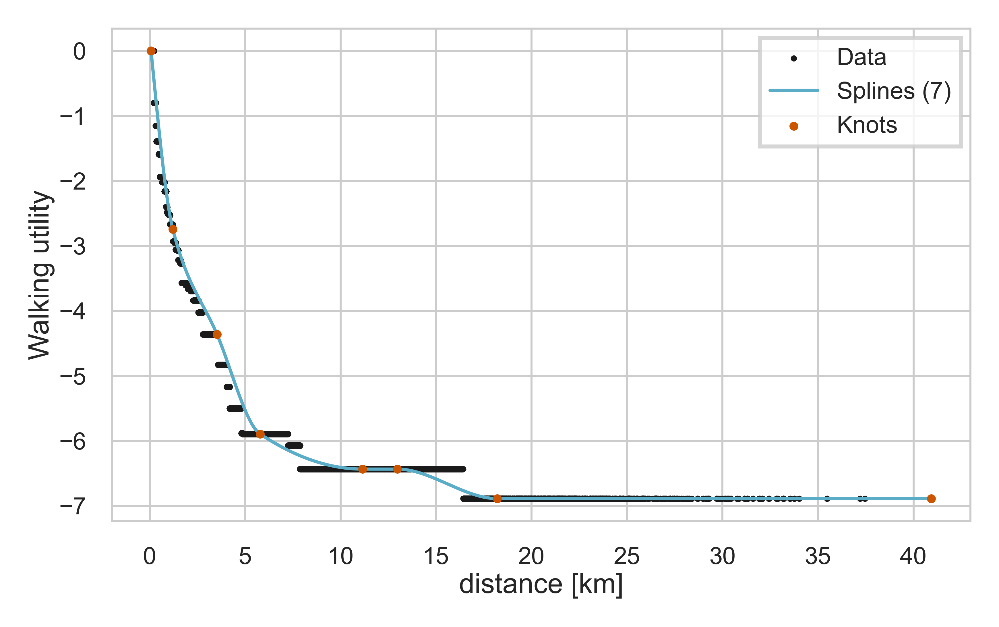

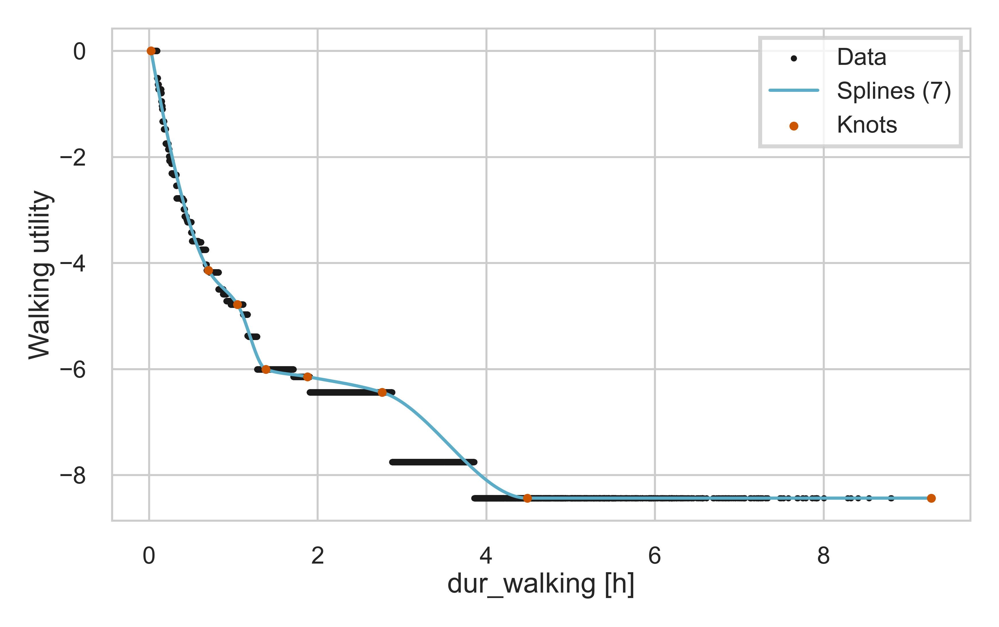

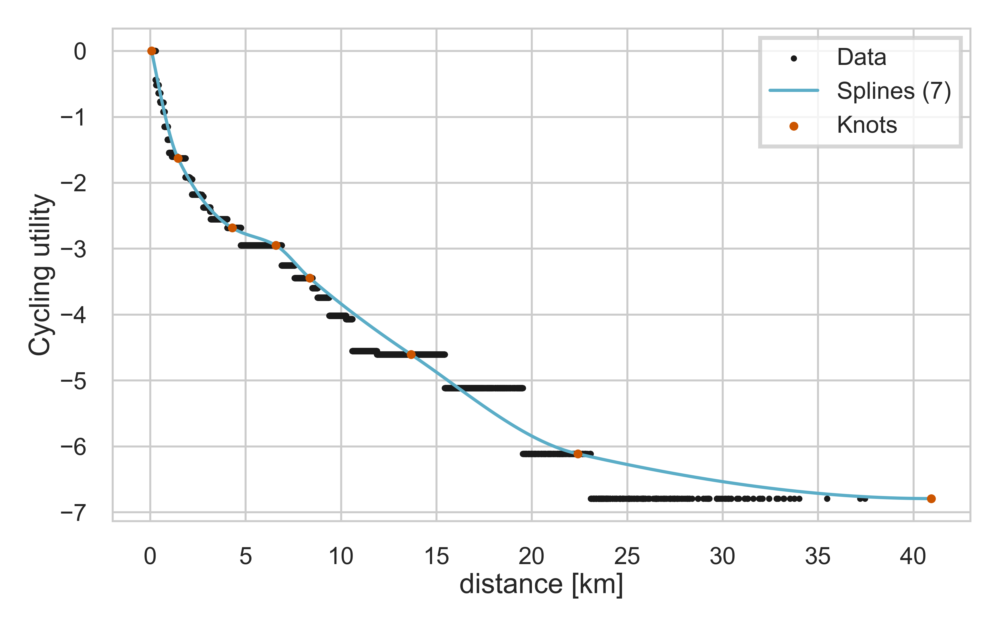

...

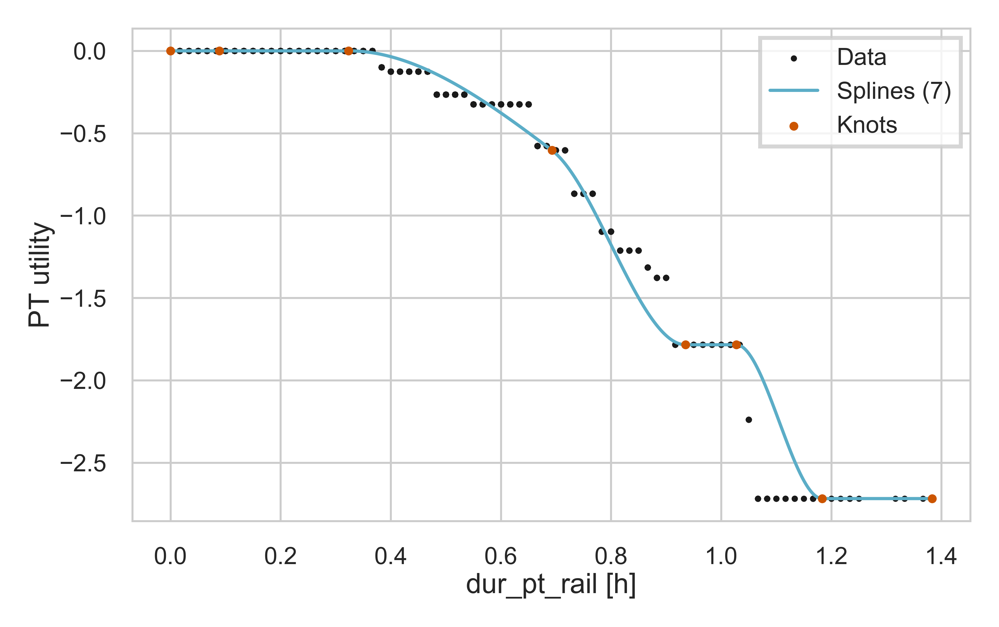

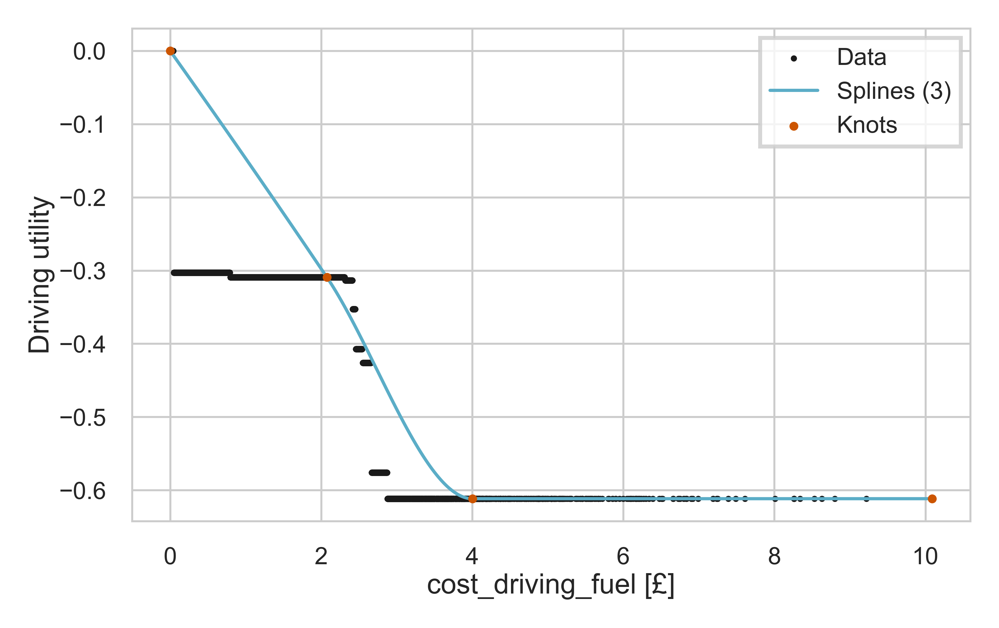

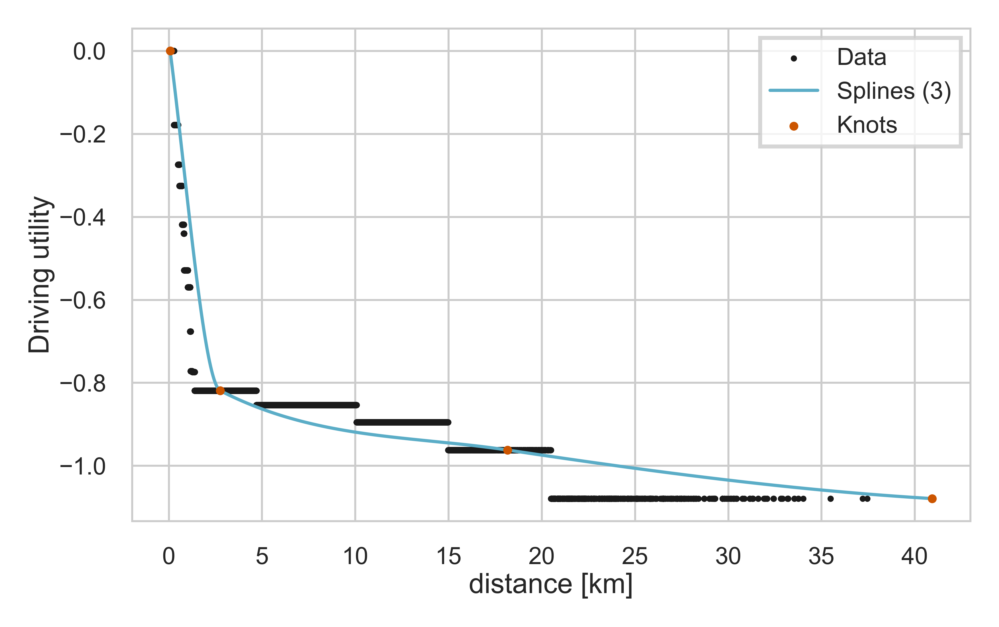

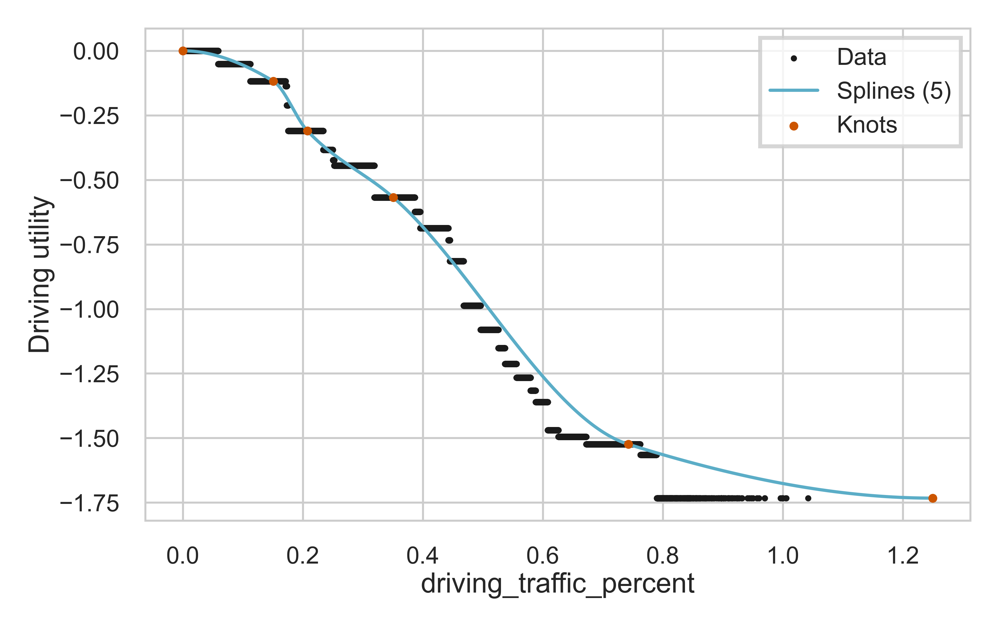

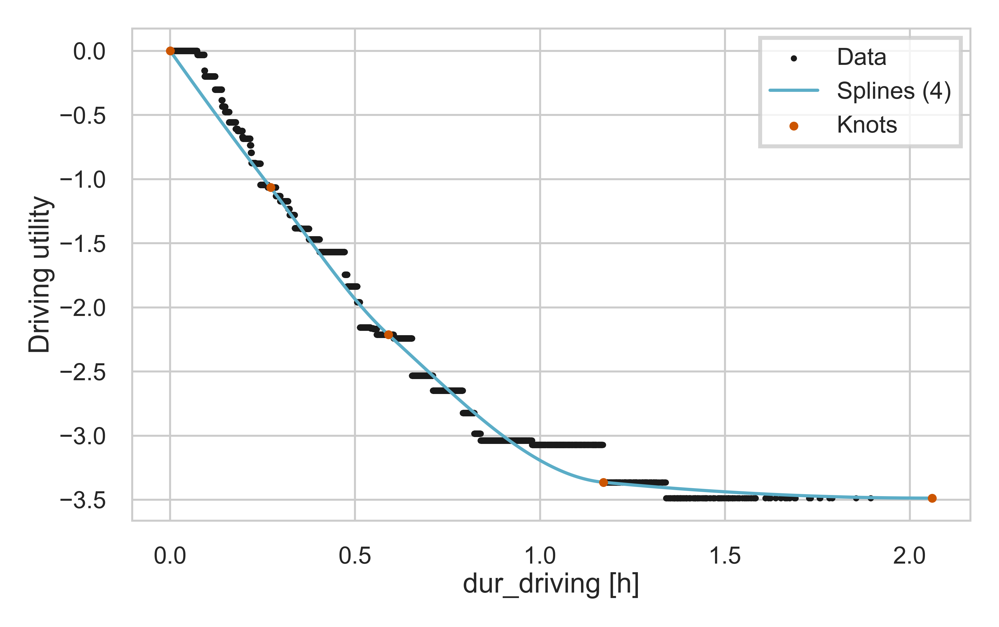

In [169]:
best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True)

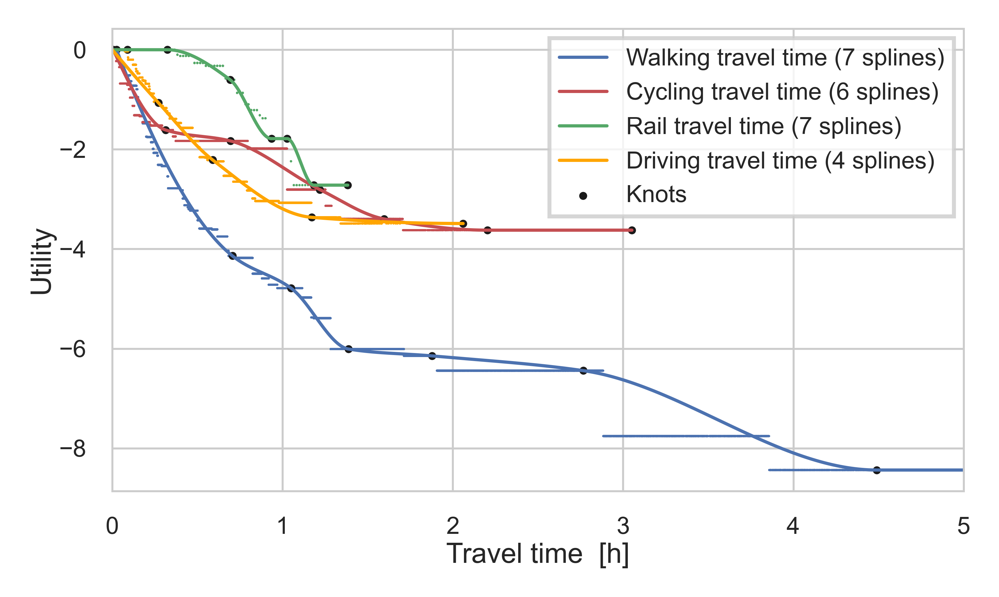

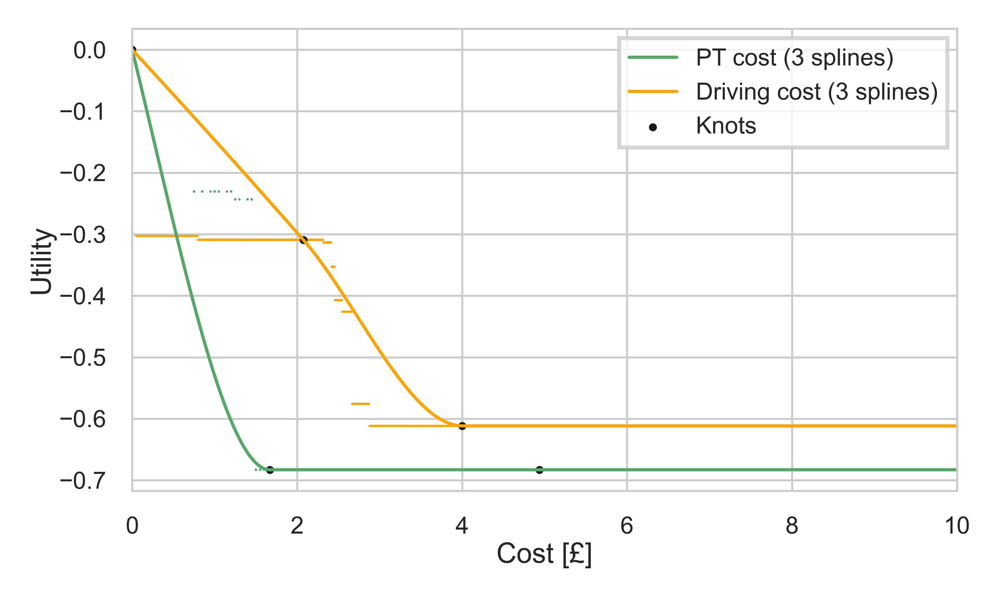

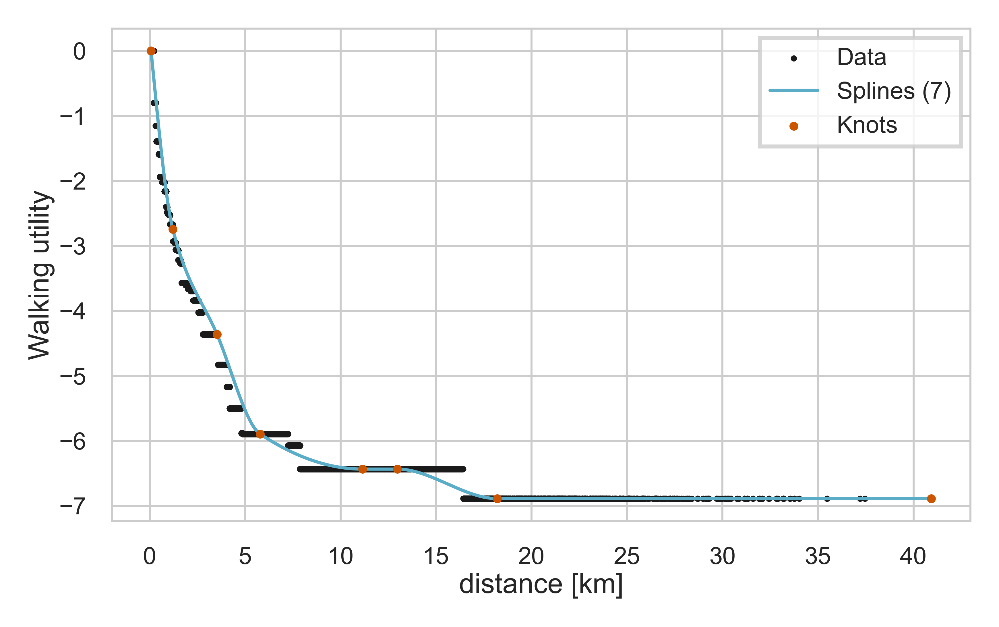

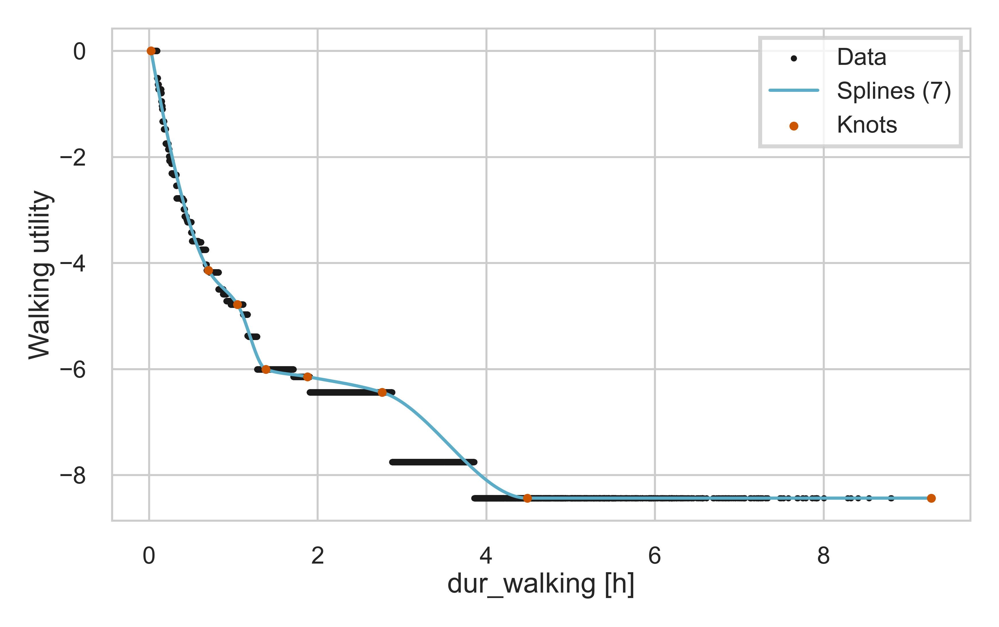

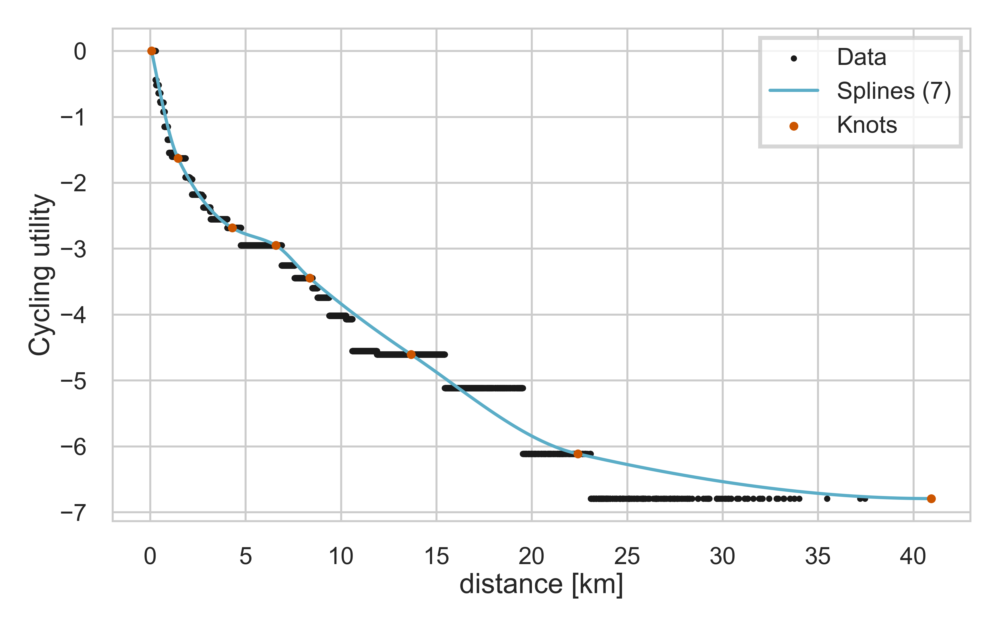

...

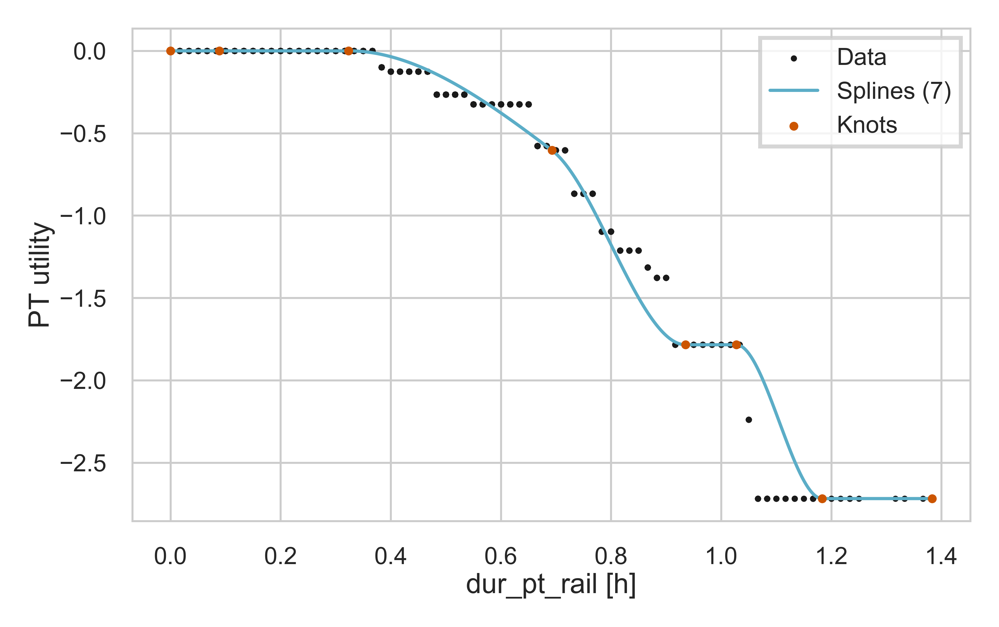

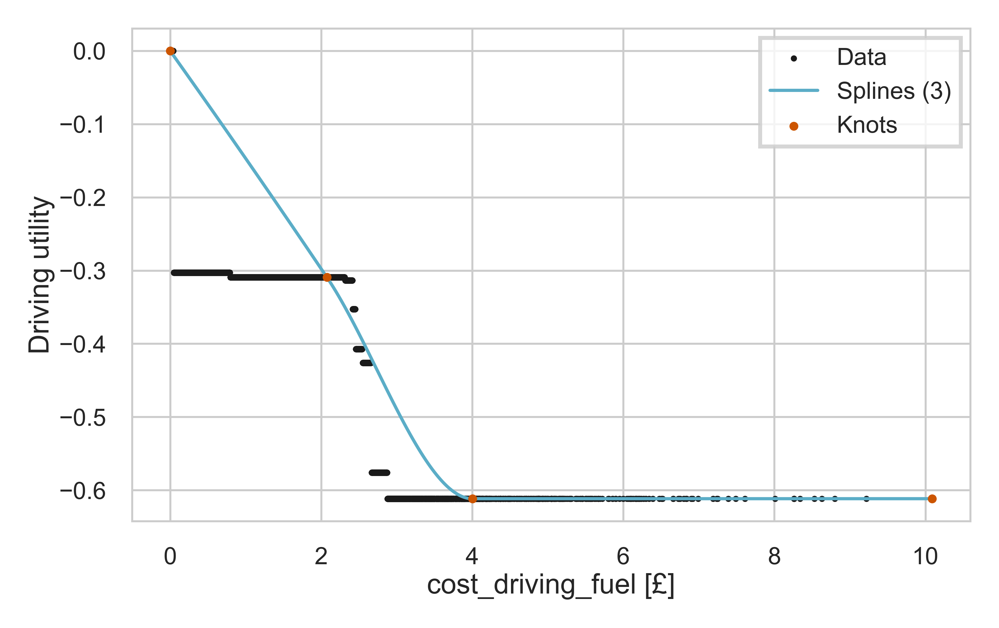

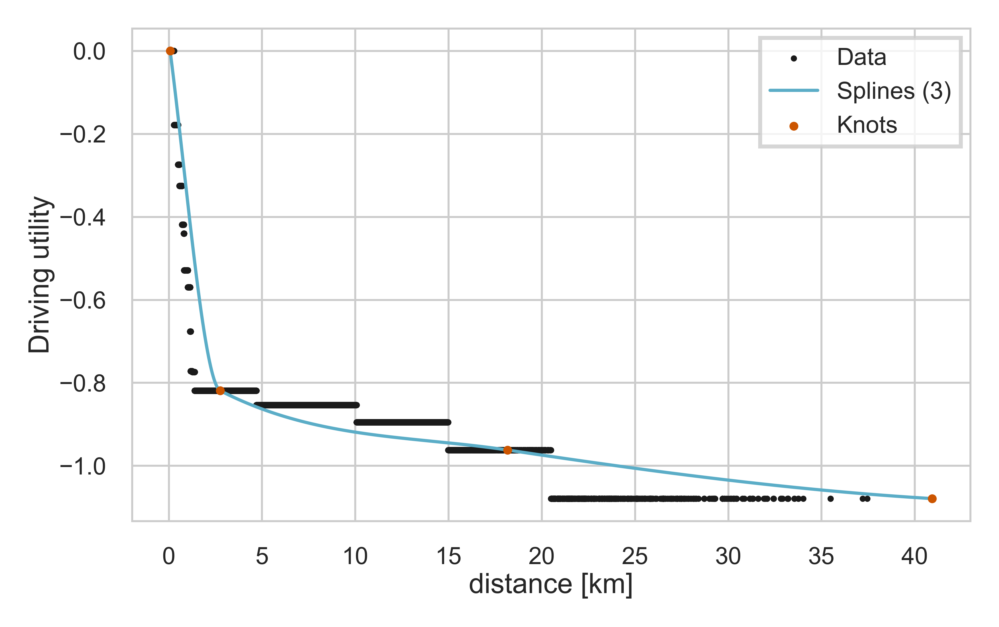

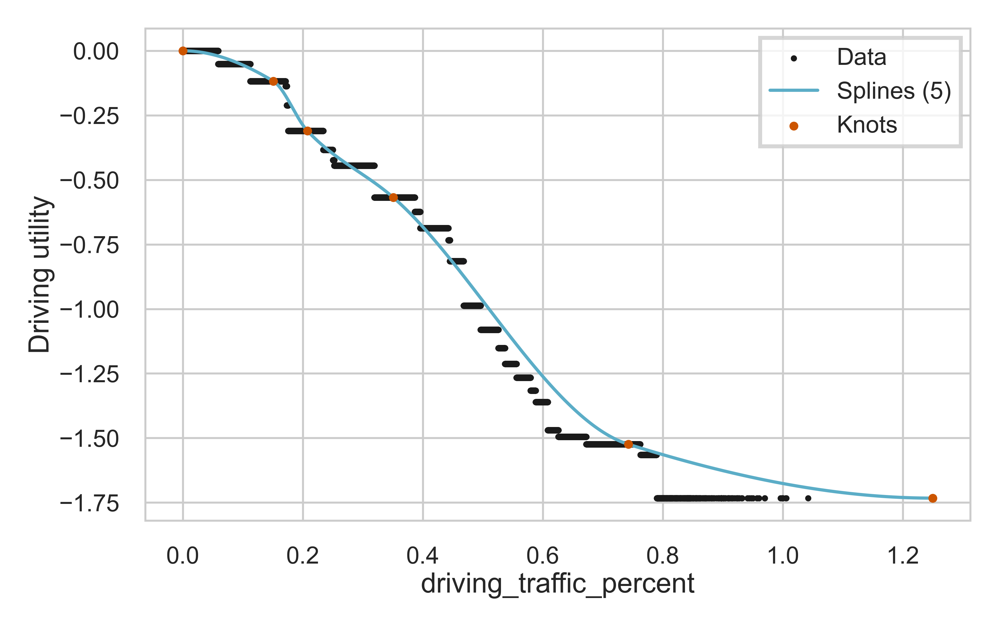

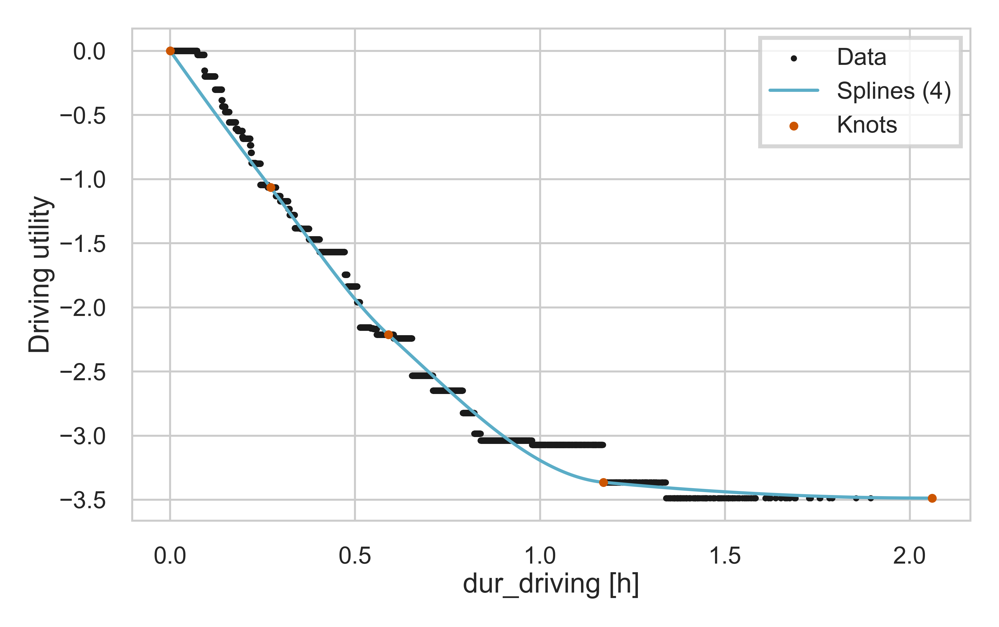

In [170]:
#Going to utility_plotting.py, def plot_spline, commenting out line 1368 and 1371 (# splines and # knots position)
from rumboost.utility_plotting import plot_spline, weights_to_plot_v2, plot_VoT, plot_pop_VoT

best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True)



## Plotting the value of time

Using the smoothed utility functions, we can compute the value of time for the population, and per attributes. The results vary slightly from the paper du to the differences in the optimisation process.

/Users/leovilardo/rumboost/examples/../rumboost/utility_plotting.py:1489: UserWarning: linewidths is ignored by contourf
  c_plot = axes.contourf(


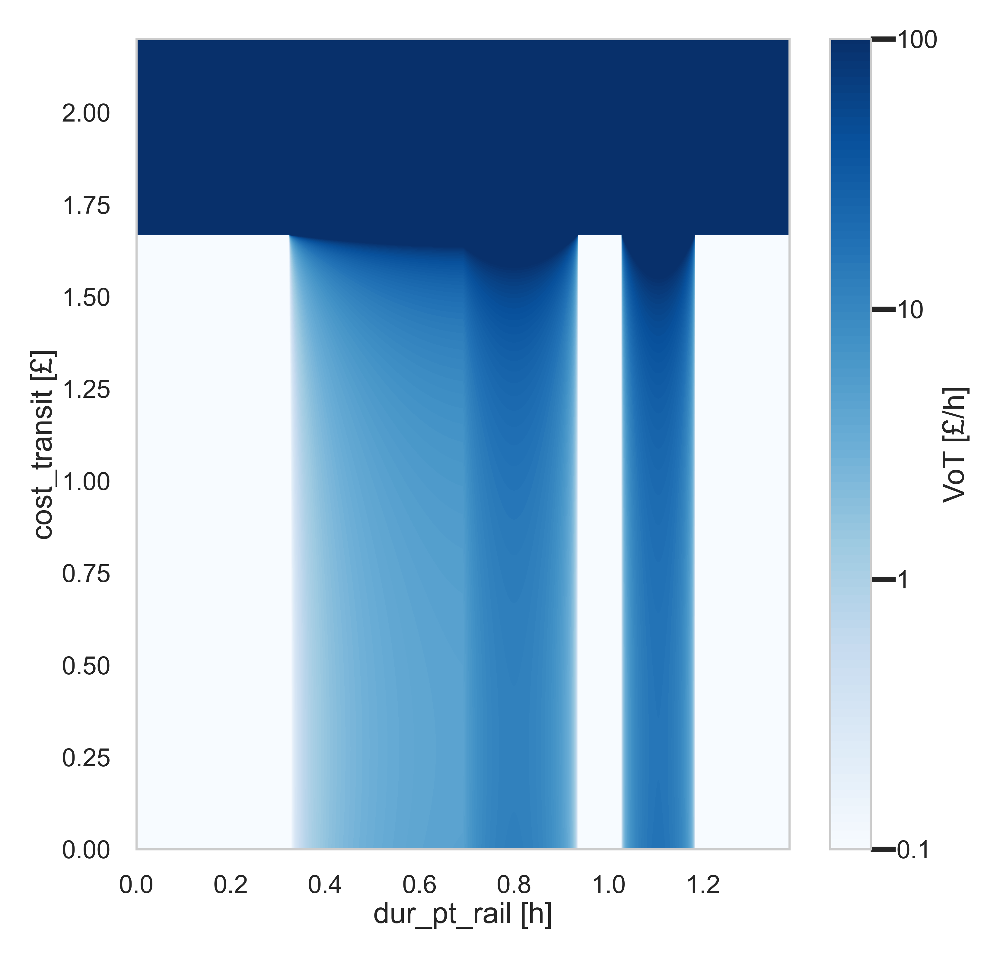

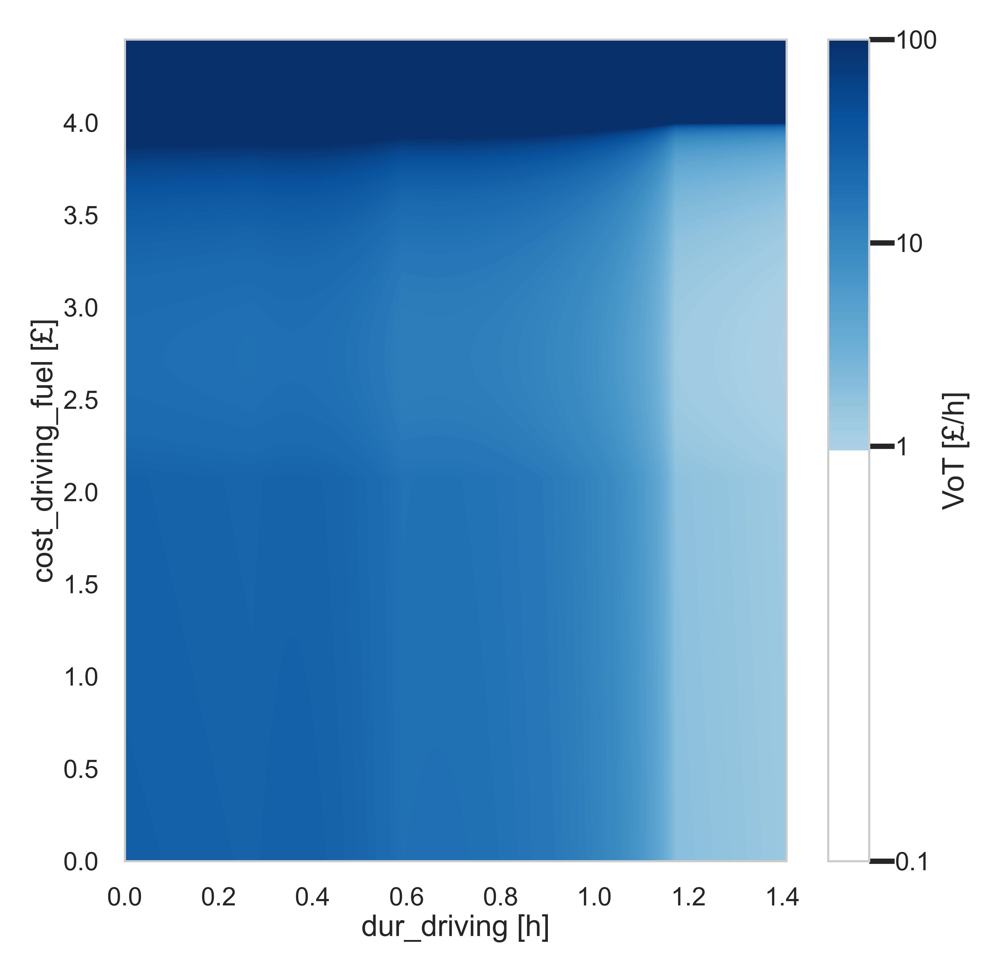

/Users/leovilardo/rumboost/examples/../rumboost/utility_plotting.py:1571: RuntimeWarning: divide by zero encountered in divide
  VoT_pop = d_f1(data_train[f1]) / d_f2(data_train[f2])
/Users/leovilardo/rumboost/examples/../rumboost/utility_plotting.py:1571: RuntimeWarning: invalid value encountered in divide
  VoT_pop = d_f1(data_train[f1]) / d_f2(data_train[f2])


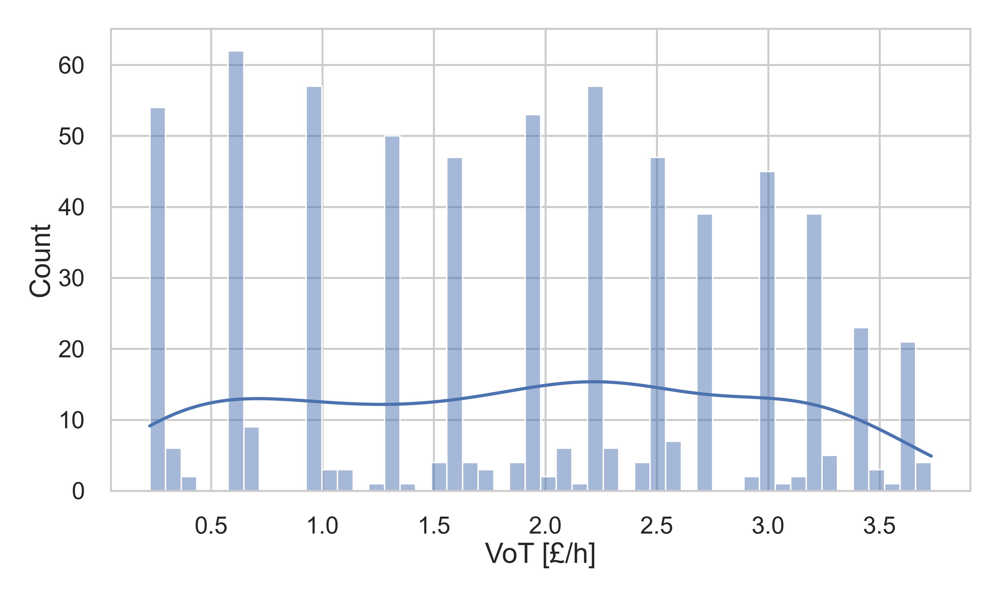

/Users/leovilardo/rumboost/examples/../rumboost/utility_plotting.py:1571: RuntimeWarning: divide by zero encountered in divide
  VoT_pop = d_f1(data_train[f1]) / d_f2(data_train[f2])


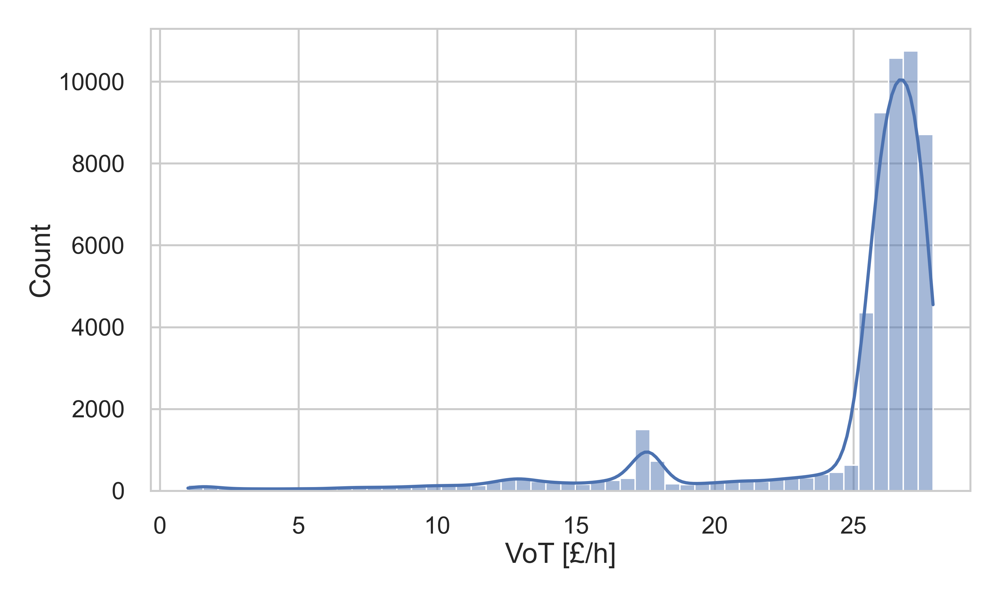

In [171]:
attribute_VoT =  {'2': ('dur_pt_rail', 'cost_transit'), '3':('dur_driving', 'cost_driving_fuel')}
draw_range = {'2':{'dur_pt_rail':(0,1.383), 'cost_transit':(0, 2.2)}, '3':{'dur_driving':(0, 1.409), 'cost_driving_fuel':(0, 4.45)}}

plot_VoT(LPMC_train, util_collection, attribute_VoT, utility_names={'0': 'Walking', '1': 'Cycling', '2':'Rail', '3':'Driving'}, draw_range=draw_range, save_figure=False)

plot_pop_VoT(LPMC_train, util_collection, attribute_VoT, save_figure=False)

## Other smoothing settings

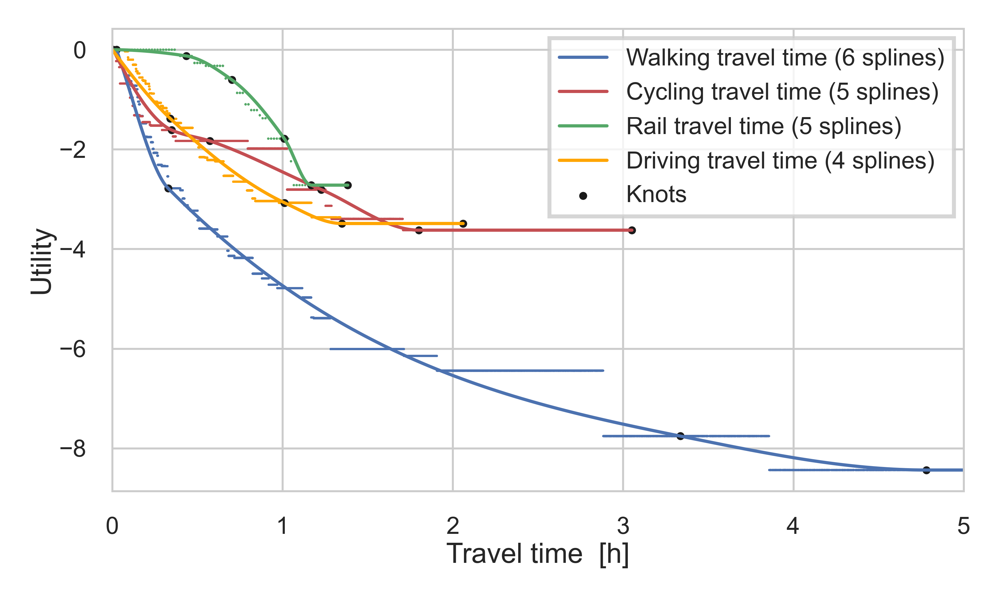

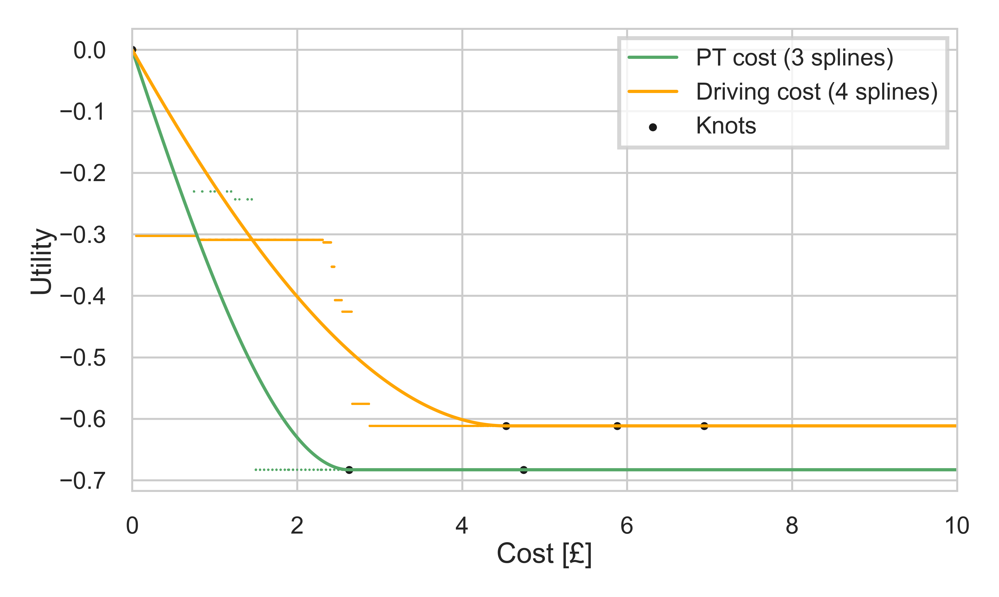

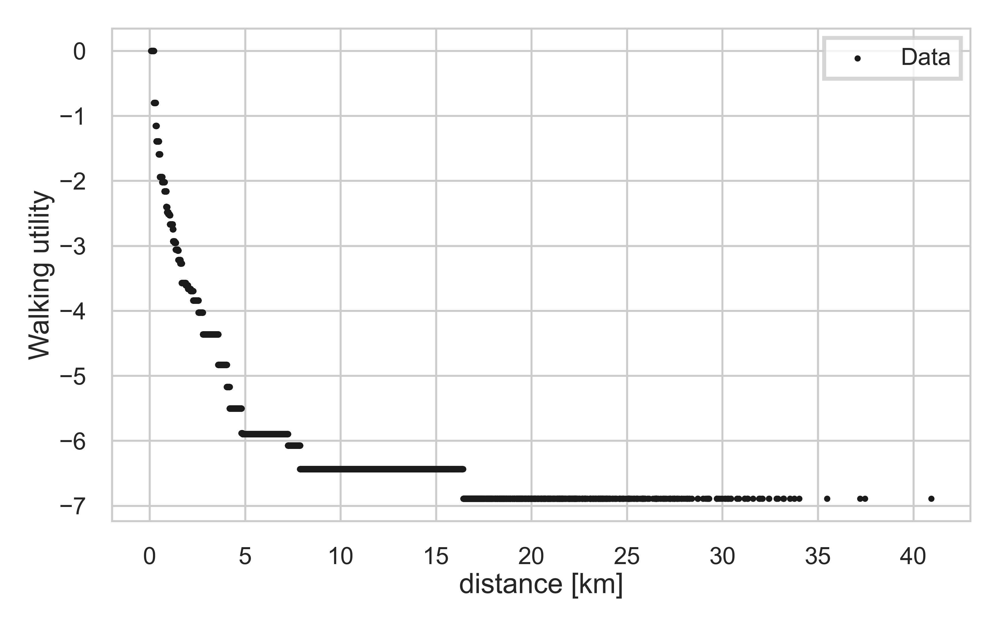

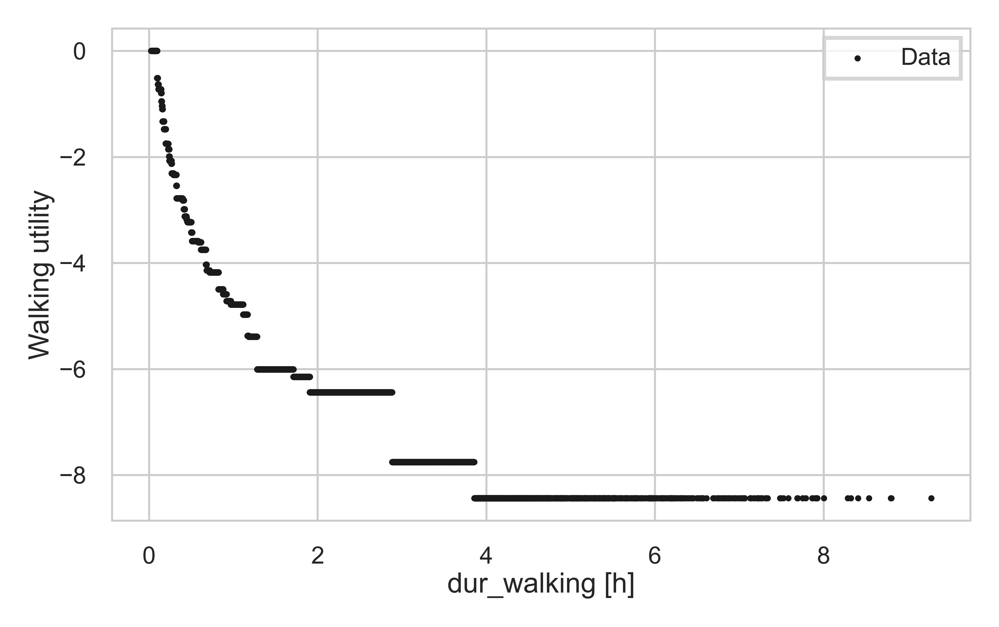

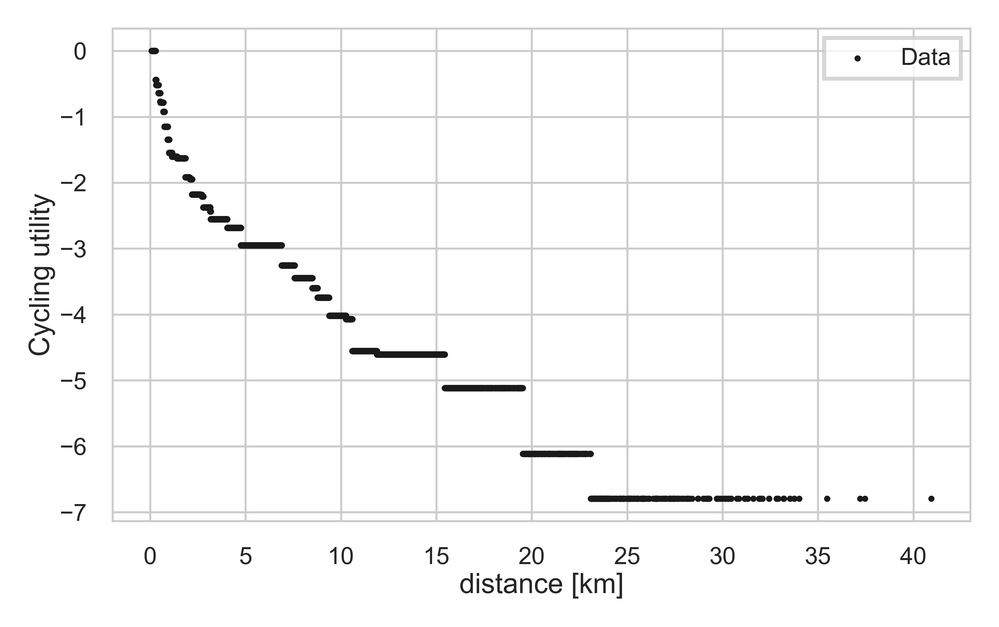

...

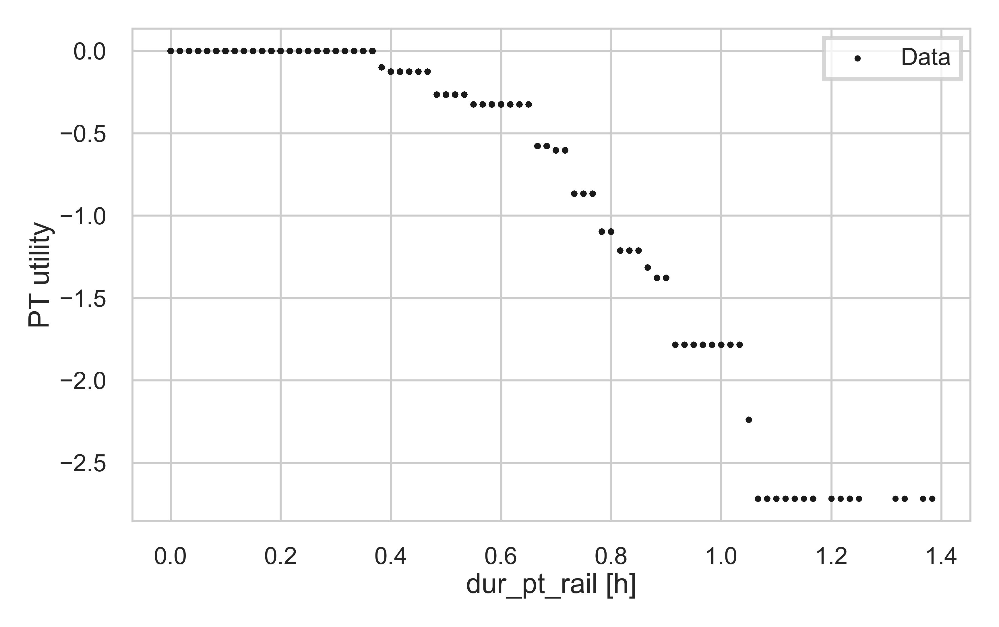

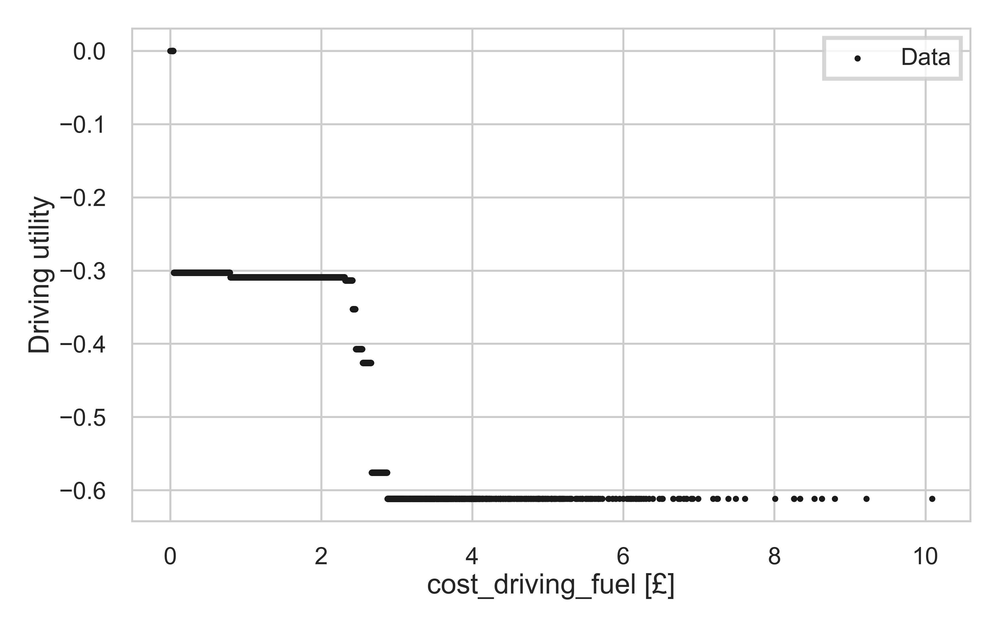

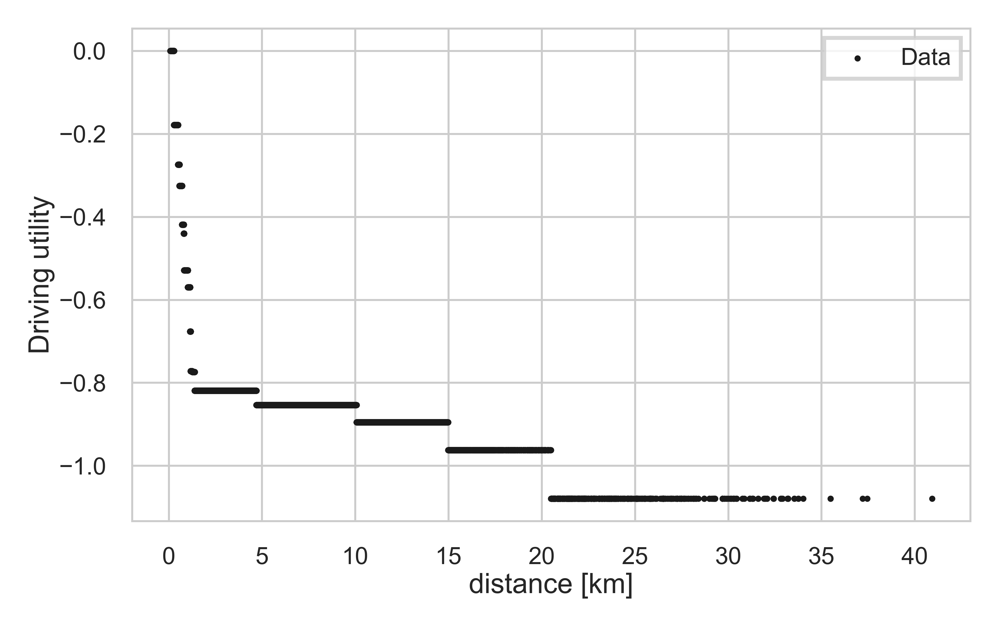

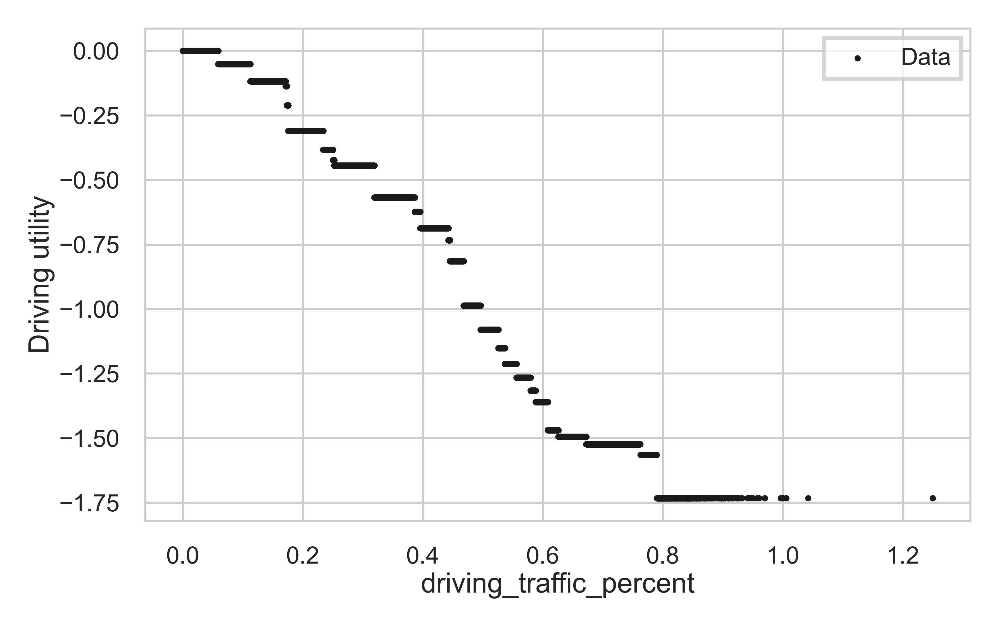

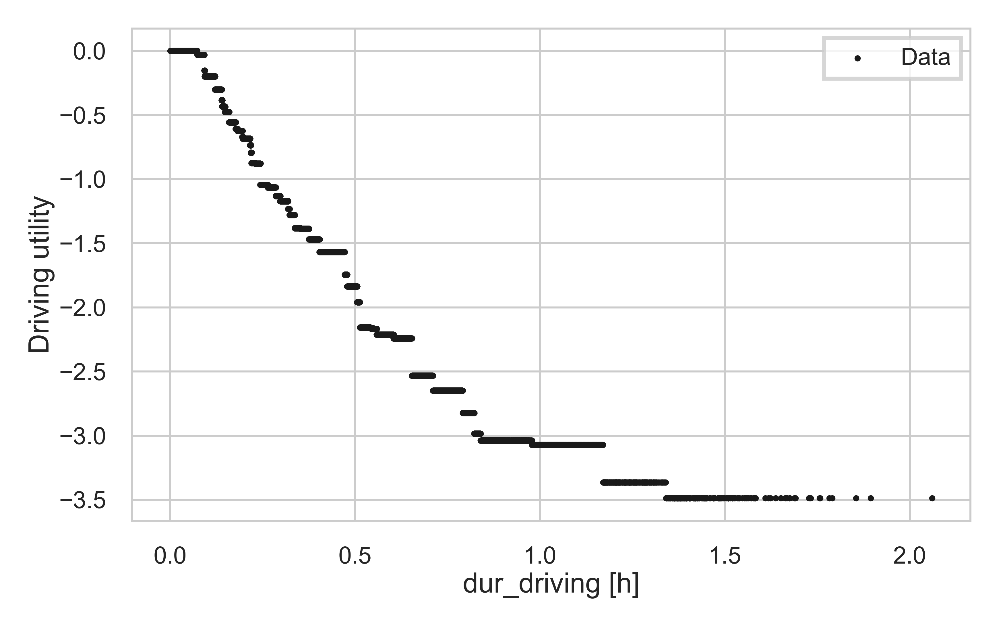

In [ ]:
#Going to utility_plotting.py, def plot_spline, commenting out line 1368 and 1371 (# splines and # knots position)


best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True)

## Optimisation with linear interpolation only

Fixed first and last knots

Cross-entropy loss (spline smoothing): 0.6726482617170773
Cross-entropy loss (piecewise linear interpolation with real y-values): 0.993424745453391

Utility 0 - distance
x_knots: [ 0.077       1.21660432  3.52725243  5.78320084 11.15520747 12.97575803
 18.21155525 40.941     ]
y_knots (real utility values): [ 3.2865874   0.54128838 -1.07421059 -2.60949345 -3.15056562 -3.15056562
 -3.60445961 -3.60445961]
x_values (for interpolation): [ 0.077       0.48976768  0.90253535  1.31530303  1.72807071  2.14083838
  2.55360606  2.96637374  3.37914141  3.79190909  4.20467677  4.61744444
  5.03021212  5.4429798   5.85574747  6.26851515  6.68128283  7.09405051
  7.50681818  7.91958586  8.33235354  8.74512121  9.15788889  9.57065657
  9.98342424 10.39619192 10.8089596  11.22172727 11.63449495 12.04726263
 12.4600303  12.87279798 13.28556566 13.69833333 14.11110101 14.52386869
 14.93663636 15.34940404 15.76217172 16.17493939 16.58770707 17.00047475
 17.41324242 17.8260101  18.23877778 18.65154545 19

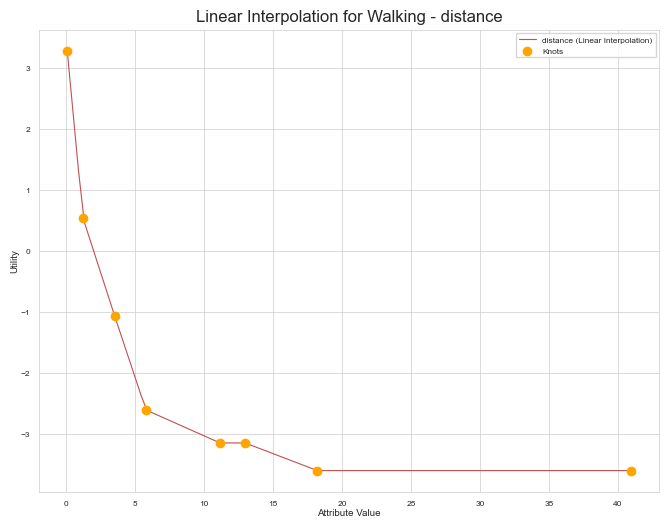


Utility 0 - dur_walking
x_knots: [0.02527778 0.70590404 1.05009719 1.38797642 1.87904795 2.76662604
 4.489355   9.27833333]
y_knots (real utility values): [ 2.9913433  -1.14712818 -1.79454623 -3.01792966 -3.15556538 -3.45115212
 -5.44619416 -5.44619416]
x_values (for interpolation): [0.02527778 0.11874299 0.21220819 0.3056734  0.39913861 0.49260382
 0.58606902 0.67953423 0.77299944 0.86646465 0.95992985 1.05339506
 1.14686027 1.24032548 1.33379068 1.42725589 1.5207211  1.61418631
 1.70765152 1.80111672 1.89458193 1.98804714 2.08151235 2.17497755
 2.26844276 2.36190797 2.45537318 2.54883838 2.64230359 2.7357688
 2.82923401 2.92269921 3.01616442 3.10962963 3.20309484 3.29656004
 3.39002525 3.48349046 3.57695567 3.67042088 3.76388608 3.85735129
 3.9508165  4.04428171 4.13774691 4.23121212 4.32467733 4.41814254
 4.51160774 4.60507295 4.69853816 4.79200337 4.88546857 4.97893378
 5.07239899 5.1658642  5.25932941 5.35279461 5.44625982 5.53972503
 5.63319024 5.72665544 5.82012065 5.91358586 6

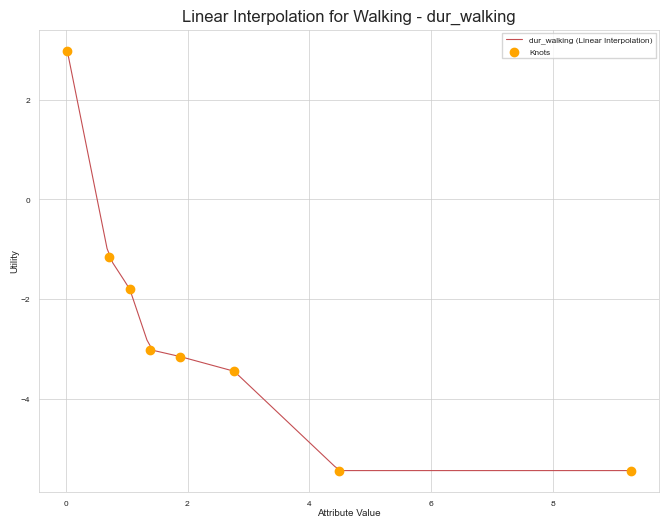


Utility 1 - distance
x_knots: [ 0.077       1.45675972  4.29747593  6.58382549  8.36095148 13.67790981
 22.41893269 40.941     ]
y_knots (real utility values): [ 2.07811431  0.45020645 -0.60688575 -0.87304563 -1.36791756 -2.52934314
 -4.03668245 -4.71512441]
x_values (for interpolation): [ 0.077       0.48976768  0.90253535  1.31530303  1.72807071  2.14083838
  2.55360606  2.96637374  3.37914141  3.79190909  4.20467677  4.61744444
  5.03021212  5.4429798   5.85574747  6.26851515  6.68128283  7.09405051
  7.50681818  7.91958586  8.33235354  8.74512121  9.15788889  9.57065657
  9.98342424 10.39619192 10.8089596  11.22172727 11.63449495 12.04726263
 12.4600303  12.87279798 13.28556566 13.69833333 14.11110101 14.52386869
 14.93663636 15.34940404 15.76217172 16.17493939 16.58770707 17.00047475
 17.41324242 17.8260101  18.23877778 18.65154545 19.06431313 19.47708081
 19.88984848 20.30261616 20.71538384 21.12815152 21.54091919 21.95368687
 22.36645455 22.77922222 23.1919899  23.60475758 24.0

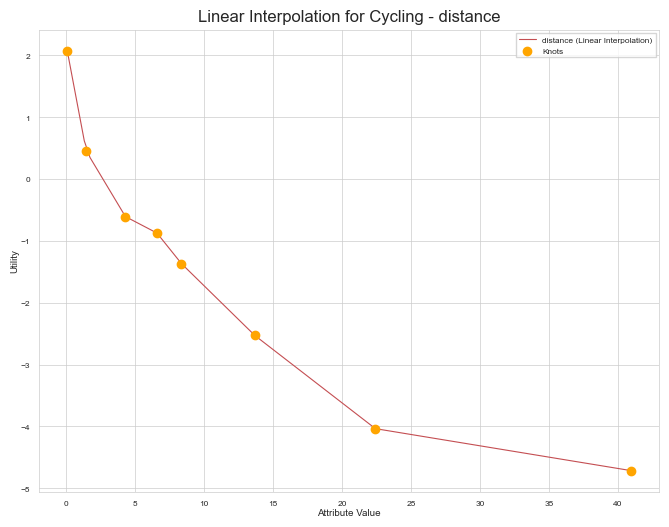


Utility 1 - dur_cycling
x_knots: [0.00611111 0.313919   0.69520414 1.21934286 1.595997   2.20280093
 3.05194444]
y_knots (real utility values): [ 1.42717988 -0.18456181 -0.40471652 -1.38043892 -1.96911864 -2.19515114
 -2.19515114]
x_values (for interpolation): [0.00611111 0.0368771  0.0676431  0.09840909 0.12917508 0.15994108
 0.19070707 0.22147306 0.25223906 0.28300505 0.31377104 0.34453704
 0.37530303 0.40606902 0.43683502 0.46760101 0.498367   0.529133
 0.55989899 0.59066498 0.62143098 0.65219697 0.68296296 0.71372896
 0.74449495 0.77526094 0.80602694 0.83679293 0.86755892 0.89832492
 0.92909091 0.9598569  0.9906229  1.02138889 1.05215488 1.08292088
 1.11368687 1.14445286 1.17521885 1.20598485 1.23675084 1.26751683
 1.29828283 1.32904882 1.35981481 1.39058081 1.4213468  1.45211279
 1.48287879 1.51364478 1.54441077 1.57517677 1.60594276 1.63670875
 1.66747475 1.69824074 1.72900673 1.75977273 1.79053872 1.82130471
 1.85207071 1.8828367  1.91360269 1.94436869 1.97513468 2.00590067
 2.

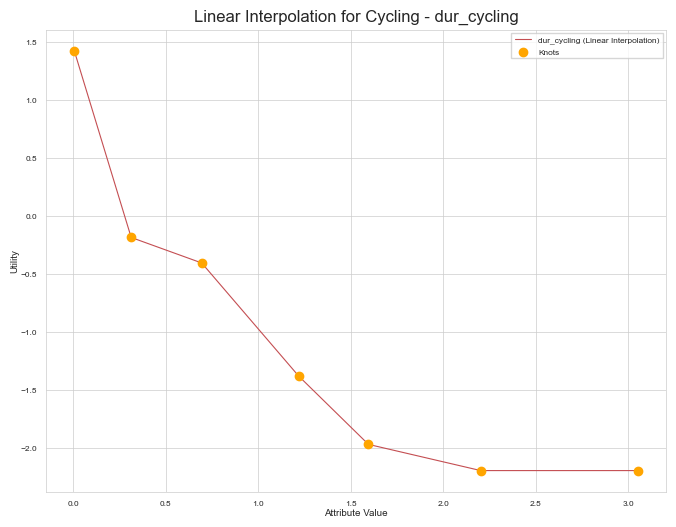


Utility 2 - cost_transit
x_knots: [ 0.          1.66796078  4.93807482 13.2       ]
y_knots (real utility values): [ 0.40193571 -0.28105401 -0.28105401 -0.28105401]
x_values (for interpolation): [ 0.          0.13333333  0.26666667  0.4         0.53333333  0.66666667
  0.8         0.93333333  1.06666667  1.2         1.33333333  1.46666667
  1.6         1.73333333  1.86666667  2.          2.13333333  2.26666667
  2.4         2.53333333  2.66666667  2.8         2.93333333  3.06666667
  3.2         3.33333333  3.46666667  3.6         3.73333333  3.86666667
  4.          4.13333333  4.26666667  4.4         4.53333333  4.66666667
  4.8         4.93333333  5.06666667  5.2         5.33333333  5.46666667
  5.6         5.73333333  5.86666667  6.          6.13333333  6.26666667
  6.4         6.53333333  6.66666667  6.8         6.93333333  7.06666667
  7.2         7.33333333  7.46666667  7.6         7.73333333  7.86666667
  8.          8.13333333  8.26666667  8.4         8.53333333  8.66666667
 

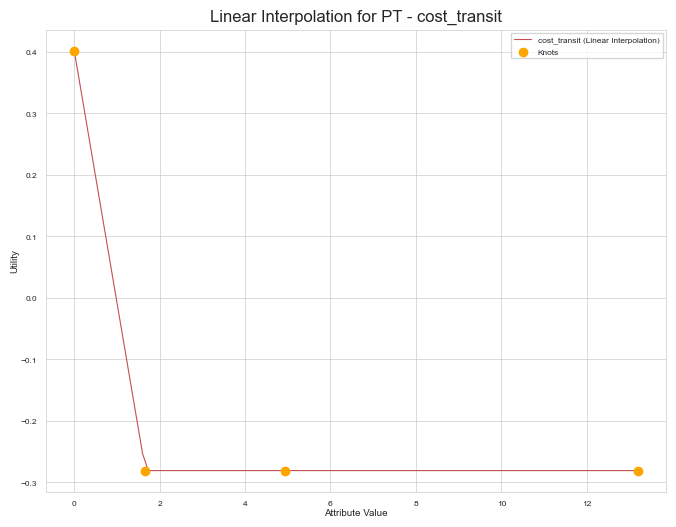


Utility 2 - dur_pt_access
x_knots: [0.         0.21250687 0.40637302 0.46538768 0.53812207 1.05861111]
y_knots (real utility values): [ 0.70552701 -0.33421955 -1.35566502 -1.76108854 -1.76108854 -1.76108854]
x_values (for interpolation): [0.         0.01069304 0.02138608 0.03207912 0.04277217 0.05346521
 0.06415825 0.07485129 0.08554433 0.09623737 0.10693042 0.11762346
 0.1283165  0.13900954 0.14970258 0.16039562 0.17108866 0.18178171
 0.19247475 0.20316779 0.21386083 0.22455387 0.23524691 0.24593996
 0.256633   0.26732604 0.27801908 0.28871212 0.29940516 0.3100982
 0.32079125 0.33148429 0.34217733 0.35287037 0.36356341 0.37425645
 0.38494949 0.39564254 0.40633558 0.41702862 0.42772166 0.4384147
 0.44910774 0.45980079 0.47049383 0.48118687 0.49187991 0.50257295
 0.51326599 0.52395903 0.53465208 0.54534512 0.55603816 0.5667312
 0.57742424 0.58811728 0.59881033 0.60950337 0.62019641 0.63088945
 0.64158249 0.65227553 0.66296857 0.67366162 0.68435466 0.6950477
 0.70574074 0.71643378 0.727

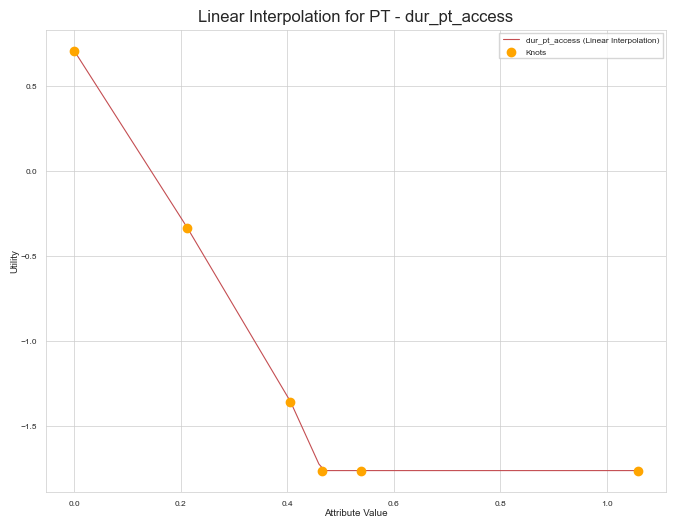


Utility 2 - dur_pt_bus
x_knots: [0.         0.59957417 1.09234879 2.14722222]
y_knots (real utility values): [ 0.65782953 -0.65815454 -1.51024332 -2.20792471]
x_values (for interpolation): [0.         0.02168911 0.04337823 0.06506734 0.08675645 0.10844557
 0.13013468 0.15182379 0.17351291 0.19520202 0.21689113 0.23858025
 0.26026936 0.28195847 0.30364759 0.3253367  0.34702581 0.36871493
 0.39040404 0.41209315 0.43378227 0.45547138 0.47716049 0.49884961
 0.52053872 0.54222783 0.56391695 0.58560606 0.60729517 0.62898429
 0.6506734  0.67236251 0.69405163 0.71574074 0.73742985 0.75911897
 0.78080808 0.80249719 0.82418631 0.84587542 0.86756453 0.88925365
 0.91094276 0.93263187 0.95432099 0.9760101  0.99769921 1.01938833
 1.04107744 1.06276655 1.08445567 1.10614478 1.12783389 1.14952301
 1.17121212 1.19290123 1.21459035 1.23627946 1.25796857 1.27965769
 1.3013468  1.32303591 1.34472503 1.36641414 1.38810325 1.40979237
 1.43148148 1.45317059 1.47485971 1.49654882 1.51823793 1.53992705
 1.561

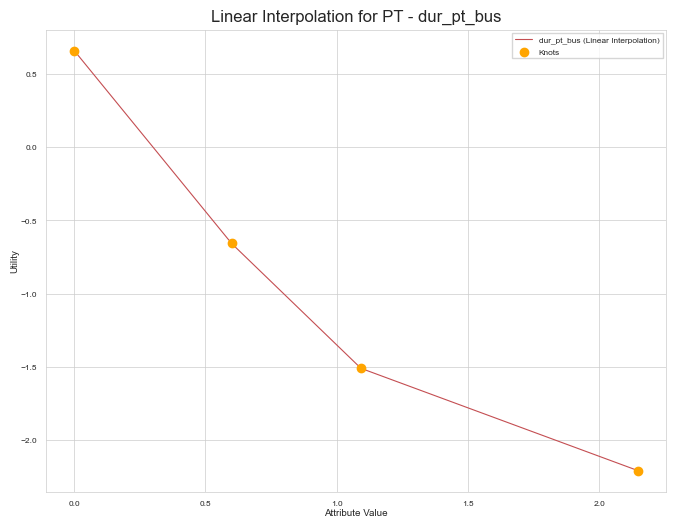


Utility 2 - dur_pt_int_waiting
x_knots: [0.         0.25984463 0.34258746 0.5497279  0.83722222]
y_knots (real utility values): [ 0.18717864 -1.21589558 -1.32482176 -1.32482176 -1.32482176]
x_values (for interpolation): [0.         0.00845679 0.01691358 0.02537037 0.03382716 0.04228395
 0.05074074 0.05919753 0.06765432 0.07611111 0.0845679  0.09302469
 0.10148148 0.10993827 0.11839506 0.12685185 0.13530864 0.14376543
 0.15222222 0.16067901 0.1691358  0.17759259 0.18604938 0.19450617
 0.20296296 0.21141975 0.21987654 0.22833333 0.23679012 0.24524691
 0.2537037  0.26216049 0.27061728 0.27907407 0.28753086 0.29598765
 0.30444444 0.31290123 0.32135802 0.32981481 0.3382716  0.34672839
 0.35518519 0.36364198 0.37209877 0.38055556 0.38901235 0.39746914
 0.40592593 0.41438272 0.42283951 0.4312963  0.43975309 0.44820988
 0.45666667 0.46512346 0.47358025 0.48203704 0.49049383 0.49895062
 0.50740741 0.5158642  0.52432099 0.53277778 0.54123457 0.54969136
 0.55814815 0.56660494 0.57506173 0.583518

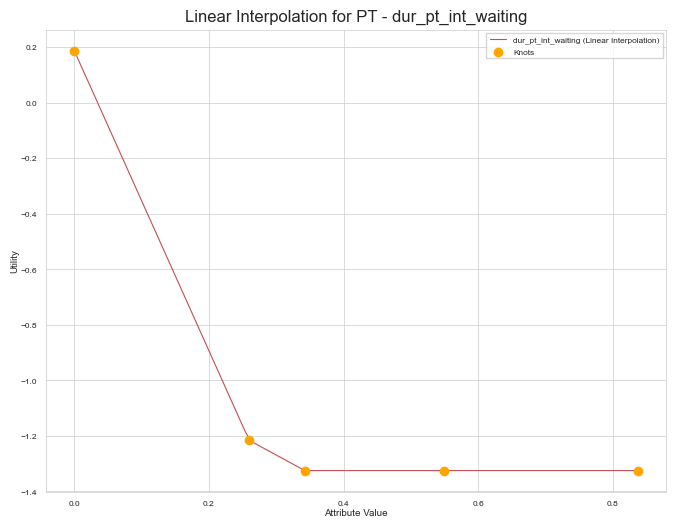


Utility 2 - dur_pt_int_walking
x_knots: [0.         0.07355419 0.09718455 0.17916667]
y_knots (real utility values): [ 0.00386518 -0.0764979  -0.12545467 -0.79966505]
x_values (for interpolation): [0.         0.00180976 0.00361953 0.00542929 0.00723906 0.00904882
 0.01085859 0.01266835 0.01447811 0.01628788 0.01809764 0.01990741
 0.02171717 0.02352694 0.0253367  0.02714646 0.02895623 0.03076599
 0.03257576 0.03438552 0.03619529 0.03800505 0.03981481 0.04162458
 0.04343434 0.04524411 0.04705387 0.04886364 0.0506734  0.05248317
 0.05429293 0.05610269 0.05791246 0.05972222 0.06153199 0.06334175
 0.06515152 0.06696128 0.06877104 0.07058081 0.07239057 0.07420034
 0.0760101  0.07781987 0.07962963 0.08143939 0.08324916 0.08505892
 0.08686869 0.08867845 0.09048822 0.09229798 0.09410774 0.09591751
 0.09772727 0.09953704 0.1013468  0.10315657 0.10496633 0.10677609
 0.10858586 0.11039562 0.11220539 0.11401515 0.11582492 0.11763468
 0.11944444 0.12125421 0.12306397 0.12487374 0.1266835  0.1284932

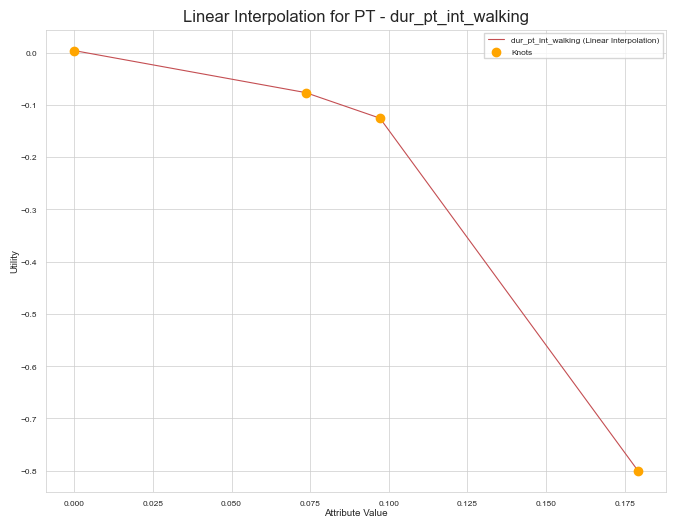


Utility 2 - dur_pt_rail
x_knots: [0.         0.08903905 0.32360324 0.69275065 0.93529743 1.02765561
 1.18345319 1.38333333]
y_knots (real utility values): [ 0.01472545  0.01472545  0.01472545 -0.58893961 -1.76973931 -1.76973931
 -2.70383489 -2.70383489]
x_values (for interpolation): [0.         0.01397306 0.02794613 0.04191919 0.05589226 0.06986532
 0.08383838 0.09781145 0.11178451 0.12575758 0.13973064 0.1537037
 0.16767677 0.18164983 0.1956229  0.20959596 0.22356902 0.23754209
 0.25151515 0.26548822 0.27946128 0.29343434 0.30740741 0.32138047
 0.33535354 0.3493266  0.36329966 0.37727273 0.39124579 0.40521886
 0.41919192 0.43316498 0.44713805 0.46111111 0.47508417 0.48905724
 0.5030303  0.51700337 0.53097643 0.54494949 0.55892256 0.57289562
 0.58686869 0.60084175 0.61481481 0.62878788 0.64276094 0.65673401
 0.67070707 0.68468013 0.6986532  0.71262626 0.72659933 0.74057239
 0.75454545 0.76851852 0.78249158 0.79646465 0.81043771 0.82441077
 0.83838384 0.8523569  0.86632997 0.88030303 0

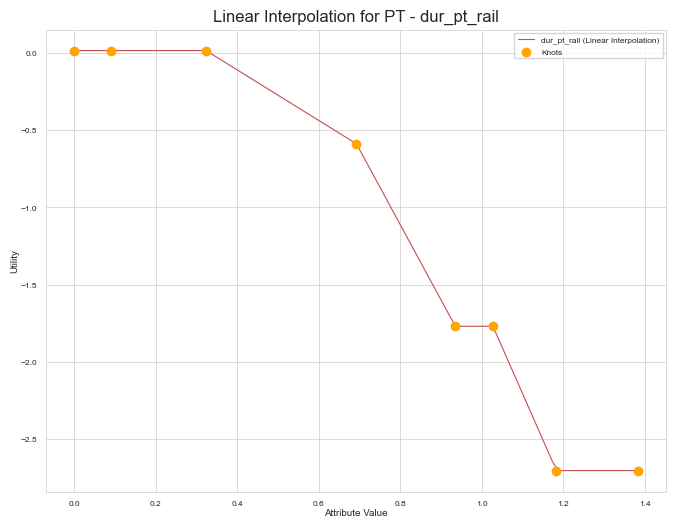


Utility 3 - cost_driving_fuel
x_knots: [ 0.          2.07539132  4.00271035 10.09      ]
y_knots (real utility values): [ 0.31590776  0.00671066 -0.29573517 -0.29573517]
x_values (for interpolation): [ 0.          0.10191919  0.20383838  0.30575758  0.40767677  0.50959596
  0.61151515  0.71343434  0.81535354  0.91727273  1.01919192  1.12111111
  1.2230303   1.32494949  1.42686869  1.52878788  1.63070707  1.73262626
  1.83454545  1.93646465  2.03838384  2.14030303  2.24222222  2.34414141
  2.44606061  2.5479798   2.64989899  2.75181818  2.85373737  2.95565657
  3.05757576  3.15949495  3.26141414  3.36333333  3.46525253  3.56717172
  3.66909091  3.7710101   3.87292929  3.97484848  4.07676768  4.17868687
  4.28060606  4.38252525  4.48444444  4.58636364  4.68828283  4.79020202
  4.89212121  4.9940404   5.0959596   5.19787879  5.29979798  5.40171717
  5.50363636  5.60555556  5.70747475  5.80939394  5.91131313  6.01323232
  6.11515152  6.21707071  6.3189899   6.42090909  6.52282828  6.62474

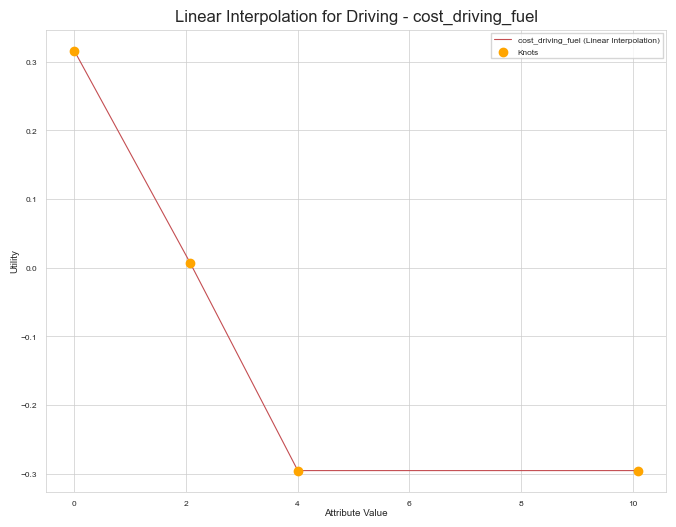


Utility 3 - distance
x_knots: [ 0.077       2.76134274 18.1653588  40.941     ]
y_knots (real utility values): [ 0.74205648 -0.07717142 -0.22021705 -0.33732286]
x_values (for interpolation): [ 0.077       0.48976768  0.90253535  1.31530303  1.72807071  2.14083838
  2.55360606  2.96637374  3.37914141  3.79190909  4.20467677  4.61744444
  5.03021212  5.4429798   5.85574747  6.26851515  6.68128283  7.09405051
  7.50681818  7.91958586  8.33235354  8.74512121  9.15788889  9.57065657
  9.98342424 10.39619192 10.8089596  11.22172727 11.63449495 12.04726263
 12.4600303  12.87279798 13.28556566 13.69833333 14.11110101 14.52386869
 14.93663636 15.34940404 15.76217172 16.17493939 16.58770707 17.00047475
 17.41324242 17.8260101  18.23877778 18.65154545 19.06431313 19.47708081
 19.88984848 20.30261616 20.71538384 21.12815152 21.54091919 21.95368687
 22.36645455 22.77922222 23.1919899  23.60475758 24.01752525 24.43029293
 24.84306061 25.25582828 25.66859596 26.08136364 26.49413131 26.90689899
 27.3

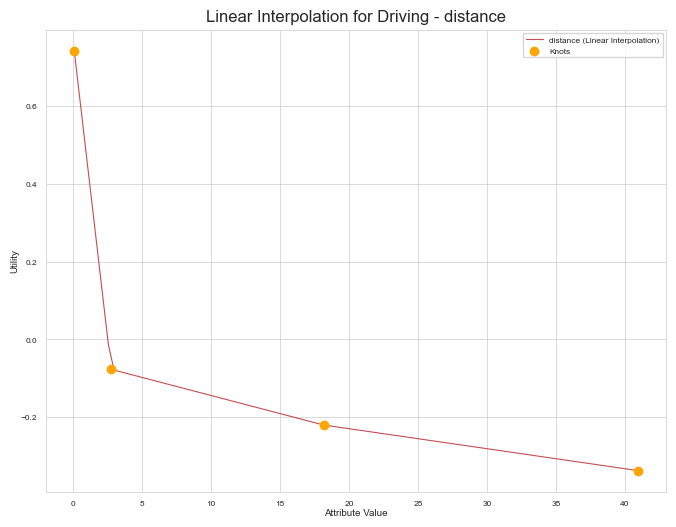


Utility 3 - driving_traffic_percent
x_knots: [0.         0.15098439 0.20778615 0.3508069  0.74265728 1.25      ]
y_knots (real utility values): [ 0.72059089  0.60275768  0.41001841  0.15221297 -0.80389022 -1.01246851]
x_values (for interpolation): [0.         0.01262626 0.02525253 0.03787879 0.05050505 0.06313131
 0.07575758 0.08838384 0.1010101  0.11363636 0.12626263 0.13888889
 0.15151515 0.16414141 0.17676768 0.18939394 0.2020202  0.21464646
 0.22727273 0.23989899 0.25252525 0.26515152 0.27777778 0.29040404
 0.3030303  0.31565657 0.32828283 0.34090909 0.35353535 0.36616162
 0.37878788 0.39141414 0.4040404  0.41666667 0.42929293 0.44191919
 0.45454545 0.46717172 0.47979798 0.49242424 0.50505051 0.51767677
 0.53030303 0.54292929 0.55555556 0.56818182 0.58080808 0.59343434
 0.60606061 0.61868687 0.63131313 0.64393939 0.65656566 0.66919192
 0.68181818 0.69444444 0.70707071 0.71969697 0.73232323 0.74494949
 0.75757576 0.77020202 0.78282828 0.79545455 0.80808081 0.82070707
 0.83333333 0.

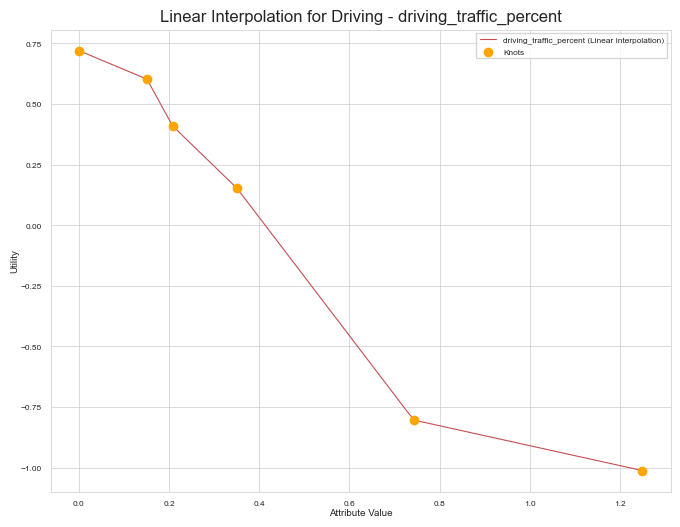


Utility 3 - dur_driving
x_knots: [2.77778000e-04 2.71919907e-01 5.90432601e-01 1.17183626e+00
 2.06083333e+00]
y_knots (real utility values): [ 0.85481937 -0.21119541 -1.35884531 -2.51023179 -2.6338187 ]
x_values (for interpolation): [2.77778000e-04 2.10914705e-02 4.19051629e-02 6.27188554e-02
 8.35325479e-02 1.04346240e-01 1.25159933e-01 1.45973625e-01
 1.66787318e-01 1.87601010e-01 2.08414703e-01 2.29228395e-01
 2.50042088e-01 2.70855780e-01 2.91669473e-01 3.12483165e-01
 3.33296858e-01 3.54110550e-01 3.74924243e-01 3.95737935e-01
 4.16551627e-01 4.37365320e-01 4.58179012e-01 4.78992705e-01
 4.99806397e-01 5.20620090e-01 5.41433782e-01 5.62247475e-01
 5.83061167e-01 6.03874860e-01 6.24688552e-01 6.45502245e-01
 6.66315937e-01 6.87129630e-01 7.07943322e-01 7.28757015e-01
 7.49570707e-01 7.70384400e-01 7.91198092e-01 8.12011785e-01
 8.32825477e-01 8.53639169e-01 8.74452862e-01 8.95266554e-01
 9.16080247e-01 9.36893939e-01 9.57707632e-01 9.78521324e-01
 9.99335017e-01 1.02014871e+00 1.

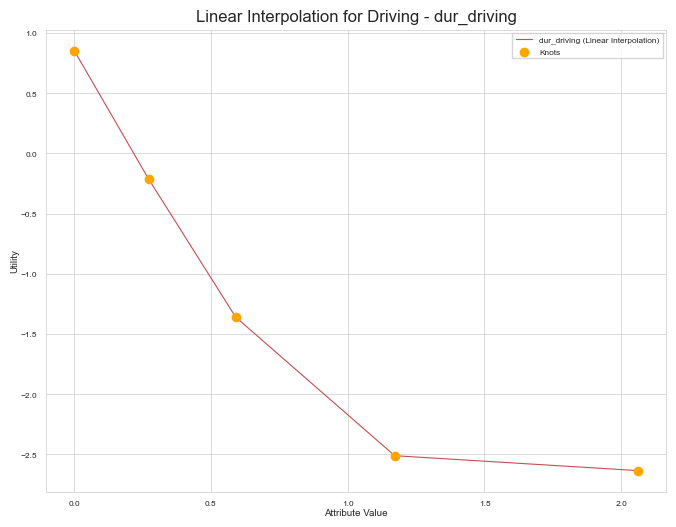

In [172]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from rumboost.metrics import cross_entropy  # Ensure cross-entropy consistency

import numpy as np
import matplotlib.pyplot as plt
from rumboost.metrics import cross_entropy  # Ensure consistency with Example 7

# Use updated utility collection to get real y-values at knots
def get_real_y_knots(util_collection, x_knots_dict):
    y_knots = {}
    for utility_id, attributes in x_knots_dict.items():
        y_knots[utility_id] = {}
        for attribute, x_knots in attributes.items():
            # Retrieve the function from util_collection and evaluate at x_knots
            if attribute in util_collection[utility_id]:
                y_knots[utility_id][attribute] = util_collection[utility_id][attribute](x_knots)
            else:
                print(f"Warning: No utility function for '{attribute}' in utility '{utility_id}'")
    return y_knots

# Use real y-values for linear interpolation
y_knots_real = get_real_y_knots(util_collection, x_knots_dict)

# Define the adjusted linear interpolation with real y-values
def piecewise_linear_with_real_y(x_knots_dict, y_knots_real):
    interpolated_util_collection = {}
    for utility_id, attributes in y_knots_real.items():
        interpolated_util_collection[utility_id] = {}
        for attribute, y_data in attributes.items():
            x_data = np.array(x_knots_dict[utility_id][attribute])
            interpolated_util_collection[utility_id][attribute] = lambda x, x_data=x_data, y_data=y_data: np.interp(x, x_data, y_data)
    return interpolated_util_collection

# Generate linear interpolation collection using real y-values
interpolated_util_collection_real = piecewise_linear_with_real_y(x_knots_dict, y_knots_real)

# Calculate predictions and cross-entropy loss for comparison
y_pred_spline = smooth_predict(LPMC_test, util_collection)
CE_final_spline = cross_entropy(y_pred_spline, LPMC_test['choice'])

y_pred_linear_real = smooth_predict(LPMC_test, interpolated_util_collection_real)
CE_final_linear_real = cross_entropy(y_pred_linear_real, LPMC_test['choice'])

print(f"Cross-entropy loss (spline smoothing): {CE_final_spline}")
print(f"Cross-entropy loss (piecewise linear interpolation with real y-values): {CE_final_linear_real}")

# Plot the linear interpolation functions with real y-values
def plot_linear_interpolation_with_real_y(data, linear_collection, utility_names, x_knots_dict, y_knots_real):
    for utility_id, name in utility_names.items():
        if utility_id not in x_knots_dict:
            continue
        for attribute, x_knots in x_knots_dict[utility_id].items():
            if attribute not in linear_collection[utility_id]:
                print(f"Skipping missing attribute: {attribute} in utility {utility_id}")
                continue
            
            y_knots = y_knots_real[utility_id][attribute]
            x_values = np.linspace(min(x_knots), max(x_knots), 100)
            y_values = linear_collection[utility_id][attribute](x_values)
            
            # Print x and y values for troubleshooting
            print(f"\nUtility {utility_id} - {attribute}")
            print("x_knots:", x_knots)
            print("y_knots (real utility values):", y_knots)
            print("x_values (for interpolation):", x_values)
            print("y_values (interpolated):", y_values)
            
            # Plotting the linear interpolation with real utility values
            plt.figure(figsize=(8, 6))
            plt.plot(x_values, y_values, label=f'{attribute} (Linear Interpolation)', color='r')
            plt.scatter(x_knots, y_knots, color='orange', label='Knots', zorder=5)
            plt.title(f'Linear Interpolation for {name} - {attribute}')
            plt.xlabel('Attribute Value')
            plt.ylabel('Utility')
            plt.legend()
            plt.show()

# Define utility names for labels
utility_names = {'0': 'Walking', '1': 'Cycling', '2': 'PT', '3': 'Driving'}

# Call the plotting function with real utility y-values
plot_linear_interpolation_with_real_y(LPMC_train, interpolated_util_collection_real, utility_names, x_knots_dict, y_knots_real)


Cross-entropy loss (spline smoothing): 0.6726482617170773
Cross-entropy loss (piecewise linear interpolation with normalised y-values): 1.2813351280516607

Utility 0 - distance
x_knots: [ 0.077       1.21660432  3.52725243  5.78320084 11.15520747 12.97575803
 18.21155525 40.941     ]
y_knots (normalized): [ 0.         -2.74529902 -4.360798   -5.89608085 -6.43715302 -6.43715302
 -6.89104701 -6.89104701]


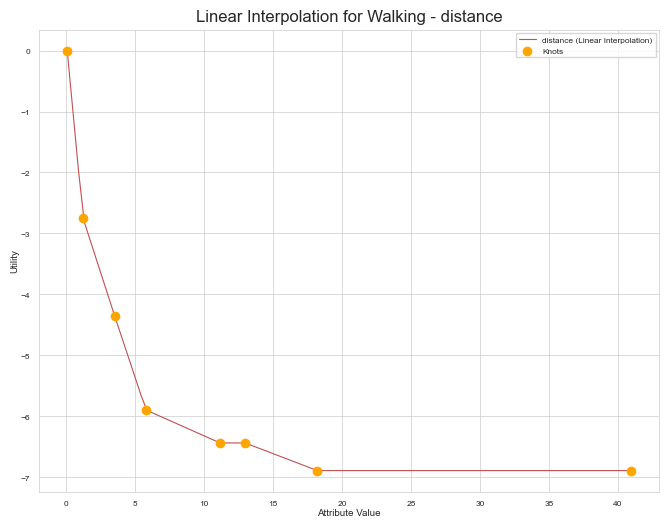


Utility 0 - dur_walking
x_knots: [0.02527778 0.70590404 1.05009719 1.38797642 1.87904795 2.76662604
 4.489355   9.27833333]
y_knots (normalized): [ 0.         -4.13847148 -4.78588952 -6.00927296 -6.14690868 -6.44249542
 -8.43753746 -8.43753746]


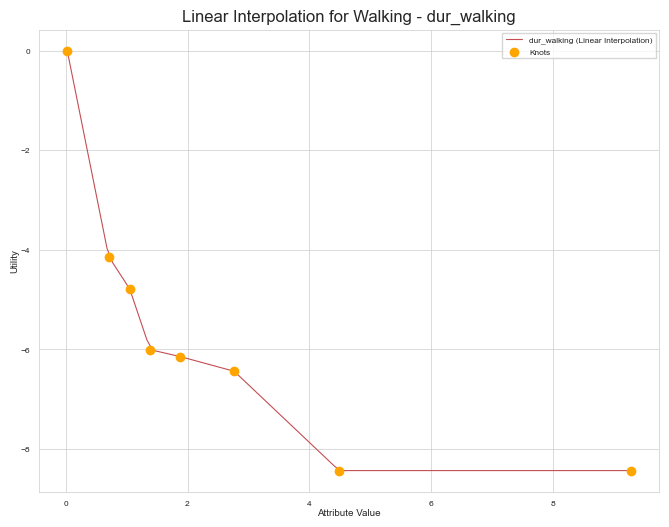


Utility 1 - distance
x_knots: [ 0.077       1.45675972  4.29747593  6.58382549  8.36095148 13.67790981
 22.41893269 40.941     ]
y_knots (normalized): [ 0.         -1.62790786 -2.68500006 -2.95115994 -3.44603187 -4.60745745
 -6.11479676 -6.79323871]


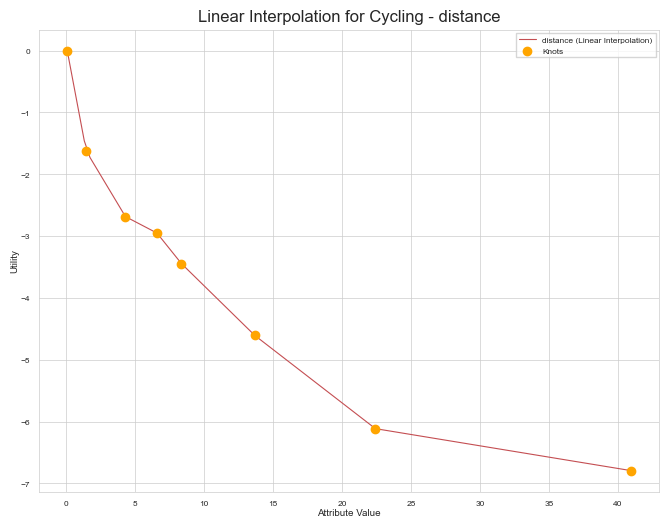


Utility 1 - dur_cycling
x_knots: [0.00611111 0.313919   0.69520414 1.21934286 1.595997   2.20280093
 3.05194444]
y_knots (normalized): [ 0.         -1.61174169 -1.83189639 -2.8076188  -3.39629851 -3.62233102
 -3.62233102]


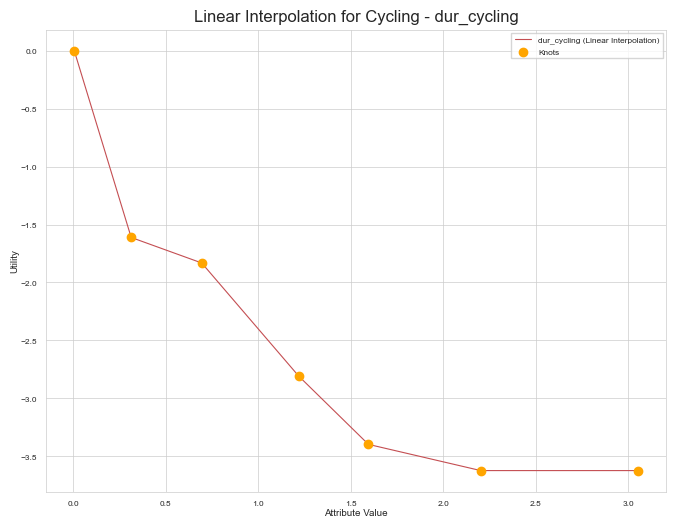


Utility 2 - cost_transit
x_knots: [ 0.          1.66796078  4.93807482 13.2       ]
y_knots (normalized): [ 0.         -0.68298972 -0.68298972 -0.68298972]


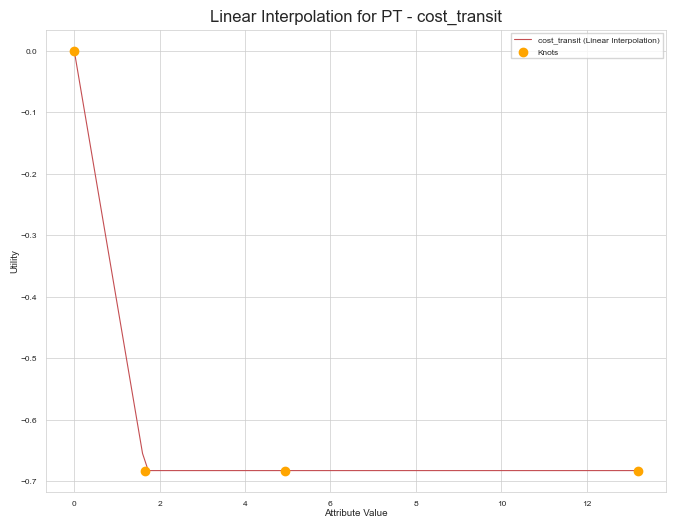


Utility 2 - dur_pt_access
x_knots: [0.         0.21250687 0.40637302 0.46538768 0.53812207 1.05861111]
y_knots (normalized): [ 0.         -1.03974656 -2.06119203 -2.46661555 -2.46661555 -2.46661555]


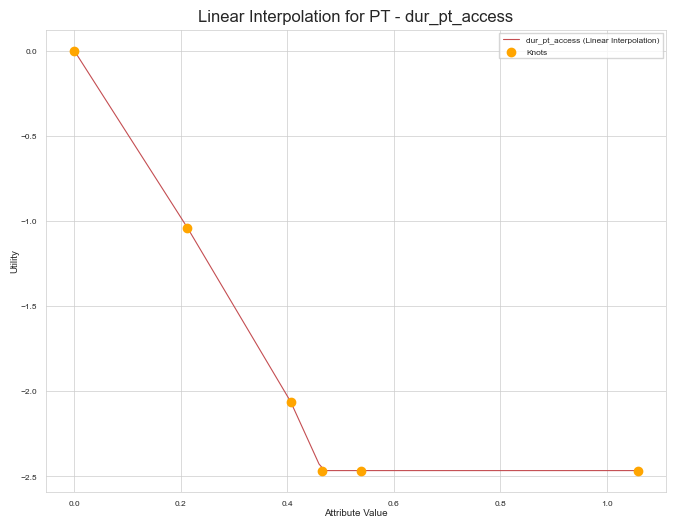


Utility 2 - dur_pt_bus
x_knots: [0.         0.59957417 1.09234879 2.14722222]
y_knots (normalized): [ 0.         -1.31598407 -2.16807286 -2.86575424]


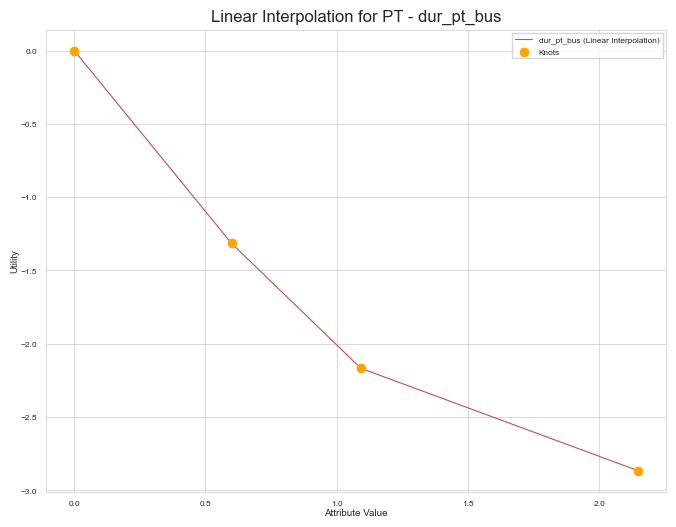


Utility 2 - dur_pt_int_waiting
x_knots: [0.         0.25984463 0.34258746 0.5497279  0.83722222]
y_knots (normalized): [ 0.         -1.40307422 -1.5120004  -1.5120004  -1.5120004 ]


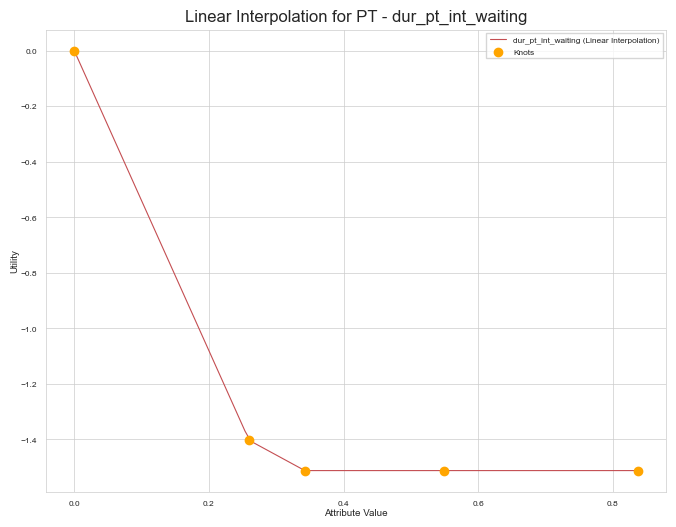


Utility 2 - dur_pt_int_walking
x_knots: [0.         0.07355419 0.09718455 0.17916667]
y_knots (normalized): [ 0.         -0.08036308 -0.12931985 -0.80353023]


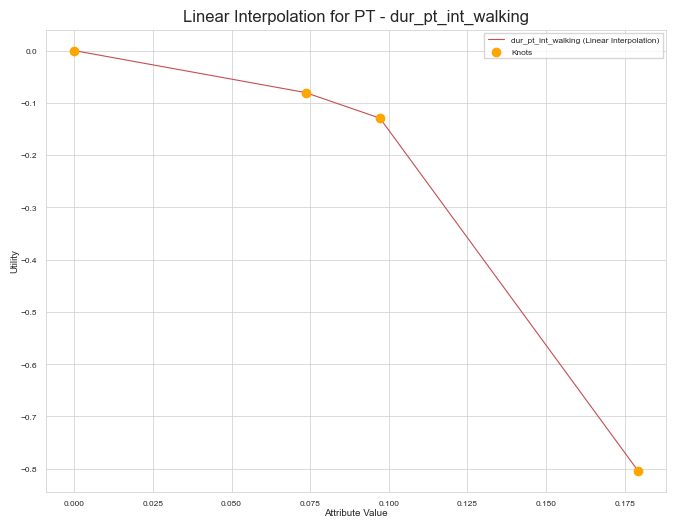


Utility 2 - dur_pt_rail
x_knots: [0.         0.08903905 0.32360324 0.69275065 0.93529743 1.02765561
 1.18345319 1.38333333]
y_knots (normalized): [ 0.          0.          0.         -0.60366506 -1.78446475 -1.78446475
 -2.71856034 -2.71856034]


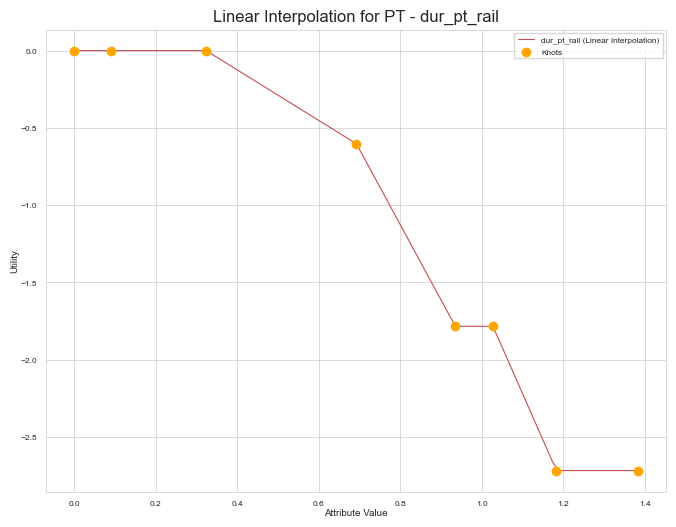


Utility 3 - cost_driving_fuel
x_knots: [ 0.          2.07539132  4.00271035 10.09      ]
y_knots (normalized): [ 0.         -0.3091971  -0.61164293 -0.61164293]


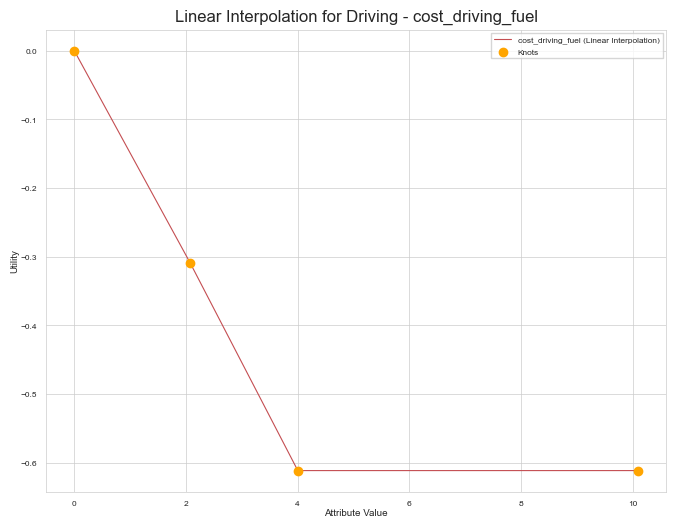


Utility 3 - distance
x_knots: [ 0.077       2.76134274 18.1653588  40.941     ]
y_knots (normalized): [ 0.         -0.8192279  -0.96227353 -1.07937934]


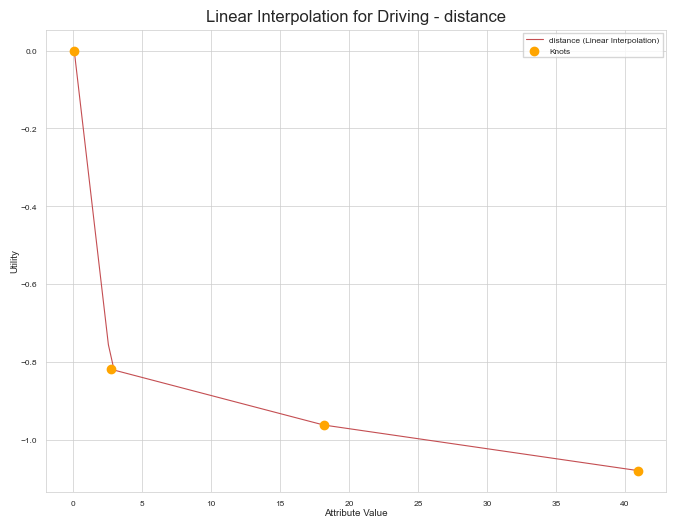


Utility 3 - driving_traffic_percent
x_knots: [0.         0.15098439 0.20778615 0.3508069  0.74265728 1.25      ]
y_knots (normalized): [ 0.         -0.11783321 -0.31057248 -0.56837792 -1.52448111 -1.7330594 ]


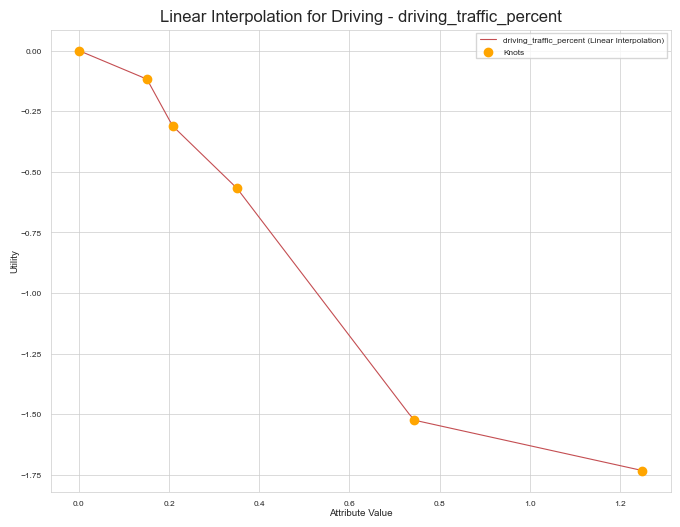


Utility 3 - dur_driving
x_knots: [2.77778000e-04 2.71919907e-01 5.90432601e-01 1.17183626e+00
 2.06083333e+00]
y_knots (normalized): [ 0.         -1.06601478 -2.21366467 -3.36505116 -3.48863806]


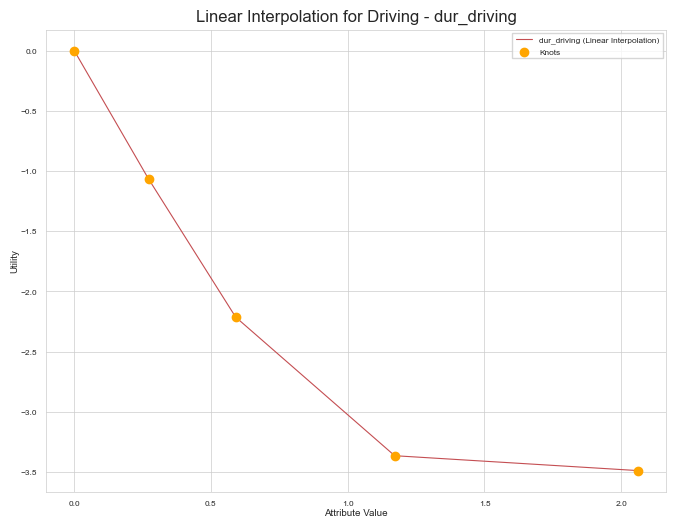

In [173]:
import numpy as np
import matplotlib.pyplot as plt
from rumboost.metrics import cross_entropy  # Ensures consistent cross-entropy calculation

# Define adjusted linear interpolation with real y-values and zero normalization
def piecewise_linear_with_real_y(x_knots_dict, y_knots_real):
    interpolated_util_collection = {}
    for utility_id, attributes in y_knots_real.items():
        interpolated_util_collection[utility_id] = {}
        for attribute, y_data in attributes.items():
            x_data = np.array(x_knots_dict[utility_id][attribute])
            y_data_normalized = y_data - y_data[0]  # Adjust y_data to start from zero
            interpolated_util_collection[utility_id][attribute] = lambda x, x_data=x_data, y_data=y_data_normalized: np.interp(x, x_data, y_data)
    return interpolated_util_collection

# Retrieve y-values at knots with zero normalization
def get_real_y_knots(util_collection, x_knots_dict):
    y_knots = {}
    for utility_id, attributes in x_knots_dict.items():
        y_knots[utility_id] = {}
        for attribute, x_knots in attributes.items():
            if attribute in util_collection[utility_id]:
                y_knots[utility_id][attribute] = util_collection[utility_id][attribute](x_knots)
            else:
                print(f"Warning: No utility function for '{attribute}' in utility '{utility_id}'")
    return y_knots

# Generate real y-values for each knot using the trained model's utility functions
y_knots_real = get_real_y_knots(util_collection, x_knots_dict)

# Apply linear interpolation with normalized y-values
interpolated_util_collection_real = piecewise_linear_with_real_y(x_knots_dict, y_knots_real)

# Cross-entropy calculations for both spline and linear interpolation
y_pred_spline = smooth_predict(LPMC_test, util_collection)
CE_final_spline = cross_entropy(y_pred_spline, LPMC_test['choice'])

y_pred_linear_real = smooth_predict(LPMC_test, interpolated_util_collection_real)
CE_final_linear_real = cross_entropy(y_pred_linear_real, LPMC_test['choice'])

print(f"Cross-entropy loss (spline smoothing): {CE_final_spline}")
print(f"Cross-entropy loss (piecewise linear interpolation with normalised y-values): {CE_final_linear_real}")

# Plotting function with hidden x and y values (except knots)
def plot_linear_interpolation_with_real_y(data, linear_collection, utility_names, x_knots_dict, y_knots_real, show_debug=False):
    """
    Plot linearly interpolated utility functions for each attribute with real y-values.
    """
    for utility_id, name in utility_names.items():
        if utility_id not in x_knots_dict:
            continue
        for attribute, x_knots in x_knots_dict[utility_id].items():
            if attribute not in linear_collection[utility_id]:
                print(f"Skipping missing attribute: {attribute} in utility {utility_id}")
                continue
            
            y_knots = y_knots_real[utility_id][attribute] - y_knots_real[utility_id][attribute][0]  # Normalize y_knots
            x_values = np.linspace(min(x_knots), max(x_knots), 100)
            y_values = linear_collection[utility_id][attribute](x_values)
            
            # Only print x and y knots, hide full x_values and y_values by default
            print(f"\nUtility {utility_id} - {attribute}")
            print("x_knots:", x_knots)
            print("y_knots (normalized):", y_knots)
            
            if show_debug:
                print("x_values (for interpolation):", x_values)
                print("y_values (interpolated):", y_values)
            
            # Plotting the linear interpolation with real utility values
            plt.figure(figsize=(8, 6))
            plt.plot(x_values, y_values, label=f'{attribute} (Linear Interpolation)', color='r')
            plt.scatter(x_knots, y_knots, color='orange', label='Knots', zorder=5)
            plt.title(f'Linear Interpolation for {name} - {attribute}')
            plt.xlabel('Attribute Value')
            plt.ylabel('Utility')
            plt.legend()
            plt.show()

# Define utility names for plot labels
utility_names = {'0': 'Walking', '1': 'Cycling', '2': 'PT', '3': 'Driving'}

# Plot with real y-values; debug output hidden by default
plot_linear_interpolation_with_real_y(LPMC_train, interpolated_util_collection_real, utility_names, x_knots_dict, y_knots_real)


## BIC, Optimise and fixed ends

Fixed first and last knots

### BIC =False, optimise = True, first_last_knot_fixed=True

In [174]:
param_space = {'0':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_0', 3, 7,1)),
'dur_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_walking', 3, 7,1))},
'1':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_1', 3, 7,1)),
'dur_cycling': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_cycling', 3, 7,1))},
'2':{'cost_transit': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_transit', 3, 7,1)),
#'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_2', 3, 7,1)),
'dur_pt_access': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_access', 3, 7,1)),
'dur_pt_bus': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_bus', 3, 7,1)),
'dur_pt_int_waiting': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_waiting', 3, 7,1)),
'dur_pt_int_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_walking', 3, 7,1)),
'dur_pt_rail': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_rail', 3, 7,1))},
'3':{'cost_driving_fuel': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_driving_fuel', 3, 7,1)),
'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_3', 3, 7,1)),
'driving_traffic_percent': hyperopt.pyll.scope.int(hyperopt.hp.quniform('driving_traffic_percent', 3, 7,1)),
'dur_driving': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_driving', 3, 7,1))}
}

# optimal number of splines (number of knots-1)
# param_space = {
#     "0": {"distance": 4, "dur_walking": 5},
#     "1": {"distance": 7, "dur_cycling": 6},
#     "2": {
#         "cost_transit": 3,
#         "dur_pt_access": 3,
#         "dur_pt_bus": 7,
#         "dur_pt_int_waiting": 4,
#         "dur_pt_int_walking": 7,
#         "dur_pt_rail": 4,
#     },
#     "3": {
#         "cost_driving_fuel": 3,
#         "distance": 4,
#         "driving_traffic_percent": 5,
#         "dur_driving": 5,
#     },
# }

In [175]:
def objective(space):
    dataset_train, _, _ = load_preprocess_LPMC(path="../Data/")
        
    weights = weights_to_plot_v2(LPMC_model_fully_trained)

    spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['distance', 'dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_access', 'dur_pt_int_walking', 'dur_pt_int_waiting'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}

    target = 'choice'

    spline_collection = space

    x_opt, x_first, x_last, loss = optimal_knots_position(weights, dataset_train, dataset_train, dataset_train[target], spline_utilities, spline_collection, max_iter = 200, bic=False, optimise = True, n_iter=1, first_last_knot_fixed=True)

    return {'loss': loss, 'x_opt':x_opt.x, 'status': hyperopt.STATUS_OK, 'x_first': x_first, 'x_last': x_last}

n=25
# n=1
trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n,
                                trials=trials)

best_classifier['_best_loss'] = trials.best_trial['result']['loss']
best_classifier['_x_opt'] = trials.best_trial['result']['x_opt']
best_classifier['_x_first'] = trials.best_trial['result']['x_first']
best_classifier['_x_last'] = trials.best_trial['result']['x_last']

Optimization terminated successfully    (Exit mode 0) 
            Current function value:                   
0.6607186607366176                                    
            Iterations:                               
14                                                    
            Function evaluations:                     
980                                                   
            Gradient evaluations:                     
14                                                    
1/1:0.6607186607366176 with knots at: [2.97379699e+00 6.28506543e+00 1.64247189e+01 5.11820825e-01
 1.43320426e+00 2.20424718e+00 3.85799807e+00 2.43241760e+00
 4.88028268e+00 7.93503924e+00 2.30894382e+01 3.87939687e-01
 7.64573114e-01 1.70703995e+00 2.91255670e+00 4.87501250e+00
 7.49750000e+00 1.42990222e-01 1.80370023e-01 2.59690382e-01
 3.49232328e-01 4.38964952e-01 1.69008651e-01 2.50650928e-01
 3.69321945e-01 4.91074496e-01 6.23158836e-01 1.12513028e+00
 9.06623873e-02 1.54911031e-01 2.0145429

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                              
            Current function value:                                                
0.6542200383247588                                                                 
            Iterations:                                                            
24                                                                                 
            Function evaluations:                                                  
1536                                                                               
            Gradient evaluations:                                                  
24                                                                                 
1/1:0.6542200383247588 with knots at: [ 2.24393356  4.90032558  7.93490315 16.43496092  0.3284745   1.81564868
  3.86040174  1.75017418  3.43463367  5.25889219  7.44478595 10.28785913
 23.11213528  0.46375157  1.71255711  2.91179708  4.87495408

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                              
            Current function value:                                                
0.6539193039479252                                                                 
            Iterations:                                                            
19                                                                                 
            Function evaluations:                                                  
1112                                                                               
            Gradient evaluations:                                                  
18                                                                                 
1/1:0.6539193039479252 with knots at: [ 2.27907085  4.89624554  7.93492097 16.43105171  0.42430868  1.80809051
  3.85953279  2.04291368  4.01431762  6.28293576  9.22002014 23.10518031
  0.2552238   0.51016016  0.76277232  1.03453069  1.70770801

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                              
            Current function value:                                                
0.6515603004469844                                                                 
            Iterations:                                                            
19                                                                                 
            Function evaluations:                                                  
1106                                                                               
            Gradient evaluations:                                                  
19                                                                                 
1/1:0.6515603004469844 with knots at: [2.79138277e+00 6.29292070e+00 1.64455855e+01 3.43100000e-01
 3.87180329e+00 1.76671658e+00 3.44036590e+00 5.26035744e+00
 7.44418375e+00 1.02878656e+01 2.31231535e+01 2.83348153e-01
 5.18529610e-01 7.59251

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                              
            Current function value:                                                  
0.6722240062574102                                                                   
            Iterations:                                                              
16                                                                                   
            Function evaluations:                                                    
990                                                                                  
            Gradient evaluations:                                                    
16                                                                                   
1/1:0.6722240062574102 with knots at: [ 3.93270245 16.44481805  0.31331497  1.80914873  3.86058528  2.04506342
  4.01501891  6.28323939  9.2199213  23.11544686  0.39515203  0.76526124
  1.70882413  2.28662015  3.53361293  4.875 

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                                 
            Current function value:                                                   
0.6580619502195268                                                                    
            Iterations:                                                               
16                                                                                    
            Function evaluations:                                                     
876                                                                                   
            Gradient evaluations:                                                     
16                                                                                    
1/1:0.6580619502195268 with knots at: [ 2.74123313  6.294325   16.44190062  0.2687501   3.86996121  3.9943839
 23.13633323  0.0949803   0.61687279  0.92940766  1.70966679  2.29857563
  3.53455843  4.875       6.63    

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                                 
            Current function value:                                                   
0.6662292587832359                                                                    
            Iterations:                                                               
15                                                                                    
            Function evaluations:                                                     
709                                                                                   
            Gradient evaluations:                                                     
15                                                                                    
1/1:0.6662292587832359 with knots at: [ 3.96643204 16.42916211  0.42688664  1.79934357  3.85871093  3.02017135
  6.28348705 23.09726266  0.3392047   0.61277355  0.92474499  1.70762482
  2.90991411  4.87480111  7.4975 

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                                 
            Current function value:                                                   
0.6549382632980891                                                                    
            Iterations:                                                               
13                                                                                    
            Function evaluations:                                                     
734                                                                                   
            Gradient evaluations:                                                     
13                                                                                    
1/1:0.6549382632980891 with knots at: [ 2.90799354  6.28757579 16.43201646  0.44852856  1.80565823  3.85935307
  2.04548421  4.01419155  6.28276262  9.21976298 23.10233079  0.26911702
  0.50926076  0.76238023  1.03340

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                               
            Current function value:                                                 
0.6582897946436655                                                                  
            Iterations:                                                             
25                                                                                  
            Function evaluations:                                                   
1567                                                                                
            Gradient evaluations:                                                   
25                                                                                  
1/1:0.6582897946436655 with knots at: [ 2.42329221  4.89596453  7.93467827 16.42861347  0.44850023  1.78003262
  3.858944    3.01089991  6.28267522 23.10248328  0.22869746  0.51077553
  0.76095832  1.03905849  1.70767368  2.08260701  3

In [176]:
weights = weights_to_plot_v2(LPMC_model_fully_trained)

spline_collection = {'0':{'distance': int(best_classifier['distance_0']),
                    'dur_walking': int(best_classifier['dur_walking'])},
            '1':{'distance': int(best_classifier['distance_1']),
                    'dur_cycling': int(best_classifier['dur_cycling'])},
            '2':{'cost_transit': int(best_classifier['cost_transit']),
                    #'distance': int(best_classifier['distance_2']),
                    'dur_pt_access': int(best_classifier['dur_pt_access']),
                    'dur_pt_bus': int(best_classifier['dur_pt_bus']),
                    'dur_pt_int_waiting': int(best_classifier['dur_pt_int_waiting']),
                    'dur_pt_int_walking': int(best_classifier['dur_pt_int_walking']),
                    'dur_pt_rail': int(best_classifier['dur_pt_rail'])},
            '3':{'cost_driving_fuel': int(best_classifier['cost_driving_fuel']),
                    'distance': int(best_classifier['distance_3']),
                    'driving_traffic_percent': int(best_classifier['driving_traffic_percent']),
                    'dur_driving': int(best_classifier['dur_driving'])}
                }


# spline_collection = {
#     "0": {"distance": 4, "dur_walking": 5},
#     "1": {"distance": 7, "dur_cycling": 6},
#     "2": {
#         "cost_transit": 3,
#         "dur_pt_access": 3,
#         "dur_pt_bus": 7,
#         "dur_pt_int_waiting": 4,
#         "dur_pt_int_walking": 7,
#         "dur_pt_rail": 4,
#     },
#     "3": {
#         "cost_driving_fuel": 3,
#         "distance": 4,
#         "driving_traffic_percent": 5,
#         "dur_driving": 5,
#     },
# }

spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_int_waiting', 'dur_pt_int_walking', 'dur_pt_access'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}
x_knots_dict = map_x_knots(trials.best_trial['result']['x_opt'], spline_collection, trials.best_trial['result']['x_first'], trials.best_trial['result']['x_last'])
util_collection = updated_utility_collection(weights, LPMC_train, spline_collection, spline_utilities, mean_splines=False, x_knots = x_knots_dict)

y_pred = smooth_predict(LPMC_test, util_collection)
CE_final = cross_entropy(y_pred, LPMC_test['choice'])
best_classifier['_on_test_set'] = CE_final

print(f'Smoothed final cross entropy loss: {CE_final}')

Smoothed final cross entropy loss: 0.6753491410041752


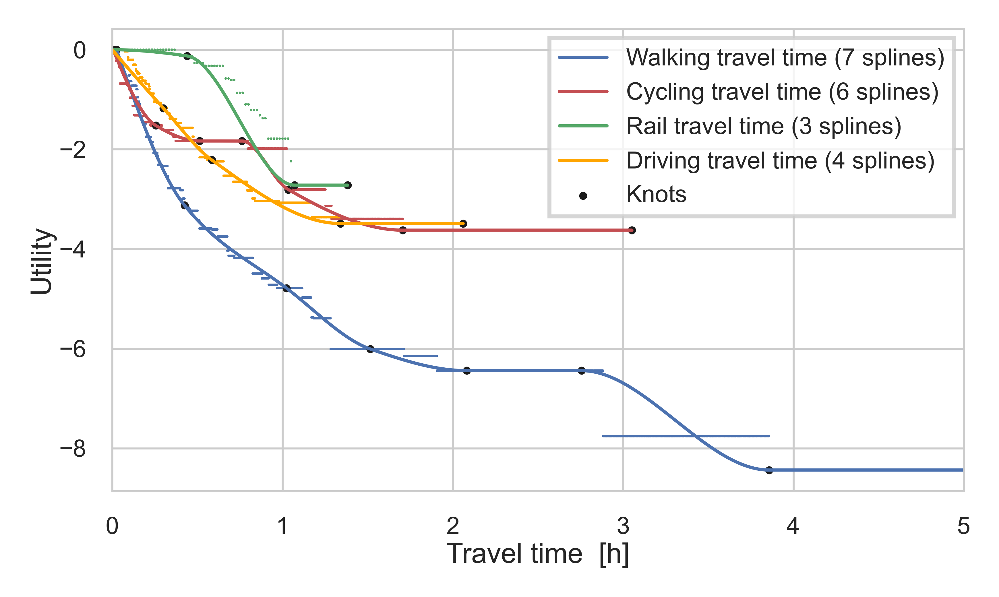

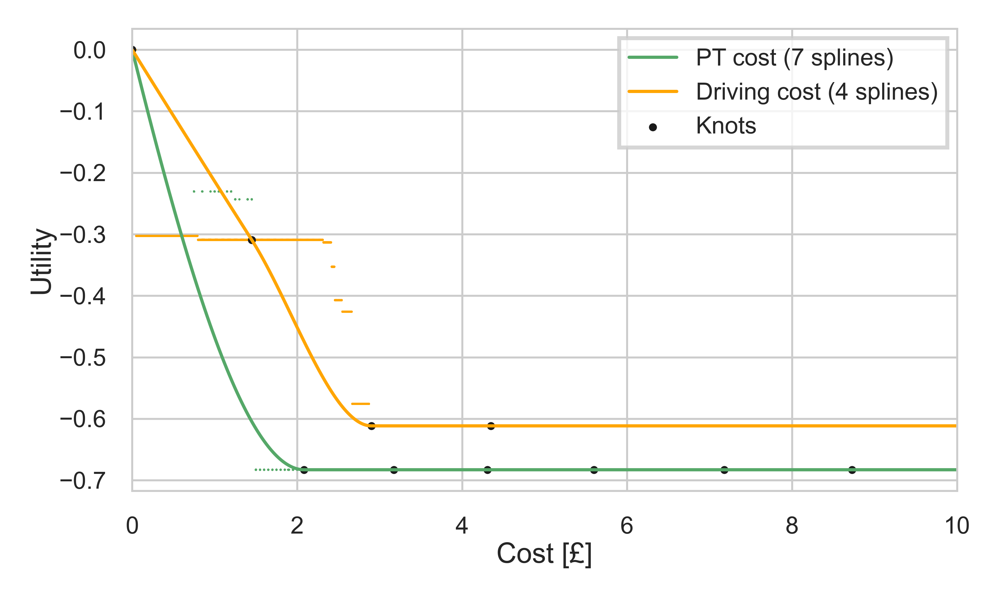

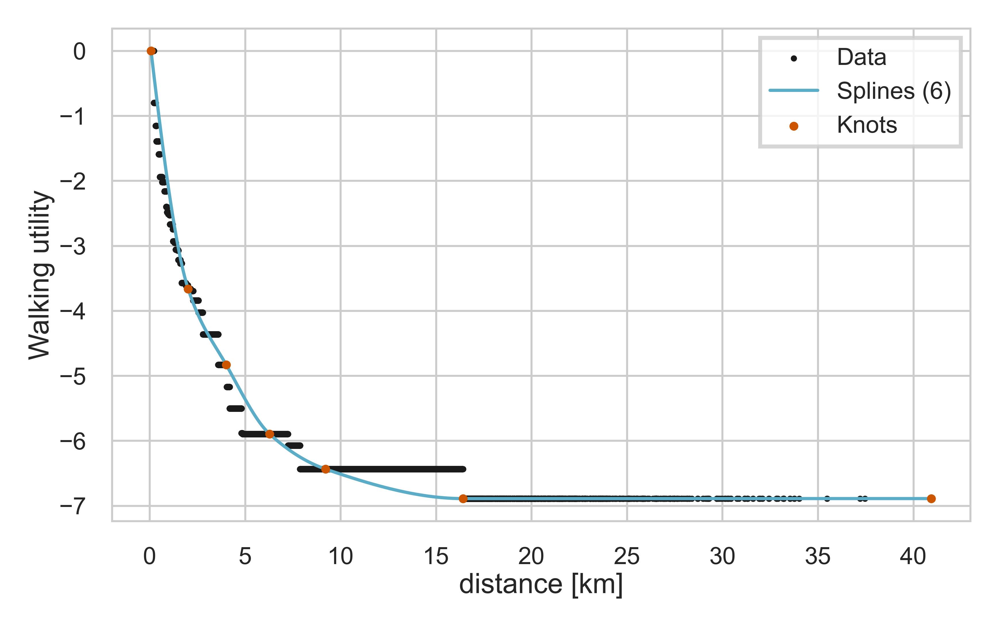

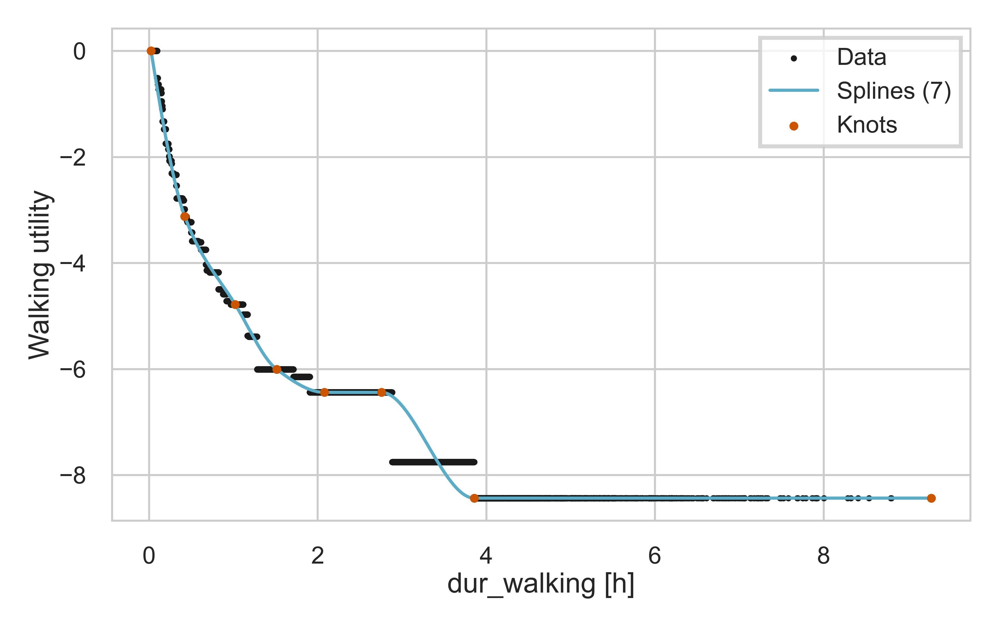

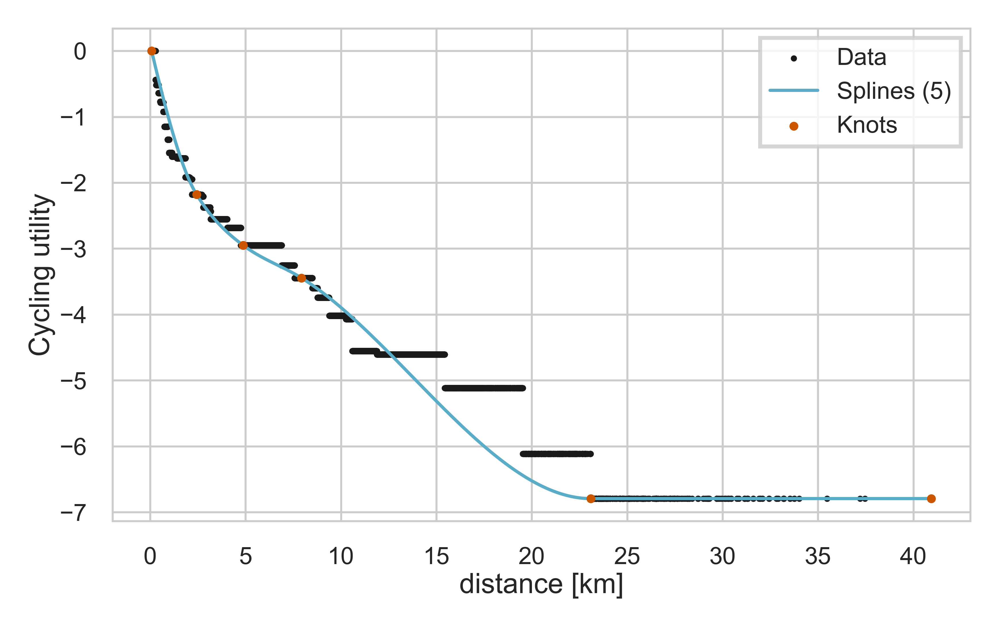

...

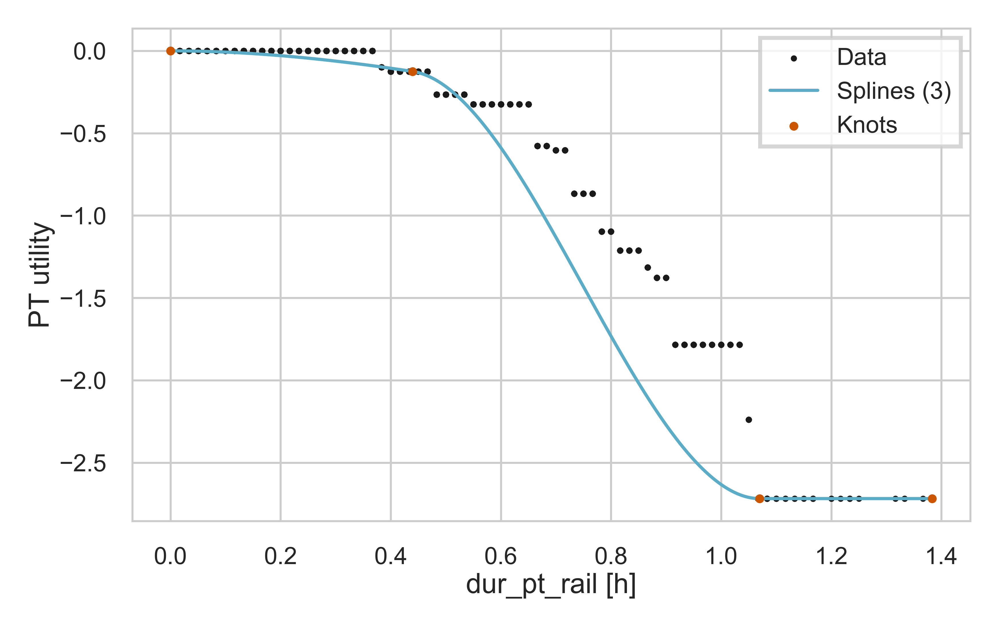

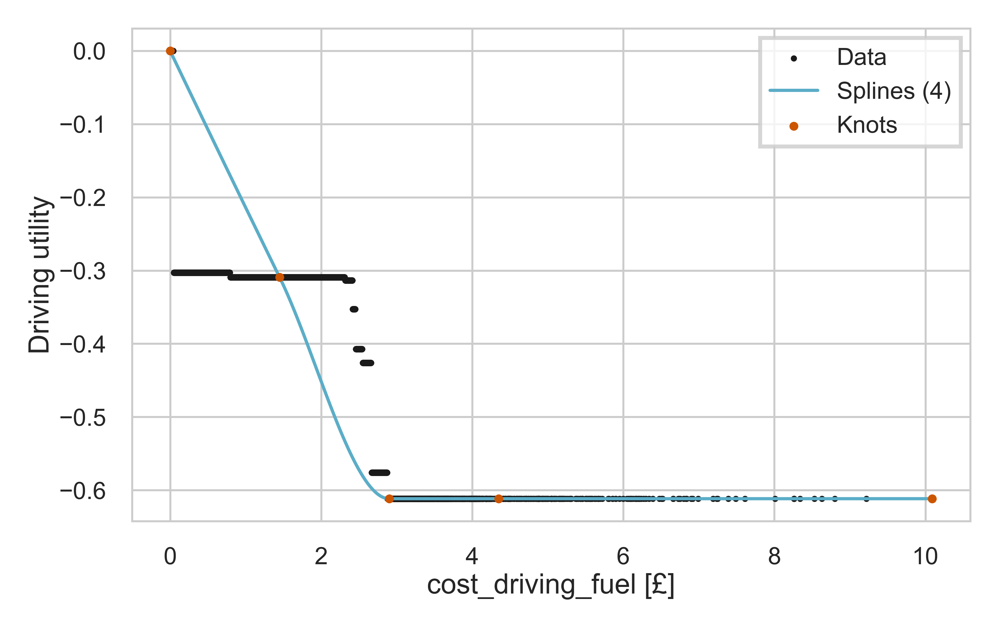

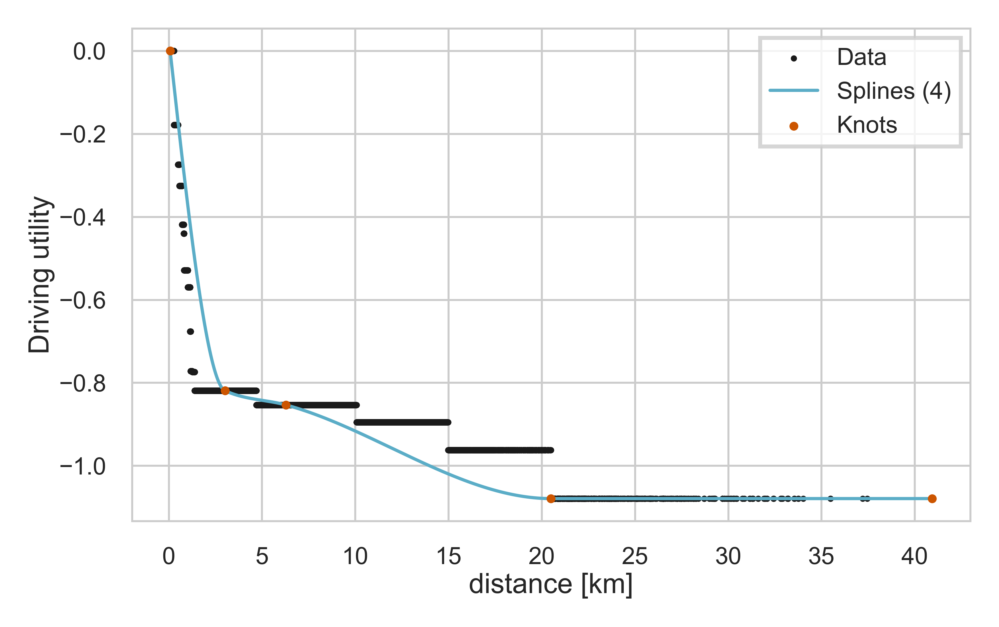

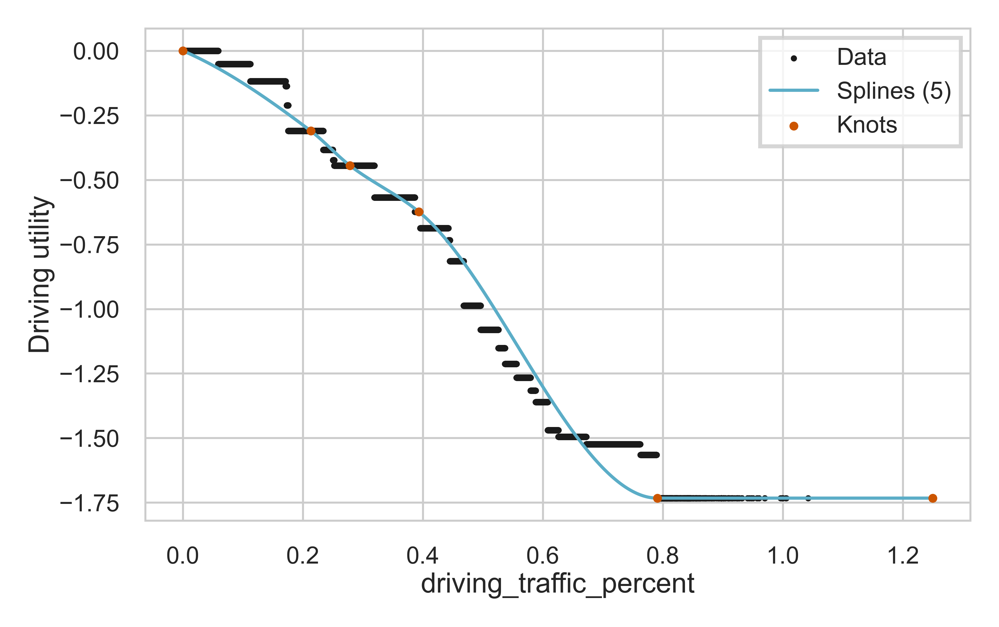

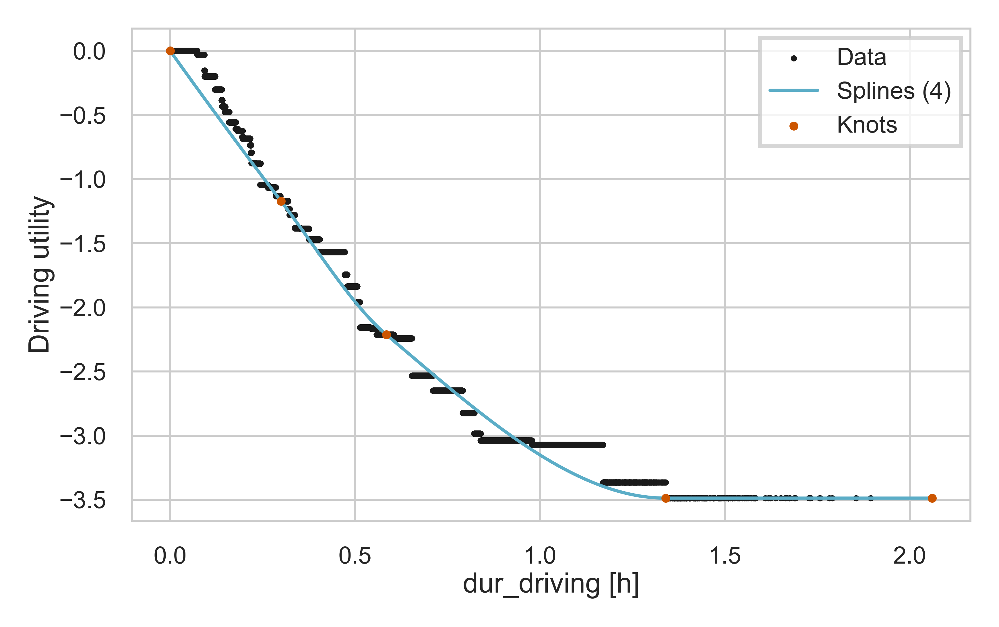

In [177]:
best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True)

### BIC =False, optimise = True, first_last_knot_fixed=False

In [178]:
param_space = {'0':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_0', 3, 7,1)),
'dur_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_walking', 3, 7,1))},
'1':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_1', 3, 7,1)),
'dur_cycling': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_cycling', 3, 7,1))},
'2':{'cost_transit': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_transit', 3, 7,1)),
#'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_2', 3, 7,1)),
'dur_pt_access': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_access', 3, 7,1)),
'dur_pt_bus': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_bus', 3, 7,1)),
'dur_pt_int_waiting': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_waiting', 3, 7,1)),
'dur_pt_int_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_walking', 3, 7,1)),
'dur_pt_rail': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_rail', 3, 7,1))},
'3':{'cost_driving_fuel': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_driving_fuel', 3, 7,1)),
'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_3', 3, 7,1)),
'driving_traffic_percent': hyperopt.pyll.scope.int(hyperopt.hp.quniform('driving_traffic_percent', 3, 7,1)),
'dur_driving': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_driving', 3, 7,1))}
}

# optimal number of splines (number of knots-1)
# param_space = {
#     "0": {"distance": 4, "dur_walking": 5},
#     "1": {"distance": 7, "dur_cycling": 6},
#     "2": {
#         "cost_transit": 3,
#         "dur_pt_access": 3,
#         "dur_pt_bus": 7,
#         "dur_pt_int_waiting": 4,
#         "dur_pt_int_walking": 7,
#         "dur_pt_rail": 4,
#     },
#     "3": {
#         "cost_driving_fuel": 3,
#         "distance": 4,
#         "driving_traffic_percent": 5,
#         "dur_driving": 5,
#     },
# }

In [179]:
def objective(space):
    dataset_train, _, _ = load_preprocess_LPMC(path="../Data/")
        
    weights = weights_to_plot_v2(LPMC_model_fully_trained)

    spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['distance', 'dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_access', 'dur_pt_int_walking', 'dur_pt_int_waiting'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}

    target = 'choice'

    spline_collection = space

    x_opt, x_first, x_last, loss = optimal_knots_position(weights, dataset_train, dataset_train, dataset_train[target], spline_utilities, spline_collection, max_iter = 200, bic=False, optimise = True, n_iter=1, first_last_knot_fixed=False)

    return {'loss': loss, 'x_opt':x_opt.x, 'status': hyperopt.STATUS_OK, 'x_first': x_first, 'x_last': x_last}

n=25
# n=1
trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n,
                                trials=trials)

best_classifier['_best_loss'] = trials.best_trial['result']['loss']
best_classifier['_x_opt'] = trials.best_trial['result']['x_opt']
best_classifier['_x_first'] = trials.best_trial['result']['x_first']
best_classifier['_x_last'] = trials.best_trial['result']['x_last']

  0%|          | 0/25 [00:00<?, ?trial/s, best loss=?]

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0) 
            Current function value:                   
0.6496752593626708                                    
            Iterations:                               
2                                                     
            Function evaluations:                     
191                                                   
            Gradient evaluations:                     
2                                                     
1/1:0.6496752593626708 with knots at: [7.70451259e-02 1.92896655e+00 3.81164808e+00 5.90416641e+00
 8.56617163e+00 1.23060984e+01 1.97960330e+01 2.52777780e-02
 5.13725064e-01 1.12449712e+00 1.69350900e+00 2.35679219e+00
 3.24743249e+00 4.86836385e+00 7.78663116e-02 2.31375478e+00
 4.61919230e+00 7.42101637e+00 1.14222067e+01 1.98000170e+01
 1.25177163e-02 2.50697577e-01 4.85893833e-01 7.26332187e-01
 9.79293272e-01 1.26031034e+00 1.73593763e+00 0.00000000e+00
 2.21953175e+00 3.38885020e+00 4.6917500

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Optimization terminated successfully    (Exit mode 0)                           
            Current function value:                                             
0.6515774284987006                                                              
            Iterations:                                                         
7                                                                               
            Function evaluations:                                               
242                                                                             
            Gradient evaluations:                                               
3                                                                               
1/1:0.6515774284987006 with knots at: [7.70000000e-02 2.27802232e+00 4.63127612e+00 7.41590242e+00
 1.14324764e+01 1.97911668e+01 2.52799050e-02 4.40473321e-01
 1.13404476e+00 1.69205053e+00 2.36022599e+00 3.24317716e+00
 4.87264985e+00 7.70000000e-02 3.80778038e+00 8.57

In [180]:
weights = weights_to_plot_v2(LPMC_model_fully_trained)

spline_collection = {'0':{'distance': int(best_classifier['distance_0']),
                    'dur_walking': int(best_classifier['dur_walking'])},
            '1':{'distance': int(best_classifier['distance_1']),
                    'dur_cycling': int(best_classifier['dur_cycling'])},
            '2':{'cost_transit': int(best_classifier['cost_transit']),
                    #'distance': int(best_classifier['distance_2']),
                    'dur_pt_access': int(best_classifier['dur_pt_access']),
                    'dur_pt_bus': int(best_classifier['dur_pt_bus']),
                    'dur_pt_int_waiting': int(best_classifier['dur_pt_int_waiting']),
                    'dur_pt_int_walking': int(best_classifier['dur_pt_int_walking']),
                    'dur_pt_rail': int(best_classifier['dur_pt_rail'])},
            '3':{'cost_driving_fuel': int(best_classifier['cost_driving_fuel']),
                    'distance': int(best_classifier['distance_3']),
                    'driving_traffic_percent': int(best_classifier['driving_traffic_percent']),
                    'dur_driving': int(best_classifier['dur_driving'])}
                }


# spline_collection = {
#     "0": {"distance": 4, "dur_walking": 5},
#     "1": {"distance": 7, "dur_cycling": 6},
#     "2": {
#         "cost_transit": 3,
#         "dur_pt_access": 3,
#         "dur_pt_bus": 7,
#         "dur_pt_int_waiting": 4,
#         "dur_pt_int_walking": 7,
#         "dur_pt_rail": 4,
#     },
#     "3": {
#         "cost_driving_fuel": 3,
#         "distance": 4,
#         "driving_traffic_percent": 5,
#         "dur_driving": 5,
#     },
# }

spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_int_waiting', 'dur_pt_int_walking', 'dur_pt_access'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}
x_knots_dict = map_x_knots(trials.best_trial['result']['x_opt'], spline_collection, trials.best_trial['result']['x_first'], trials.best_trial['result']['x_last'])
util_collection = updated_utility_collection(weights, LPMC_train, spline_collection, spline_utilities, mean_splines=False, x_knots = x_knots_dict)

y_pred = smooth_predict(LPMC_test, util_collection)
CE_final = cross_entropy(y_pred, LPMC_test['choice'])
best_classifier['_on_test_set'] = CE_final

print(f'Smoothed final cross entropy loss: {CE_final}')

Smoothed final cross entropy loss: 0.6773814025411494


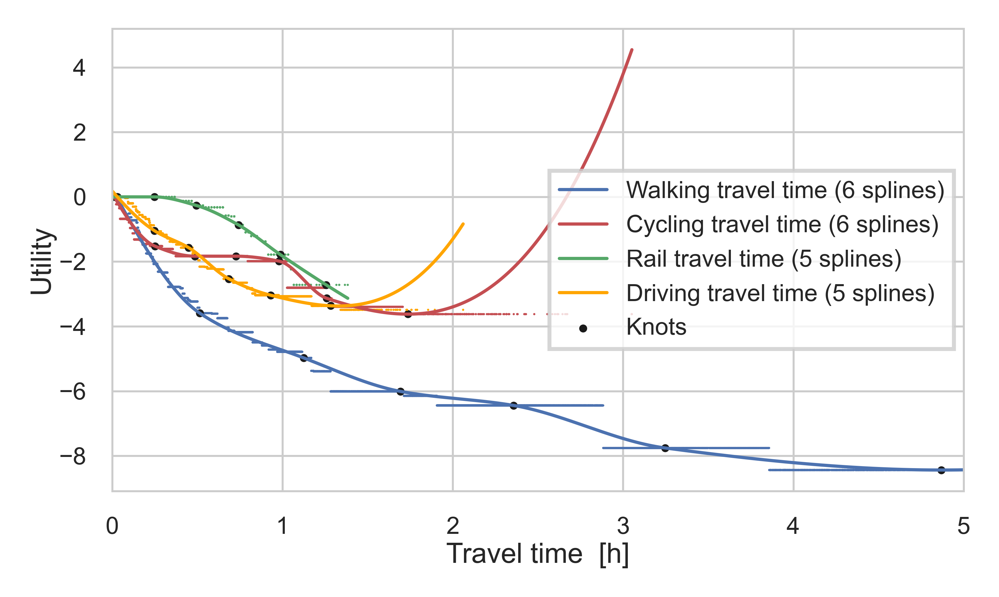

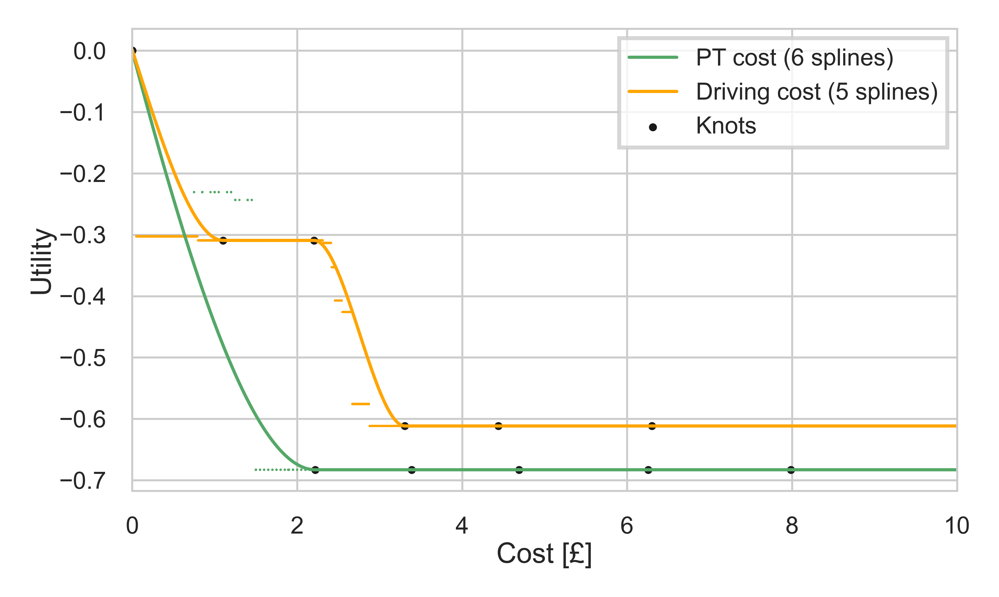

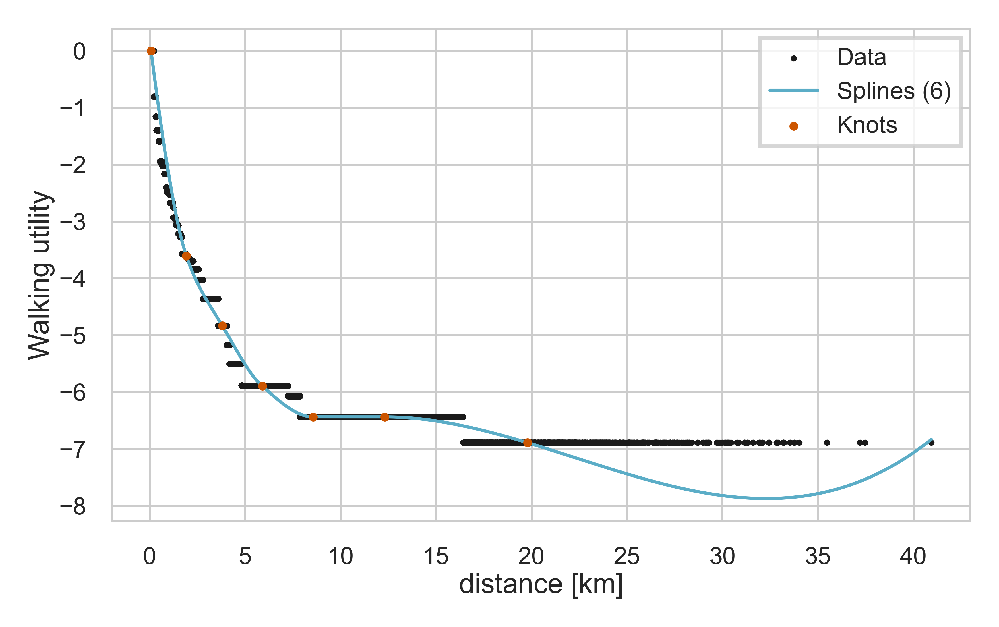

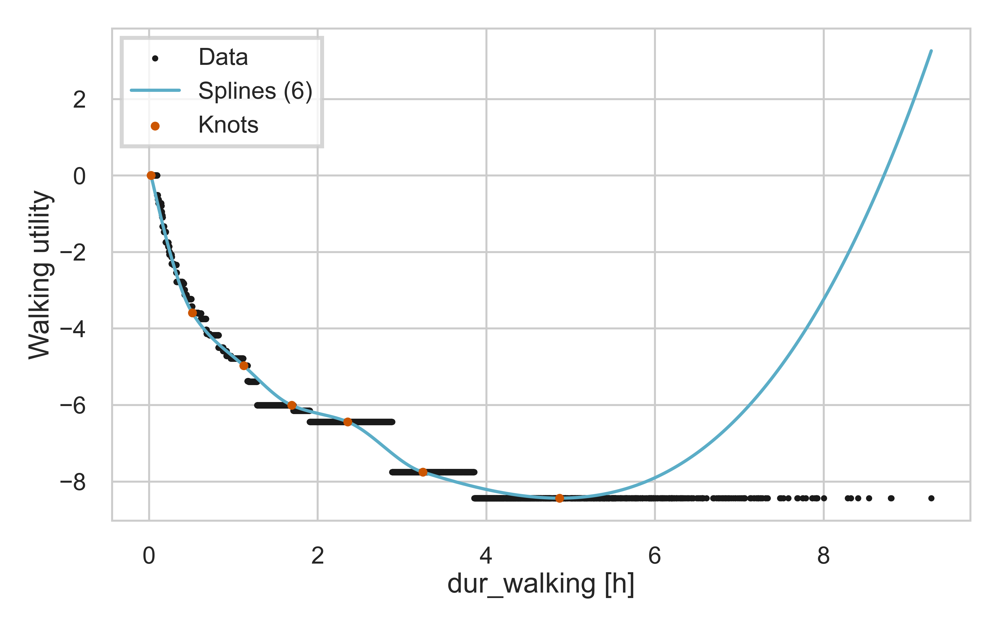

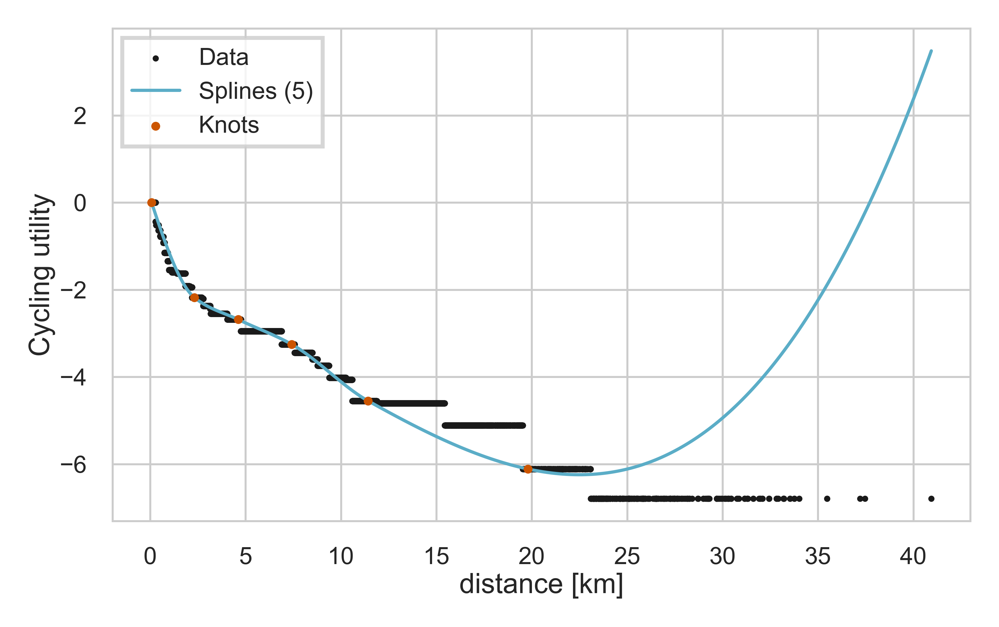

...

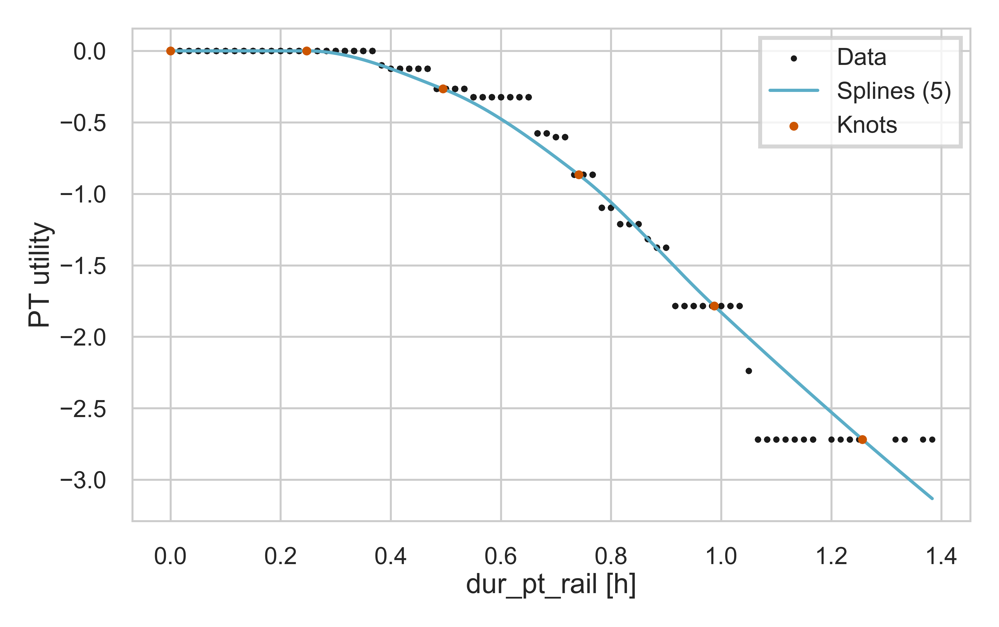

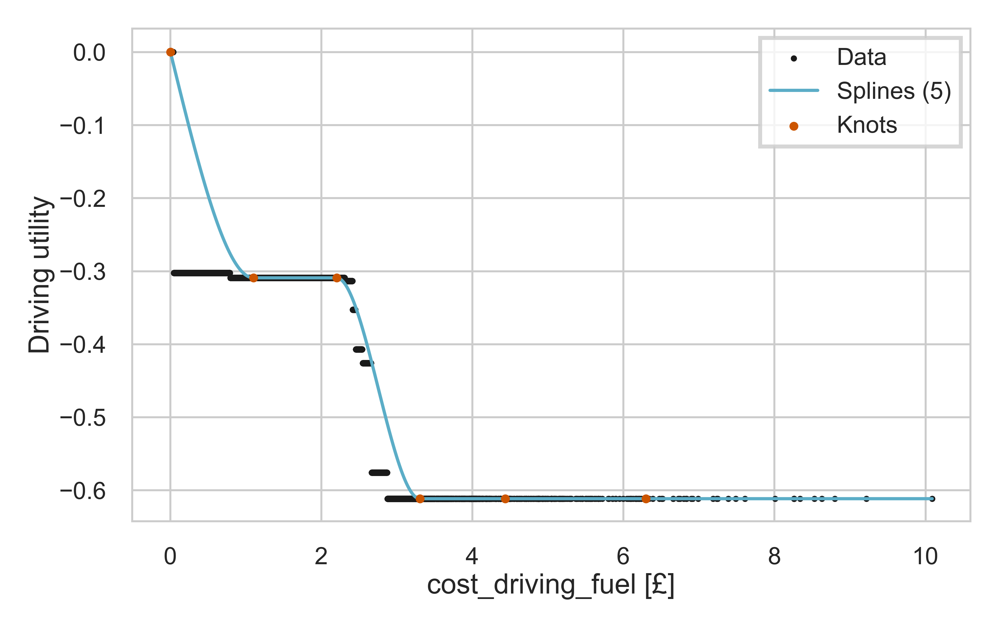

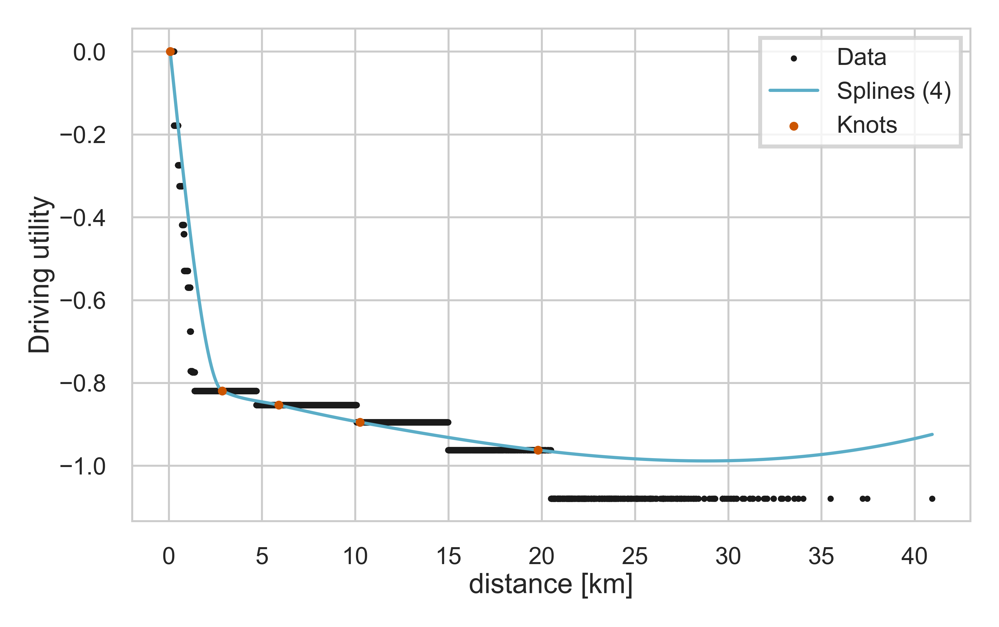

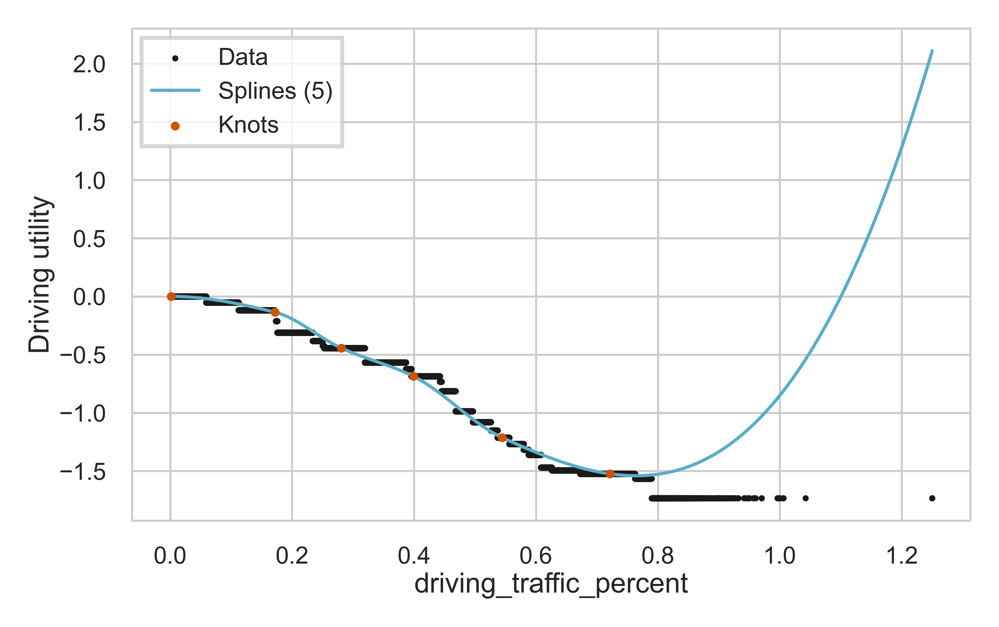

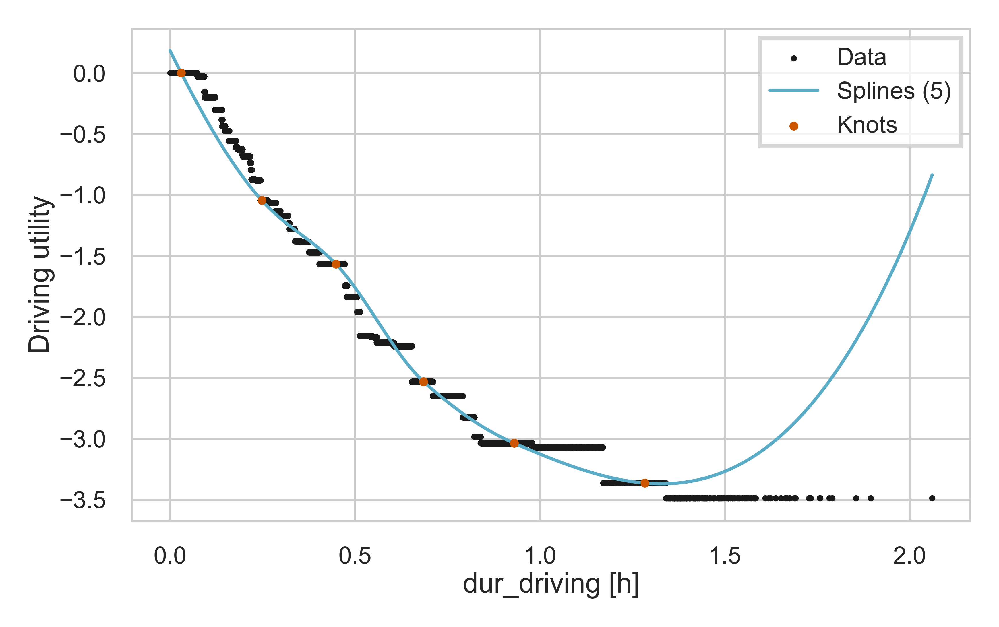

In [181]:
best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True)

### bic=True, optimise = False, first_last_knot_fixed=True XXXXX

 `optimise=False`, and this allow us to test several knots position at the same time.

In [200]:
param_space = {'0':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_0', 3, 7,1)),
'dur_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_walking', 3, 7,1))},
'1':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_1', 3, 7,1)),
'dur_cycling': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_cycling', 3, 7,1))},
'2':{'cost_transit': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_transit', 3, 7,1)),
#'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_2', 3, 7,1)),
'dur_pt_access': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_access', 3, 7,1)),
'dur_pt_bus': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_bus', 3, 7,1)),
'dur_pt_int_waiting': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_waiting', 3, 7,1)),
'dur_pt_int_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_walking', 3, 7,1)),
'dur_pt_rail': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_rail', 3, 7,1))},
'3':{'cost_driving_fuel': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_driving_fuel', 3, 7,1)),
'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_3', 3, 7,1)),
'driving_traffic_percent': hyperopt.pyll.scope.int(hyperopt.hp.quniform('driving_traffic_percent', 3, 7,1)),
'dur_driving': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_driving', 3, 7,1))}
}

# optimal number of splines (number of knots-1)
# param_space = {
#     "0": {"distance": 4, "dur_walking": 5},
#     "1": {"distance": 7, "dur_cycling": 6},
#     "2": {
#         "cost_transit": 3,
#         "dur_pt_access": 3,
#         "dur_pt_bus": 7,
#         "dur_pt_int_waiting": 4,
#         "dur_pt_int_walking": 7,
#         "dur_pt_rail": 4,
#     },
#     "3": {
#         "cost_driving_fuel": 3,
#         "distance": 4,
#         "driving_traffic_percent": 5,
#         "dur_driving": 5,
#     },
# }

In [201]:
def objective(space):
    dataset_train, _, _ = load_preprocess_LPMC(path="../Data/")
        
    weights = weights_to_plot_v2(LPMC_model_fully_trained)

    spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['distance', 'dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_access', 'dur_pt_int_walking', 'dur_pt_int_waiting'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}

    target = 'choice'

    spline_collection = space

    x_opt, x_first, x_last, loss = optimal_knots_position(weights, dataset_train, dataset_train, dataset_train[target], spline_utilities, spline_collection, max_iter = 200, bic= True, optimise = False, n_iter=1, first_last_knot_fixed=True)

    return {'loss': loss, 'x_opt':x_opt.x, 'status': hyperopt.STATUS_OK, 'x_first': x_first, 'x_last': x_last}

n=25
# n=1
trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n,
                                trials=trials)

best_classifier['_best_loss'] = trials.best_trial['result']['loss']
best_classifier['_x_opt'] = trials.best_trial['result']['x_opt']
best_classifier['_x_first'] = trials.best_trial['result']['x_first']
best_classifier['_x_last'] = trials.best_trial['result']['x_last']

1/1:76473.92129665734                                 
  0%|          | 0/25 [00:00<?, ?trial/s, best loss=?]

job exception: 'list' object has no attribute 'x'



  0%|          | 0/25 [00:00<?, ?trial/s, best loss=?]


AttributeError: 'list' object has no attribute 'x'

In [ ]:
weights = weights_to_plot_v2(LPMC_model_fully_trained)

spline_collection = {'0':{'distance': int(best_classifier['distance_0']),
                    'dur_walking': int(best_classifier['dur_walking'])},
            '1':{'distance': int(best_classifier['distance_1']),
                    'dur_cycling': int(best_classifier['dur_cycling'])},
            '2':{'cost_transit': int(best_classifier['cost_transit']),
                    #'distance': int(best_classifier['distance_2']),
                    'dur_pt_access': int(best_classifier['dur_pt_access']),
                    'dur_pt_bus': int(best_classifier['dur_pt_bus']),
                    'dur_pt_int_waiting': int(best_classifier['dur_pt_int_waiting']),
                    'dur_pt_int_walking': int(best_classifier['dur_pt_int_walking']),
                    'dur_pt_rail': int(best_classifier['dur_pt_rail'])},
            '3':{'cost_driving_fuel': int(best_classifier['cost_driving_fuel']),
                    'distance': int(best_classifier['distance_3']),
                    'driving_traffic_percent': int(best_classifier['driving_traffic_percent']),
                    'dur_driving': int(best_classifier['dur_driving'])}
                }


# spline_collection = {
#     "0": {"distance": 4, "dur_walking": 5},
#     "1": {"distance": 7, "dur_cycling": 6},
#     "2": {
#         "cost_transit": 3,
#         "dur_pt_access": 3,
#         "dur_pt_bus": 7,
#         "dur_pt_int_waiting": 4,
#         "dur_pt_int_walking": 7,
#         "dur_pt_rail": 4,
#     },
#     "3": {
#         "cost_driving_fuel": 3,
#         "distance": 4,
#         "driving_traffic_percent": 5,
#         "dur_driving": 5,
#     },
# }

spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_int_waiting', 'dur_pt_int_walking', 'dur_pt_access'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}
x_knots_dict = map_x_knots(trials.best_trial['result']['x_opt'], spline_collection, trials.best_trial['result']['x_first'], trials.best_trial['result']['x_last'])
util_collection = updated_utility_collection(weights, LPMC_train, spline_collection, spline_utilities, mean_splines=False, x_knots = x_knots_dict)

y_pred = smooth_predict(LPMC_test, util_collection)
CE_final = cross_entropy(y_pred, LPMC_test['choice'])
best_classifier['_on_test_set'] = CE_final

print(f'Smoothed final cross entropy loss: {CE_final}')

Smoothed final cross entropy loss: 0.6763906051588351


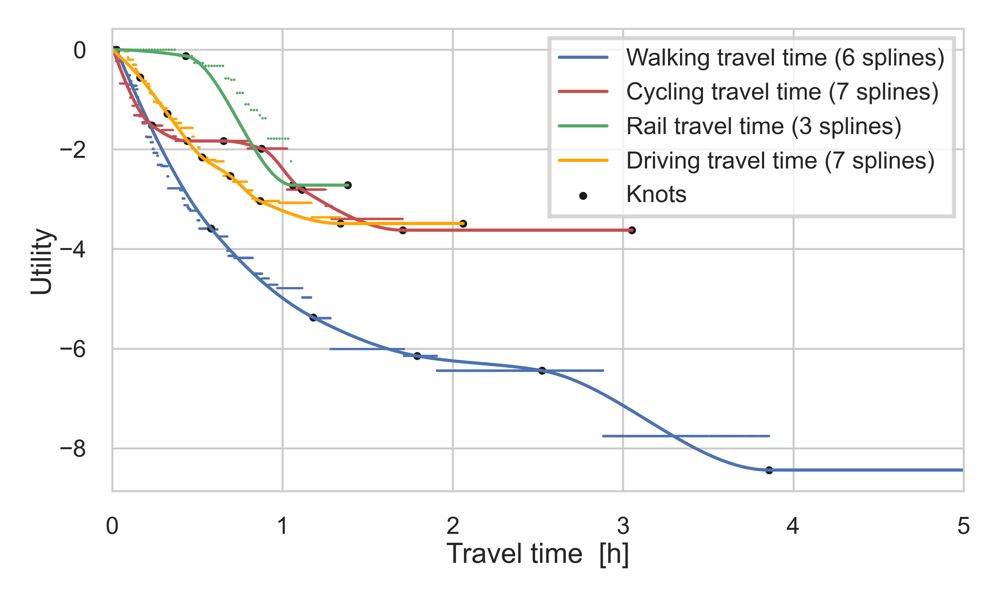

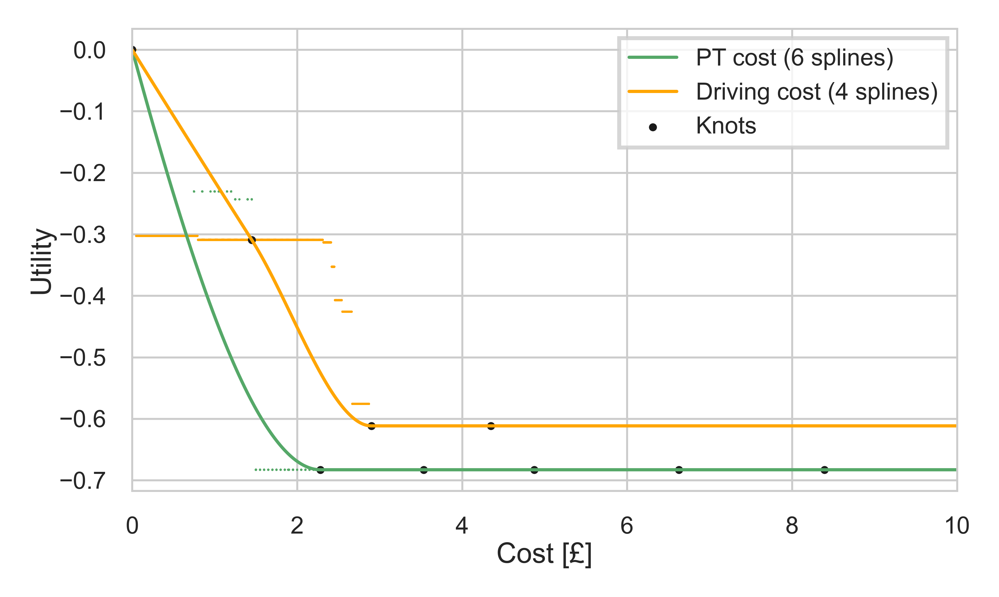

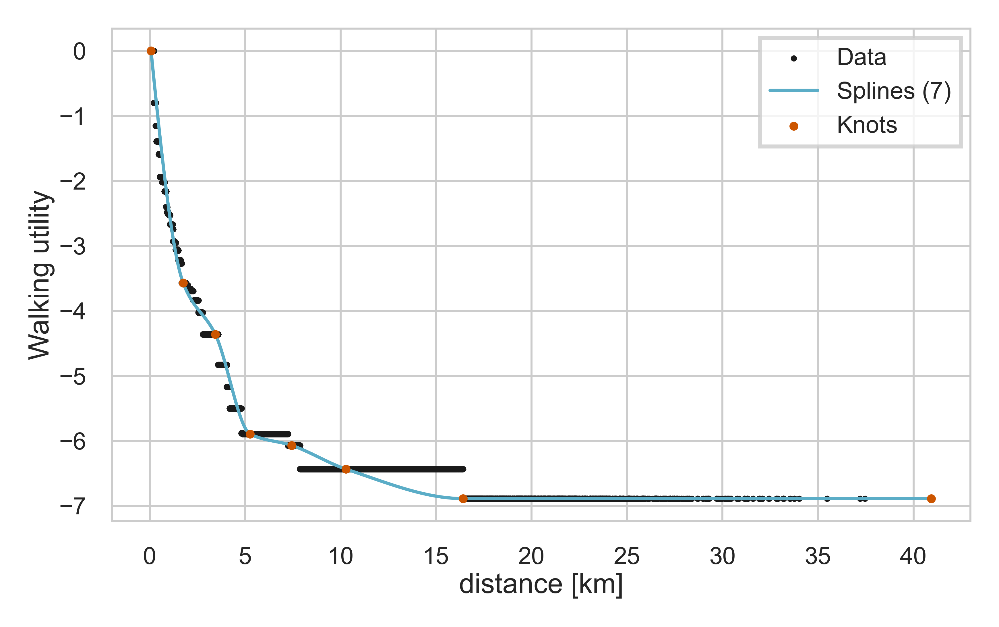

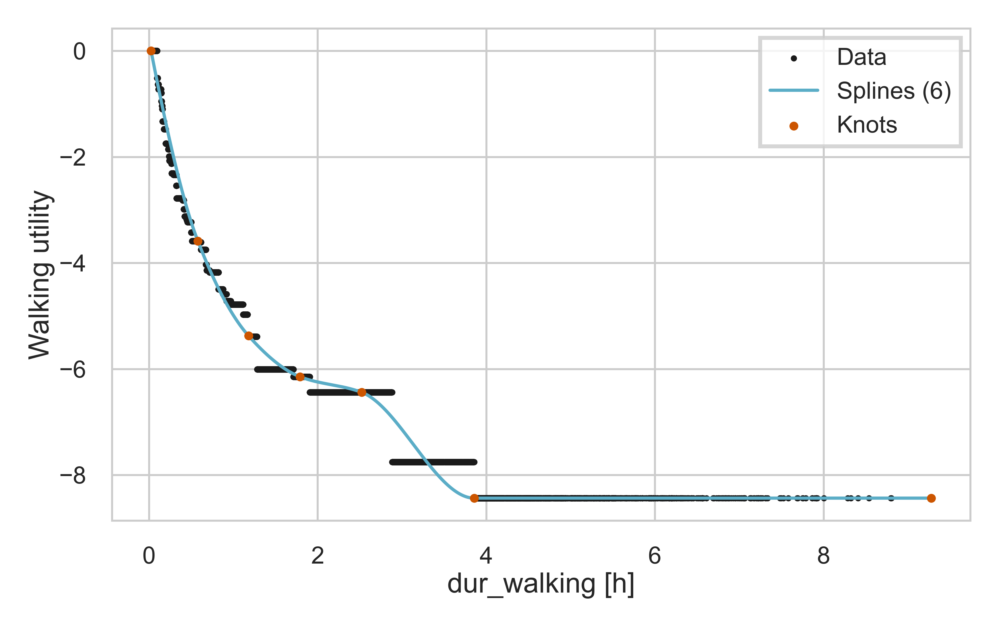

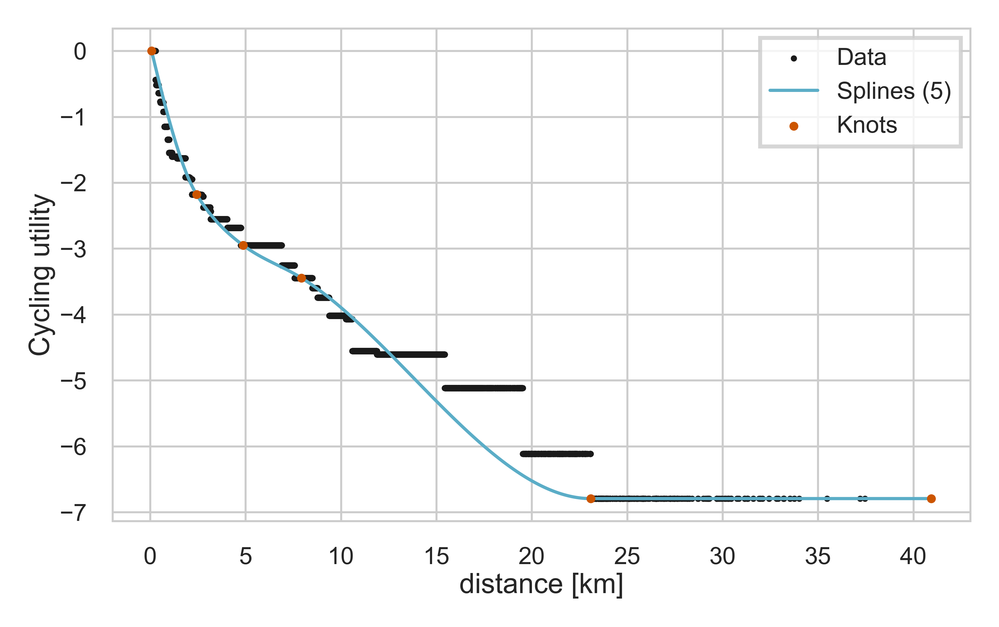

...

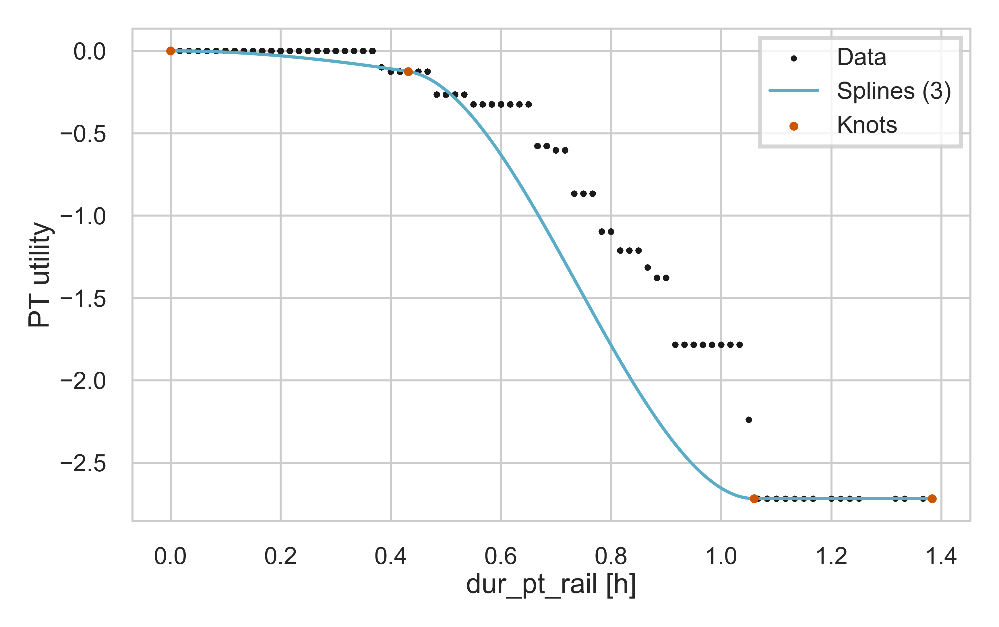

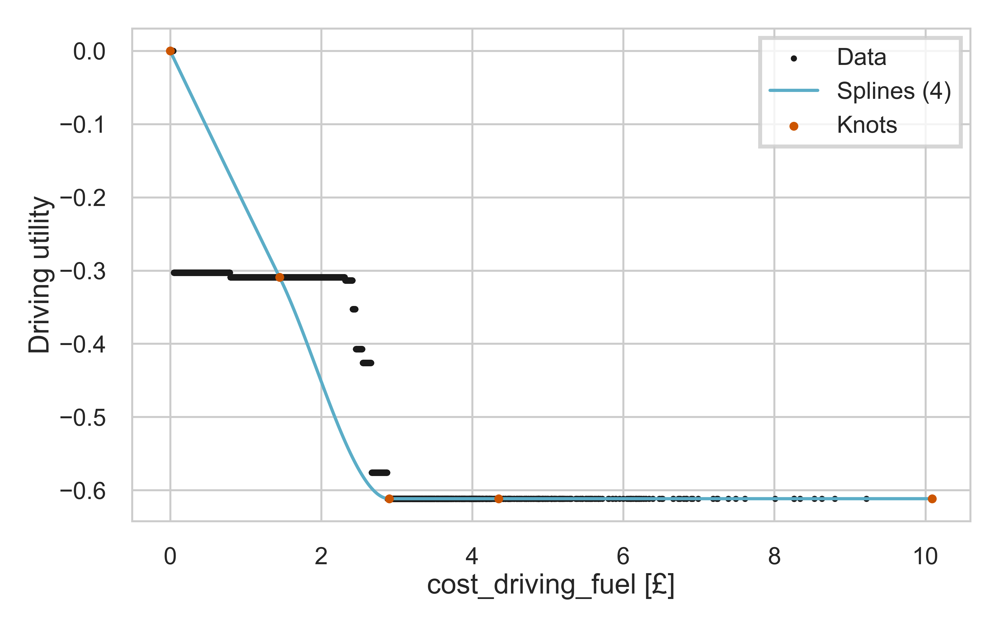

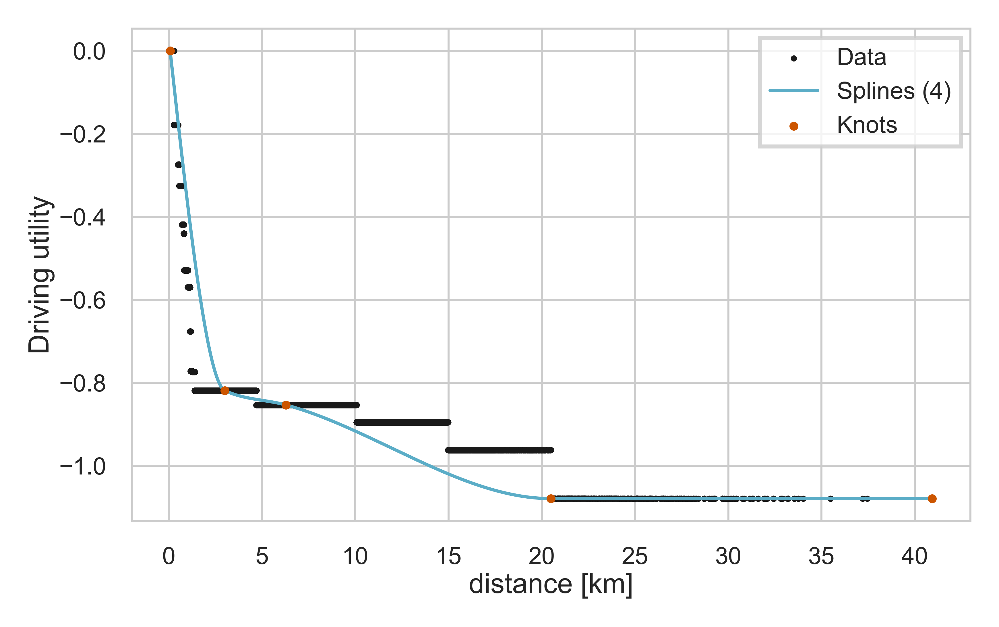

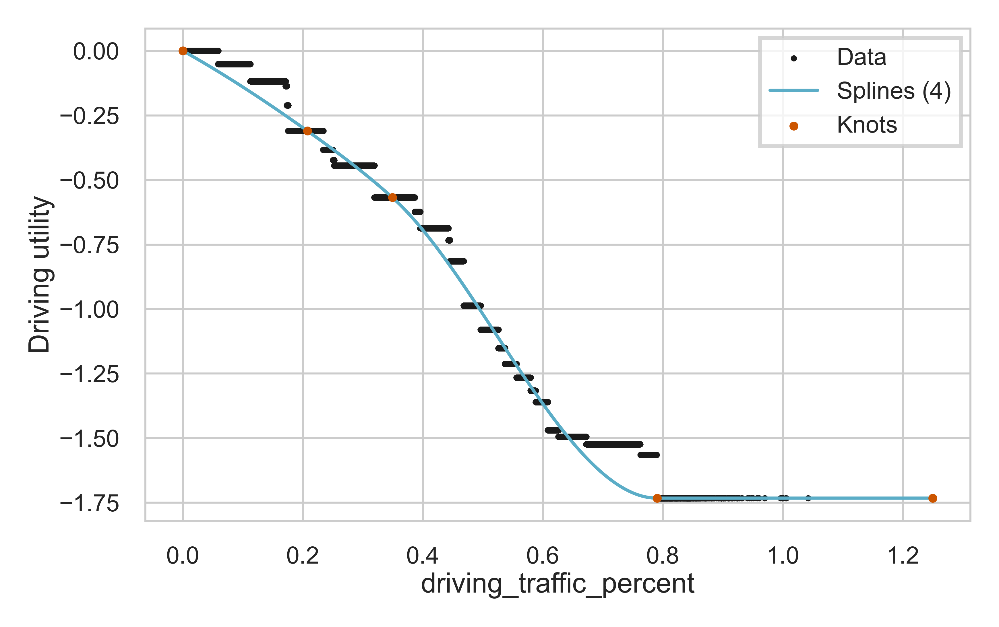

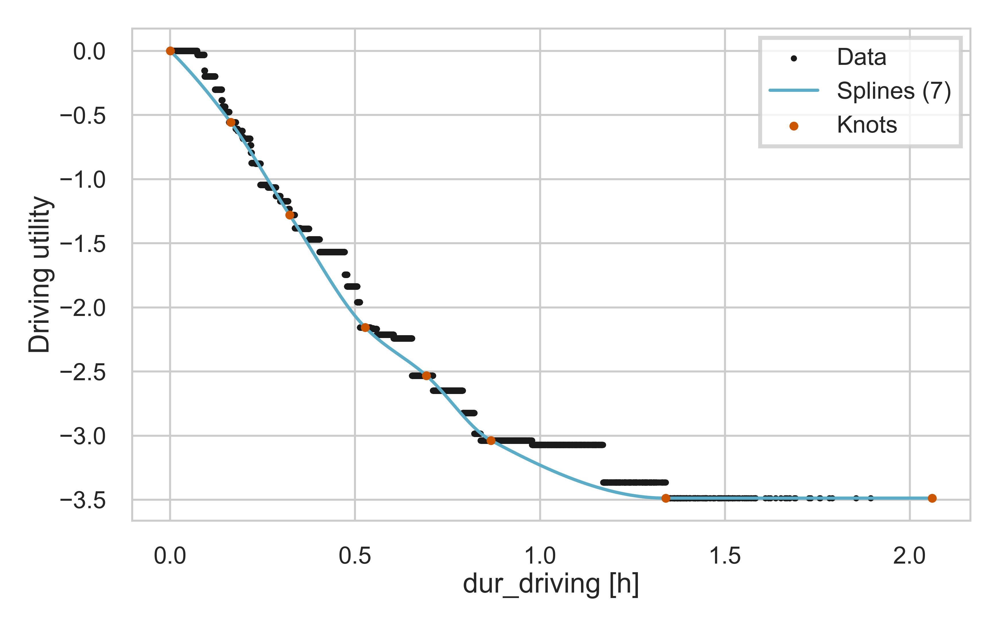

In [185]:
best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True)

### bic=True, optimise = True, first_last_knot_fixed=False

 `optimise=False`, and this allow us to test several knots position at the same time.

In [186]:
param_space = {'0':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_0', 3, 7,1)),
'dur_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_walking', 3, 7,1))},
'1':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_1', 3, 7,1)),
'dur_cycling': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_cycling', 3, 7,1))},
'2':{'cost_transit': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_transit', 3, 7,1)),
#'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_2', 3, 7,1)),
'dur_pt_access': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_access', 3, 7,1)),
'dur_pt_bus': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_bus', 3, 7,1)),
'dur_pt_int_waiting': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_waiting', 3, 7,1)),
'dur_pt_int_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_walking', 3, 7,1)),
'dur_pt_rail': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_rail', 3, 7,1))},
'3':{'cost_driving_fuel': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_driving_fuel', 3, 7,1)),
'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_3', 3, 7,1)),
'driving_traffic_percent': hyperopt.pyll.scope.int(hyperopt.hp.quniform('driving_traffic_percent', 3, 7,1)),
'dur_driving': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_driving', 3, 7,1))}
}

# optimal number of splines (number of knots-1)
# param_space = {
#     "0": {"distance": 4, "dur_walking": 5},
#     "1": {"distance": 7, "dur_cycling": 6},
#     "2": {
#         "cost_transit": 3,
#         "dur_pt_access": 3,
#         "dur_pt_bus": 7,
#         "dur_pt_int_waiting": 4,
#         "dur_pt_int_walking": 7,
#         "dur_pt_rail": 4,
#     },
#     "3": {
#         "cost_driving_fuel": 3,
#         "distance": 4,
#         "driving_traffic_percent": 5,
#         "dur_driving": 5,
#     },
# }

In [162]:
def objective(space):
    dataset_train, _, _ = load_preprocess_LPMC(path="../Data/")
        
    weights = weights_to_plot_v2(LPMC_model_fully_trained)

    spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['distance', 'dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_access', 'dur_pt_int_walking', 'dur_pt_int_waiting'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}

    target = 'choice'

    spline_collection = space

    x_opt, x_first, x_last, loss = optimal_knots_position(weights, dataset_train, dataset_train, dataset_train[target], spline_utilities, spline_collection, max_iter = 200, bic=True, optimise = True, n_iter=1, first_last_knot_fixed=False)

    return {'loss': loss, 'x_opt':x_opt.x, 'status': hyperopt.STATUS_OK, 'x_first': x_first, 'x_last': x_last}

n=25
# n=1
trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n,
                                trials=trials)

best_classifier['_best_loss'] = trials.best_trial['result']['loss']
best_classifier['_x_opt'] = trials.best_trial['result']['x_opt']
best_classifier['_x_first'] = trials.best_trial['result']['x_first']
best_classifier['_x_last'] = trials.best_trial['result']['x_last']

  0%|          | 0/25 [00:00<?, ?trial/s, best loss=?]

Inequality constraints incompatible    (Exit mode 4)  
            Current function value:                   
76832.04165729936                                     
            Iterations:                               
1                                                     
            Function evaluations:                     
82                                                    
            Gradient evaluations:                     
1                                                     
1/1:76832.04165729936 with knots at: [7.70000000e-02 3.81050000e+00 8.56700000e+00 1.97980000e+01
 2.52777780e-02 8.46583334e-01 1.69288889e+00 2.74947222e+00
 4.86838889e+00 7.70000000e-02 1.68807143e+00 3.26414286e+00
 4.97421429e+00 6.95028571e+00 9.48035714e+00 1.30417143e+01
 1.97980000e+01 6.11111100e-03 3.66270833e-01 7.26152778e-01
 1.11075694e+00 1.72855556e+00 0.00000000e+00 2.80437500e+00
 4.69175000e+00 7.16312500e+00 1.00350000e+01 0.00000000e+00
 7.42242065e-02 1.44003968e-01 2.13783730

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                           
            Current function value:                                            
72467.74974680529                                                              
            Iterations:                                                        
3                                                                              
            Function evaluations:                                              
188                                                                            
            Gradient evaluations:                                              
2                                                                              
1/1:72467.74974680529 with knots at: [7.70000000e-02 1.68655372e+00 3.29963641e+00 4.98891546e+00
 6.94985980e+00 9.47946480e+00 1.30416361e+01 1.97978225e+01
 2.52777780e-02 8.45809621e-01 1.70003477e+00 2.74690589e+00
 4.86598501e+00 7.70000000e-02 2.86774350e+00 5.90533238e+00

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                           
            Current function value:                                            
74162.7595145802                                                               
            Iterations:                                                        
2                                                                              
            Function evaluations:                                              
169                                                                            
            Gradient evaluations:                                              
2                                                                              
1/1:74162.7595145802 with knots at: [7.70000000e-02 3.80620372e+00 8.60425403e+00 1.98055337e+01
 2.52777780e-02 5.77826391e-01 1.12851875e+00 1.69096990e+00
 2.36479817e+00 3.24360709e+00 4.87346358e+00 1.24023808e-01
 1.73324131e+00 3.26549813e+00 4.98183681e+00 6.96016140e+00


/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                            
            Current function value:                                             
72689.59114235408                                                               
            Iterations:                                                         
3                                                                               
            Function evaluations:                                               
271                                                                             
            Gradient evaluations:                                               
3                                                                               
1/1:72689.59114235408 with knots at: [7.70000000e-02 1.93834548e+00 3.94772381e+00 5.89148300e+00
 8.58197641e+00 1.22859711e+01 1.98099558e+01 2.52777780e-02
 6.83325687e-01 1.37169575e+00 2.10094621e+00 3.01559653e+00
 4.88468679e+00 2.05418366e-01 1.68211737e+00 3.277

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                            
            Current function value:                                             
72640.44384183882                                                               
            Iterations:                                                         
2                                                                               
            Function evaluations:                                               
156                                                                             
            Gradient evaluations:                                               
2                                                                               
1/1:72640.44384183882 with knots at: [7.70000000e-02 2.86662616e+00 5.94777562e+00 1.02374709e+01
 1.98263749e+01 2.52777780e-02 5.01772362e-01 9.73763265e-01
 1.43922685e+00 1.96335905e+00 2.58688912e+00 3.40632147e+00
 4.87430724e+00 1.14887885e-01 2.86662616e+00 5.912

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                            
            Current function value:                                             
72528.37979054521                                                               
            Iterations:                                                         
2                                                                               
            Function evaluations:                                               
183                                                                             
            Gradient evaluations:                                               
2                                                                               
1/1:72528.37979054521 with knots at: [7.70000000e-02 1.93759668e+00 3.96260582e+00 5.87689290e+00
 8.59006700e+00 1.22673255e+01 1.98182866e+01 2.52777780e-02
 5.76196829e-01 1.15255397e+00 1.68605749e+00 2.38518739e+00
 3.23411568e+00 4.88645431e+00 2.44400172e-01 2.011

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                            
            Current function value:                                             
72152.8412268479                                                                
            Iterations:                                                         
3                                                                               
            Function evaluations:                                               
261                                                                             
            Gradient evaluations:                                               
3                                                                               
1/1:72152.8412268479 with knots at: [7.70000000e-02 1.94162226e+00 3.88259938e+00 5.89047621e+00
 8.59038835e+00 1.22795093e+01 1.98172129e+01 2.52777780e-02
 5.01486206e-01 9.78750519e-01 1.43837771e+00 1.96744433e+00
 2.59090762e+00 3.40429100e+00 4.87695204e+00 7.7000

/Users/leovilardo/rumboost/venv/lib/python3.11/site-packages/scipy/optimize/_optimize.py:353: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "



Inequality constraints incompatible    (Exit mode 4)                           
            Current function value:                                            
72522.38739256235                                                              
            Iterations:                                                        
2                                                                              
            Function evaluations:                                              
192                                                                            
            Gradient evaluations:                                              
2                                                                              
1/1:72522.38739256235 with knots at: [7.70000000e-02 1.94170436e+00 3.88096772e+00 5.88969746e+00
 8.57463035e+00 1.22932401e+01 1.98031561e+01 2.52777780e-02
 5.77413106e-01 1.13461449e+00 1.68972403e+00 2.36996923e+00
 3.24119991e+00 4.87675825e+00 1.54553305e-01 2.31704007e+00

In [187]:
weights = weights_to_plot_v2(LPMC_model_fully_trained)

spline_collection = {'0':{'distance': int(best_classifier['distance_0']),
                    'dur_walking': int(best_classifier['dur_walking'])},
            '1':{'distance': int(best_classifier['distance_1']),
                    'dur_cycling': int(best_classifier['dur_cycling'])},
            '2':{'cost_transit': int(best_classifier['cost_transit']),
                    #'distance': int(best_classifier['distance_2']),
                    'dur_pt_access': int(best_classifier['dur_pt_access']),
                    'dur_pt_bus': int(best_classifier['dur_pt_bus']),
                    'dur_pt_int_waiting': int(best_classifier['dur_pt_int_waiting']),
                    'dur_pt_int_walking': int(best_classifier['dur_pt_int_walking']),
                    'dur_pt_rail': int(best_classifier['dur_pt_rail'])},
            '3':{'cost_driving_fuel': int(best_classifier['cost_driving_fuel']),
                    'distance': int(best_classifier['distance_3']),
                    'driving_traffic_percent': int(best_classifier['driving_traffic_percent']),
                    'dur_driving': int(best_classifier['dur_driving'])}
                }


# spline_collection = {
#     "0": {"distance": 4, "dur_walking": 5},
#     "1": {"distance": 7, "dur_cycling": 6},
#     "2": {
#         "cost_transit": 3,
#         "dur_pt_access": 3,
#         "dur_pt_bus": 7,
#         "dur_pt_int_waiting": 4,
#         "dur_pt_int_walking": 7,
#         "dur_pt_rail": 4,
#     },
#     "3": {
#         "cost_driving_fuel": 3,
#         "distance": 4,
#         "driving_traffic_percent": 5,
#         "dur_driving": 5,
#     },
# }

spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_int_waiting', 'dur_pt_int_walking', 'dur_pt_access'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}
x_knots_dict = map_x_knots(trials.best_trial['result']['x_opt'], spline_collection, trials.best_trial['result']['x_first'], trials.best_trial['result']['x_last'])
util_collection = updated_utility_collection(weights, LPMC_train, spline_collection, spline_utilities, mean_splines=False, x_knots = x_knots_dict)

y_pred = smooth_predict(LPMC_test, util_collection)
CE_final = cross_entropy(y_pred, LPMC_test['choice'])
best_classifier['_on_test_set'] = CE_final

print(f'Smoothed final cross entropy loss: {CE_final}')

Smoothed final cross entropy loss: 0.6763906051588351


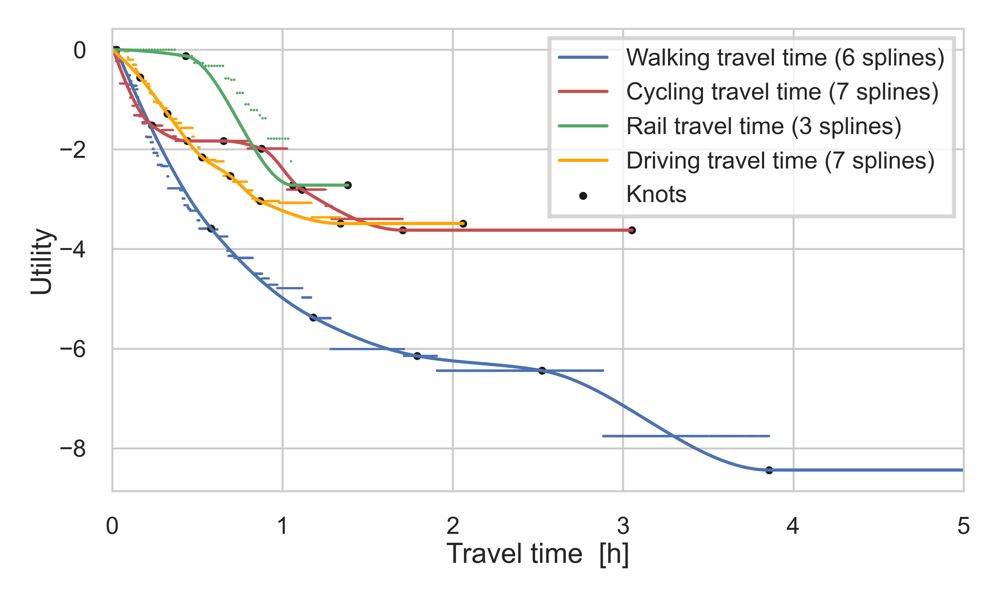

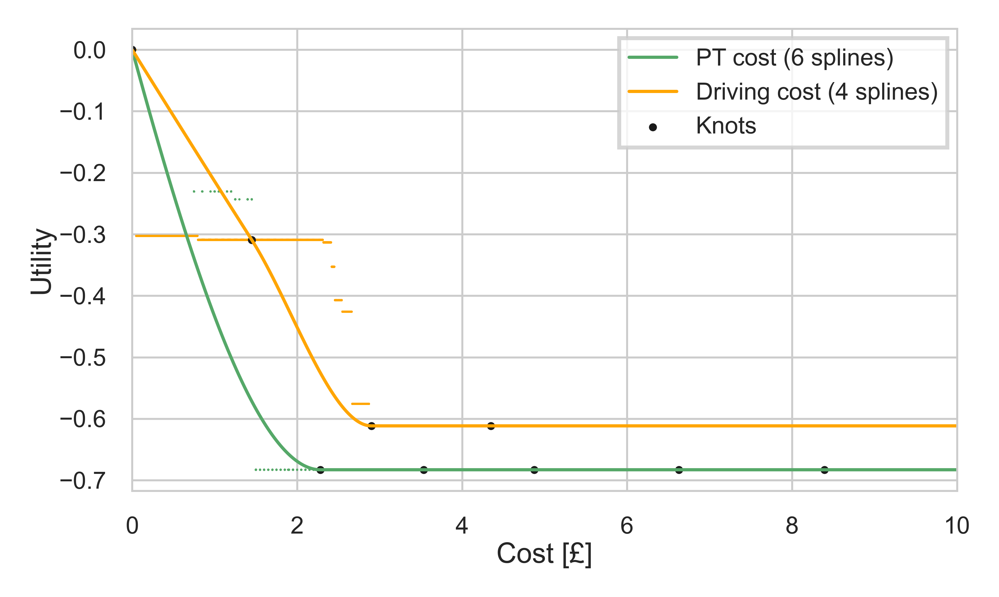

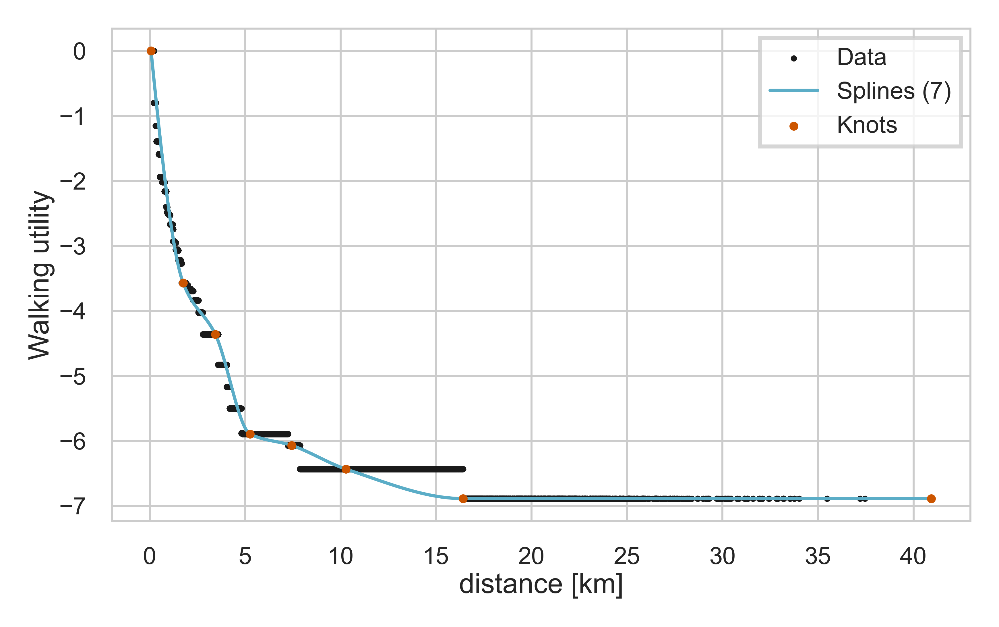

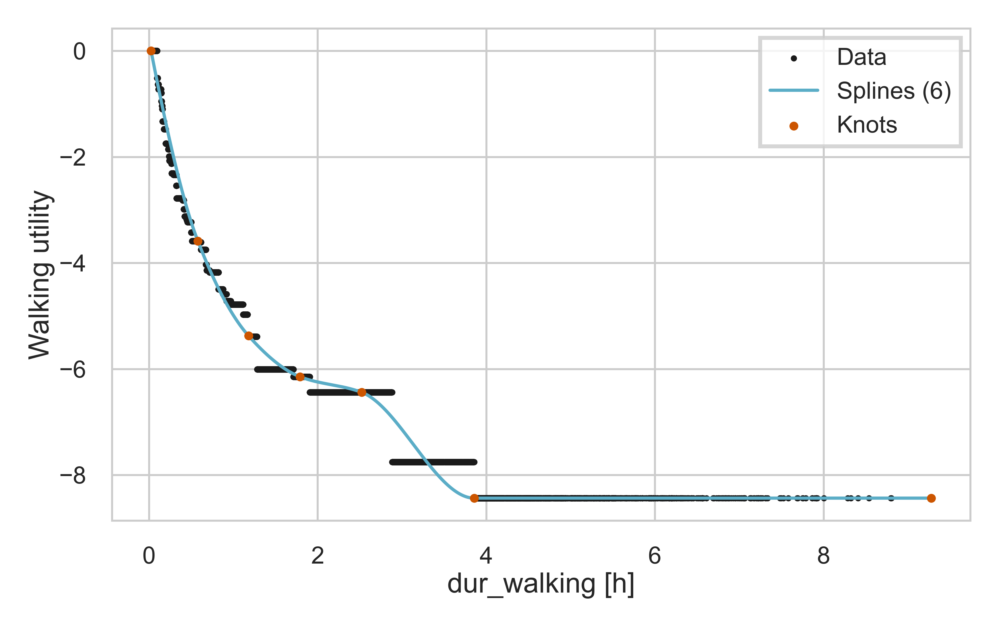

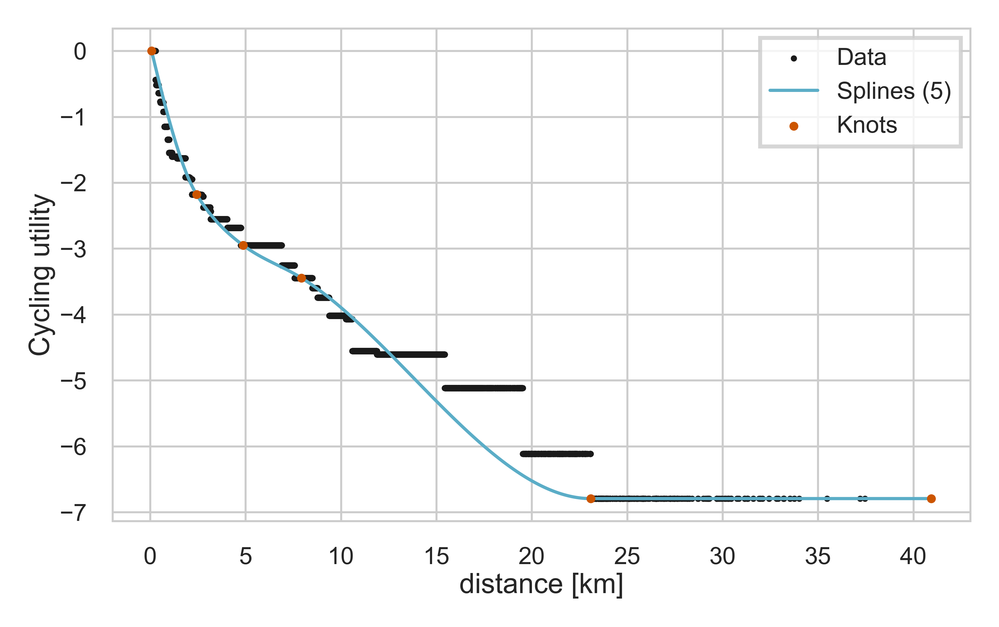

...

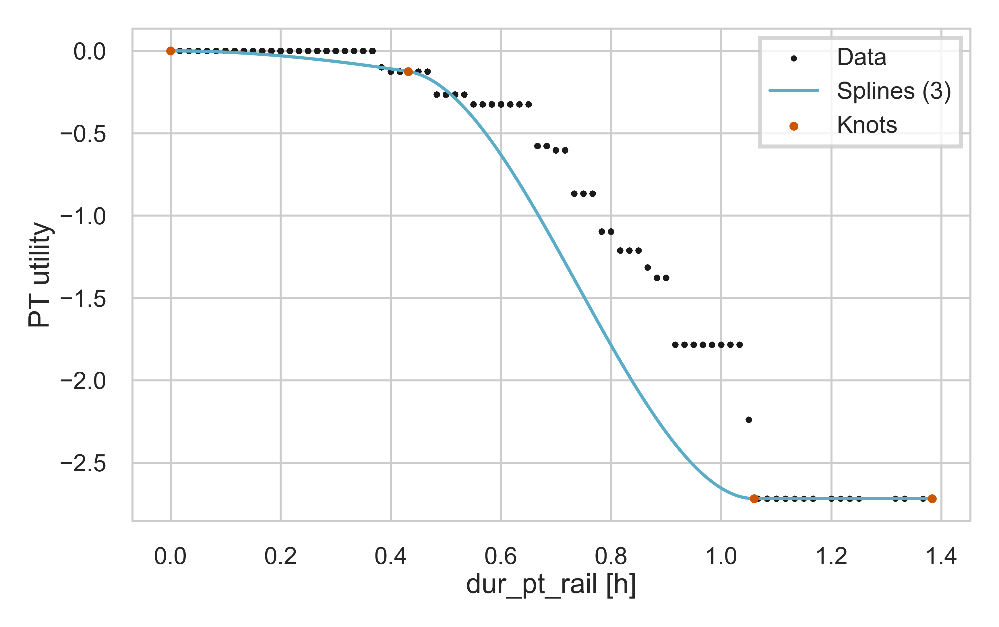

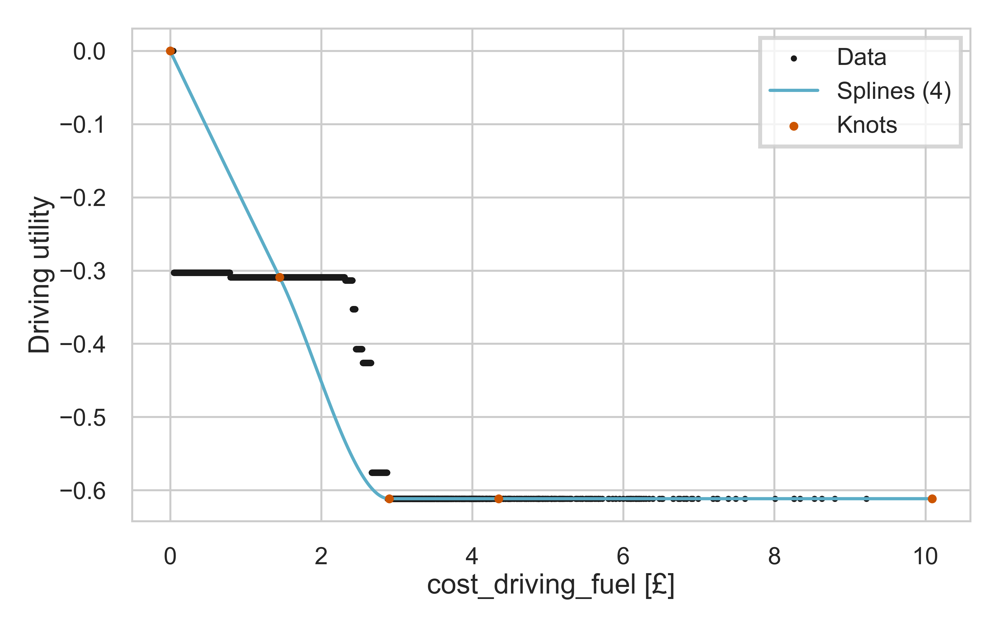

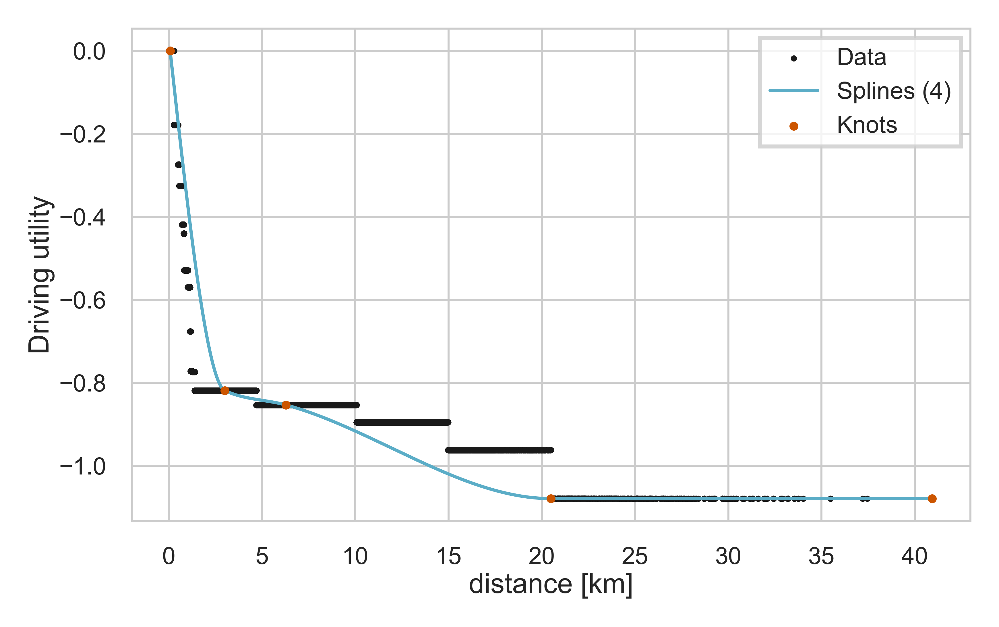

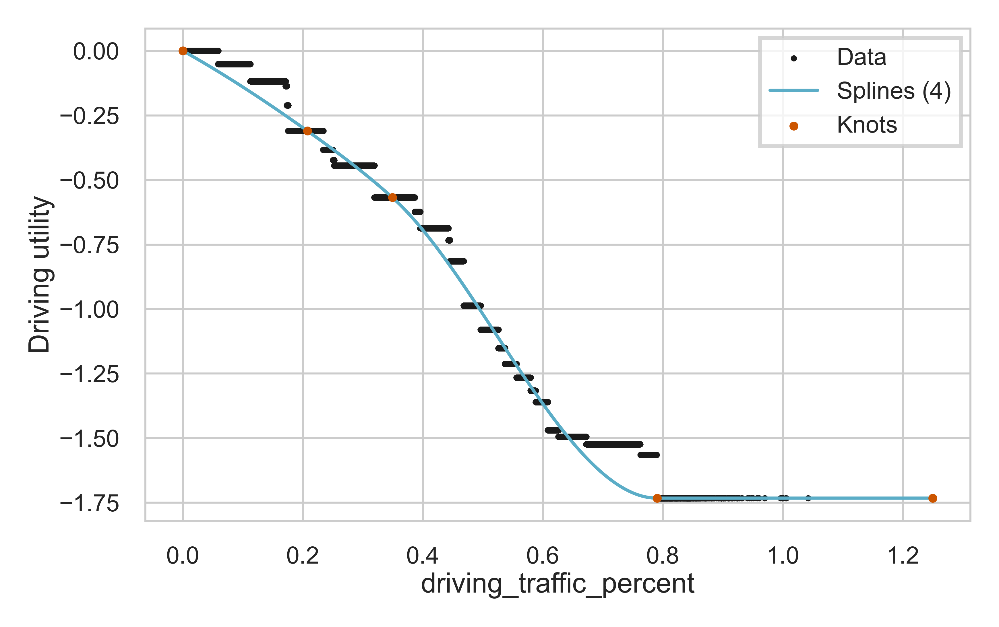

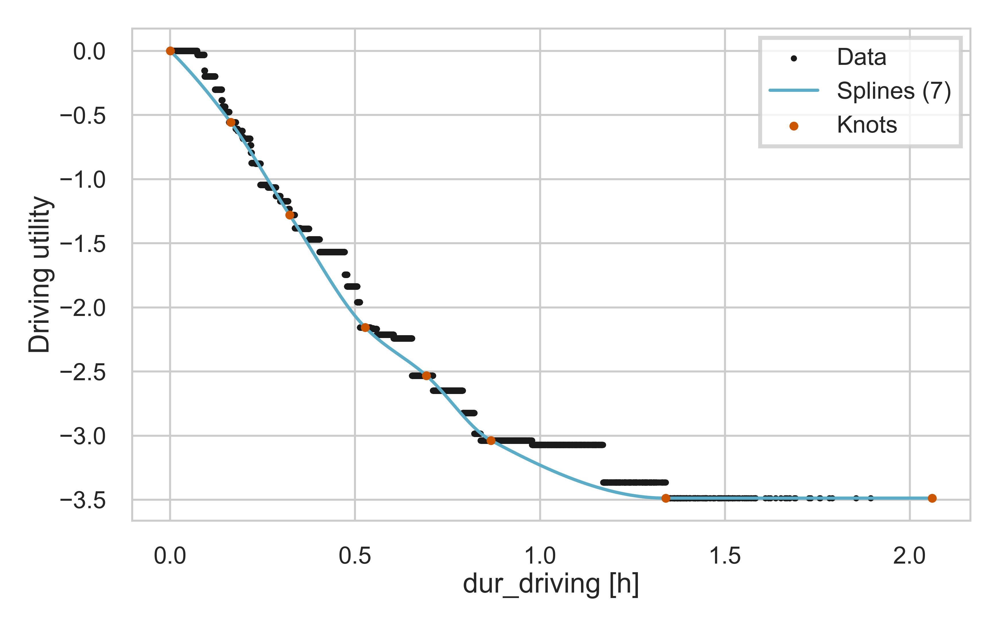

In [188]:
best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True)

### No optimisation of knots position BIC =True, linear_extrapolation = True

We set `optimise=False`, and this allow us to test several knots position at the same time.

##### First and last knots not fixed, with linear extrapolation bic=True, optimise = True, first_last_knot_fixed=False, linear_extrapolation=True)



In [189]:
# param_space = {'0':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_0', 3, 7,1)),
#'dur_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_walking', 3, 7,1))},
#'1':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_1', 3, 7,1)),
#'dur_cycling': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_cycling', 3, 7,1))},
#'2':{'cost_transit': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_transit', 3, 7,1)),
##'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_2', 3, 7,1)),
#'dur_pt_access': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_access', 3, 7,1)),
#'dur_pt_bus': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_bus', 3, 7,1)),
#'dur_pt_int_waiting': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_waiting', 3, 7,1)),
#'dur_pt_int_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_walking', 3, 7,1)),
#'dur_pt_rail': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_rail', 3, 7,1))},
#'3':{'cost_driving_fuel': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_driving_fuel', 3, 7,1)),
#'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_3', 3, 7,1)),
#'driving_traffic_percent': hyperopt.pyll.scope.int(hyperopt.hp.quniform('driving_traffic_percent', 3, 7,1)),
#'dur_driving': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_driving', 3, 7,1))}
# }

# optimal number of splines (number of knots-1)
param_space = {
    "0": {"distance": 4, "dur_walking": 5},
    "1": {"distance": 7, "dur_cycling": 6},
    "2": {
        "cost_transit": 3,
        "dur_pt_access": 3,
        "dur_pt_bus": 7,
        "dur_pt_int_waiting": 4,
        "dur_pt_int_walking": 7,
        "dur_pt_rail": 4,
    },
    "3": {
        "cost_driving_fuel": 3,
        "distance": 4,
        "driving_traffic_percent": 5,
        "dur_driving": 5,
    },
}

In [190]:
def objective(space):
    dataset_train, _, _ = load_preprocess_LPMC(path="../Data/")
        
    weights = weights_to_plot_v2(LPMC_model_fully_trained)

    spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['distance', 'dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_access', 'dur_pt_int_walking', 'dur_pt_int_waiting'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}

    target = 'choice'

    spline_collection = space

    x_opt, x_first, x_last, loss = optimal_knots_position(weights, dataset_train, dataset_train, dataset_train[target], spline_utilities, spline_collection, max_iter = 200, bic=True, optimise = True, n_iter=1, first_last_knot_fixed=False, linear_extrapolation=True)

    return {'loss': loss, 'x_opt':x_opt.x, 'status': hyperopt.STATUS_OK, 'x_first': x_first, 'x_last': x_last}

n=25
# n=1
trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n,
                                trials=trials)

best_classifier['_best_loss'] = trials.best_trial['result']['loss']
best_classifier['_x_opt'] = trials.best_trial['result']['x_opt']
best_classifier['_x_first'] = trials.best_trial['result']['x_first']
best_classifier['_x_last'] = trials.best_trial['result']['x_last']

  0%|          | 0/25 [00:00<?, ?trial/s, best loss=?]

Inequality constraints incompatible    (Exit mode 4)  
            Current function value:                   
73722.8512775701                                      
            Iterations:                               
1                                                     
            Function evaluations:                     
82                                                    
            Gradient evaluations:                     
1                                                     
1/1:73722.8512775701 with knots at: [7.70000000e-02 2.87037500e+00 5.90075000e+00 1.02511250e+01
 1.97980000e+01 2.52777780e-02 6.85766667e-01 1.34236667e+00
 2.07432222e+00 3.02668889e+00 4.86838889e+00 7.70000000e-02
 1.68807143e+00 3.26414286e+00 4.97421429e+00 6.95028571e+00
 9.48035714e+00 1.30417143e+01 1.97980000e+01 6.11111100e-03
 2.46773148e-01 4.85768518e-01 7.26152778e-01 9.76814815e-01
 1.26775463e+00 1.72855556e+00 0.00000000e+00 3.38916667e+00
 6.25666667e+00 1.00350000e+01 0.00000000e

In [191]:
weights = weights_to_plot_v2(LPMC_model_fully_trained)

# spline_collection = {'0':{'distance': int(best_classifier['distance_0']),
#                     'dur_walking': int(best_classifier['dur_walking'])},
#             '1':{'distance': int(best_classifier['distance_1']),
#                     'dur_cycling': int(best_classifier['dur_cycling'])},
#             '2':{'cost_transit': int(best_classifier['cost_transit']),
#                     #'distance': int(best_classifier['distance_2']),
#                     'dur_pt_access': int(best_classifier['dur_pt_access']),
#                     'dur_pt_bus': int(best_classifier['dur_pt_bus']),
#                     'dur_pt_int_waiting': int(best_classifier['dur_pt_int_waiting']),
#                     'dur_pt_int_walking': int(best_classifier['dur_pt_int_walking']),
#                     'dur_pt_rail': int(best_classifier['dur_pt_rail'])},
#             '3':{'cost_driving_fuel': int(best_classifier['cost_driving_fuel']),
#                     'distance': int(best_classifier['distance_3']),
#                     'driving_traffic_percent': int(best_classifier['driving_traffic_percent']),
#                     'dur_driving': int(best_classifier['dur_driving'])}
#                 }


spline_collection = {
    "0": {"distance": 4, "dur_walking": 5},
    "1": {"distance": 7, "dur_cycling": 6},
    "2": {
        "cost_transit": 3,
        "dur_pt_access": 3,
        "dur_pt_bus": 7,
        "dur_pt_int_waiting": 4,
        "dur_pt_int_walking": 7,
        "dur_pt_rail": 4,
    },
    "3": {
        "cost_driving_fuel": 3,
        "distance": 4,
        "driving_traffic_percent": 5,
        "dur_driving": 5,
    },
}
spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_int_waiting', 'dur_pt_int_walking', 'dur_pt_access'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}
x_knots_dict = map_x_knots(trials.best_trial['result']['x_opt'], spline_collection, trials.best_trial['result']['x_first'], trials.best_trial['result']['x_last'])
util_collection = updated_utility_collection(weights, LPMC_train, spline_collection, spline_utilities, mean_splines=False, x_knots = x_knots_dict, linear_extrapolation=True)

y_pred = smooth_predict(LPMC_test, util_collection)
CE_final = cross_entropy(y_pred, LPMC_test['choice'])
best_classifier['_on_test_set'] = CE_final

print(f'Smoothed final cross entropy loss: {CE_final}')

Smoothed final cross entropy loss: 0.687427113117567


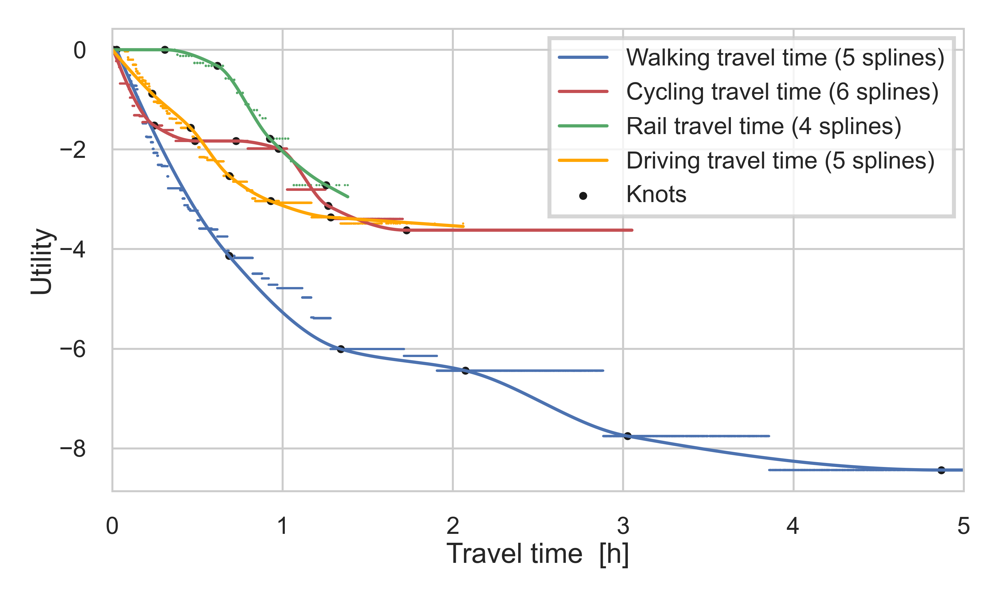

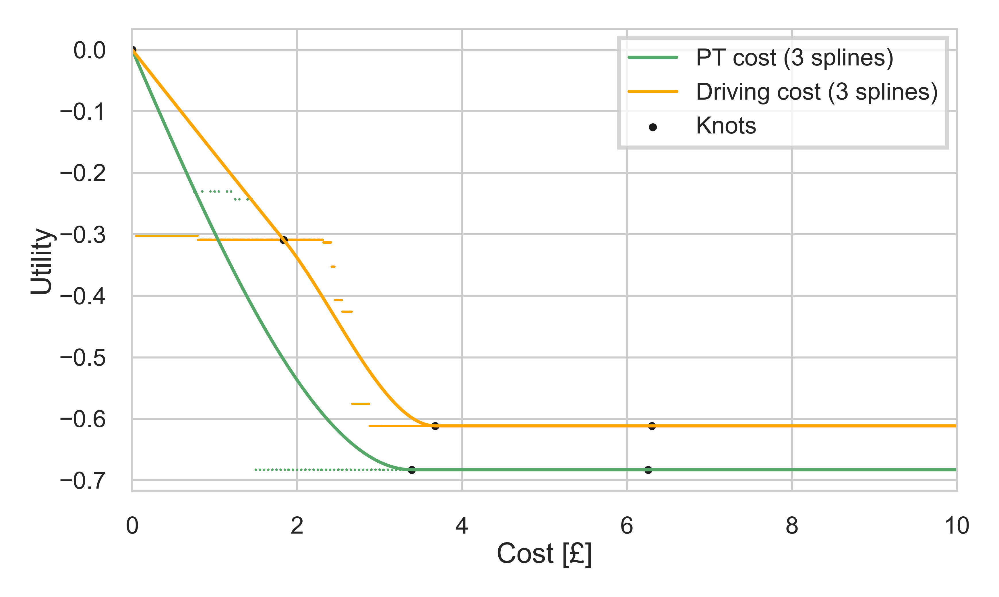

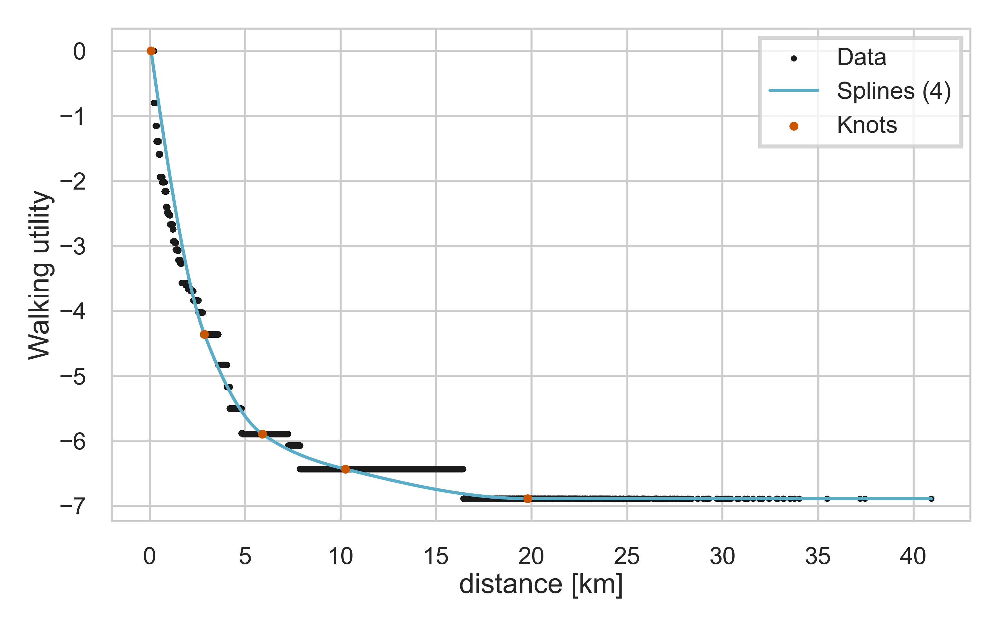

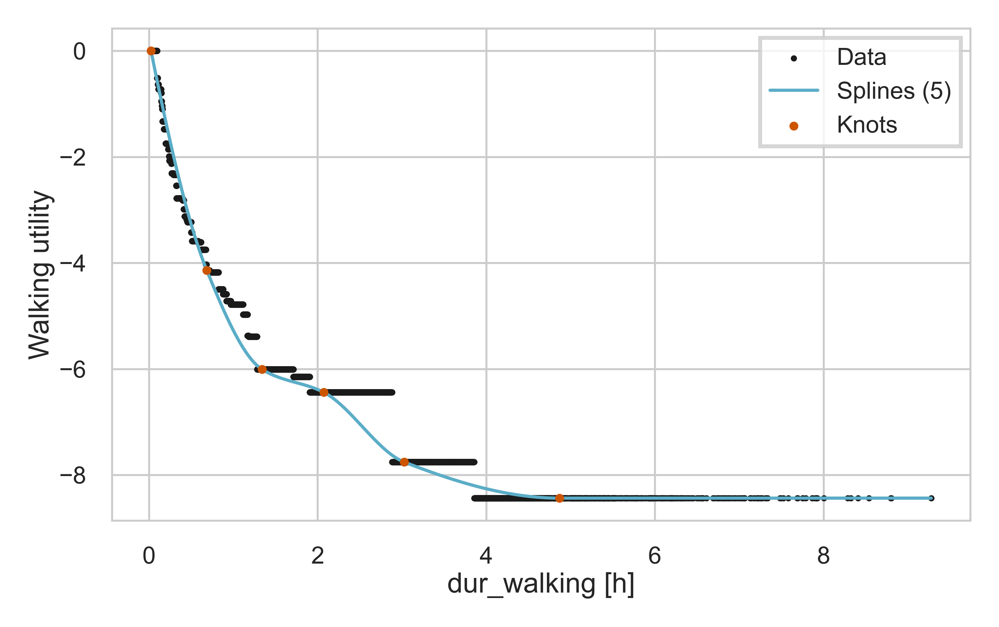

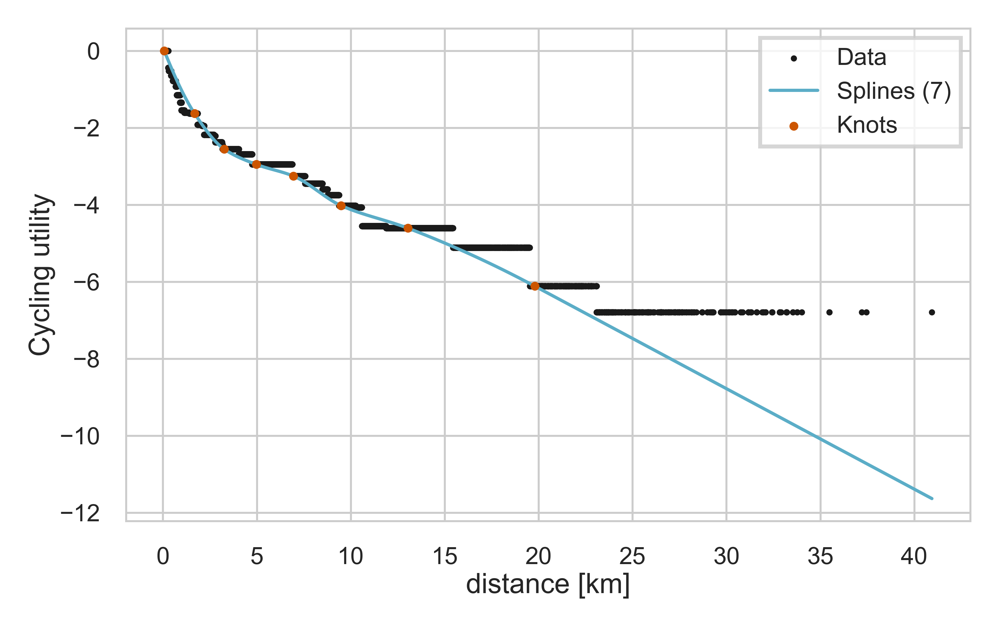

...

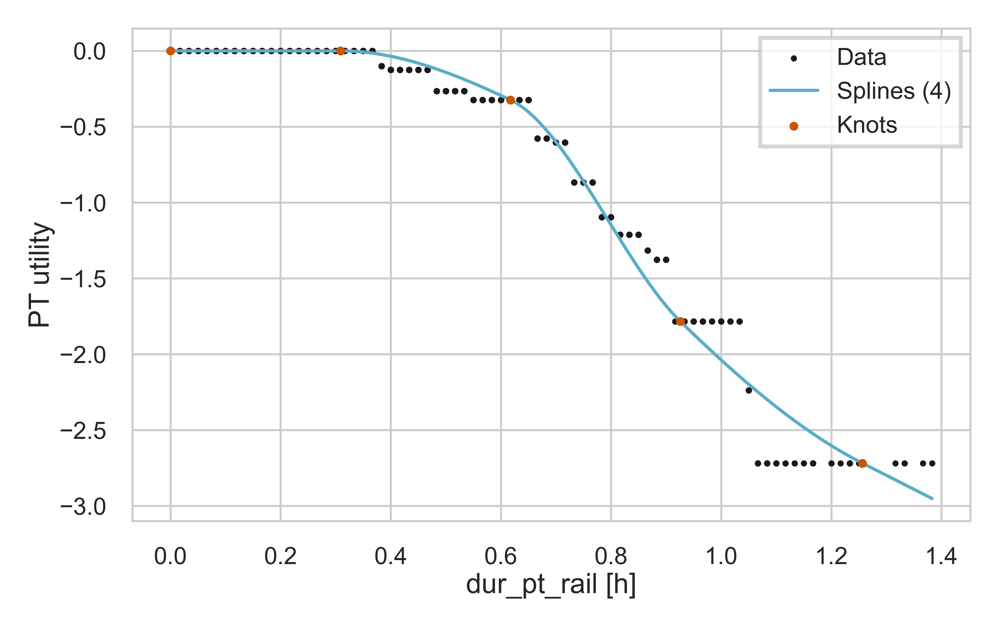

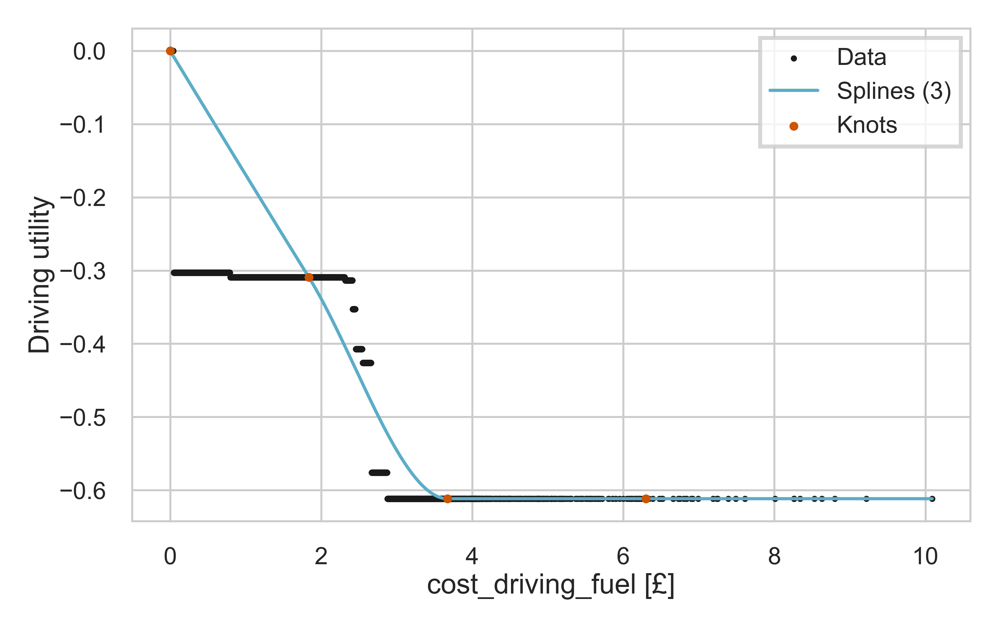

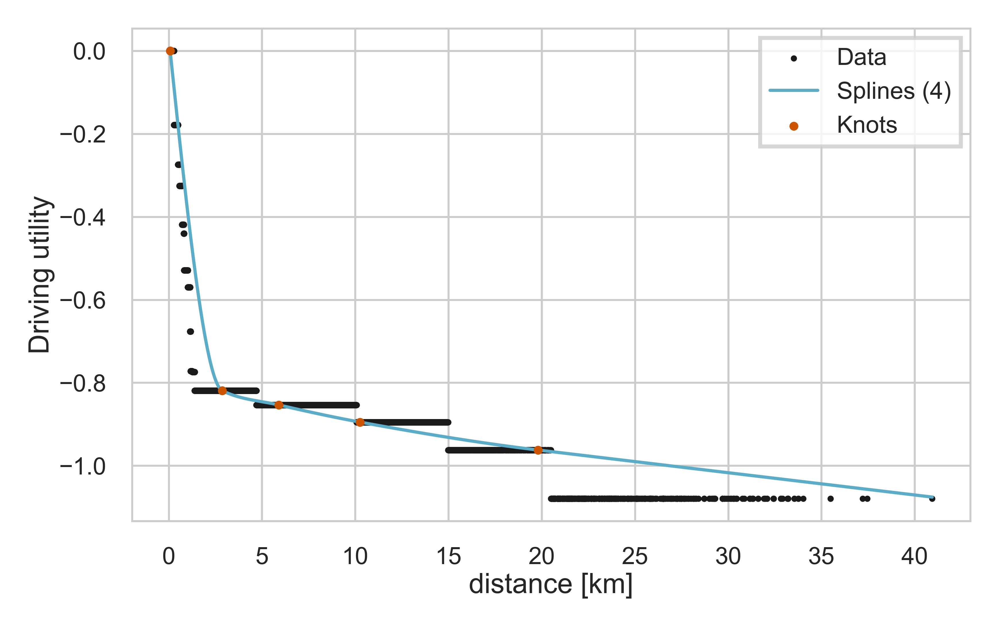

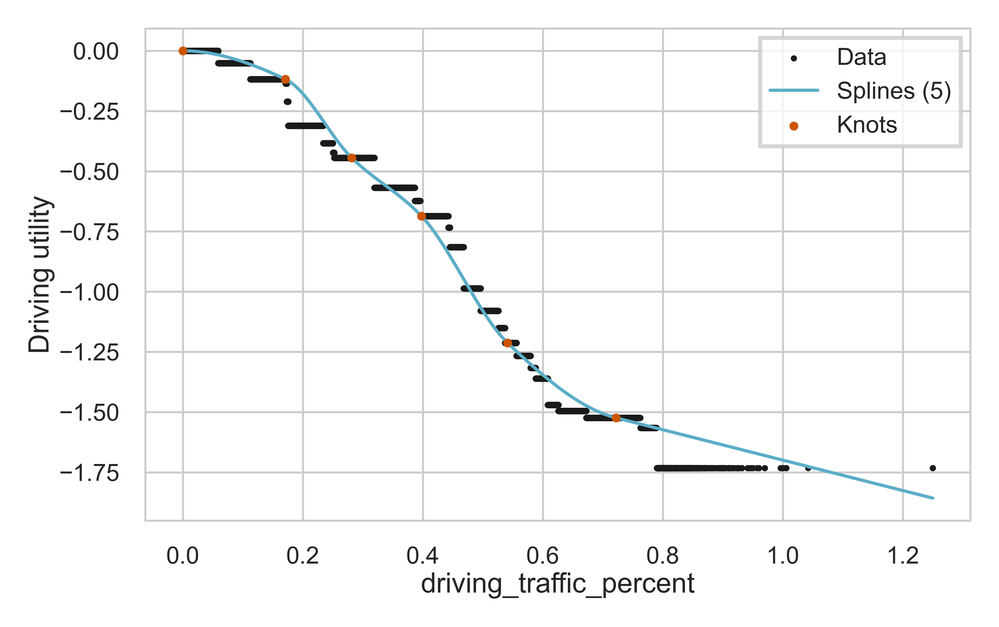

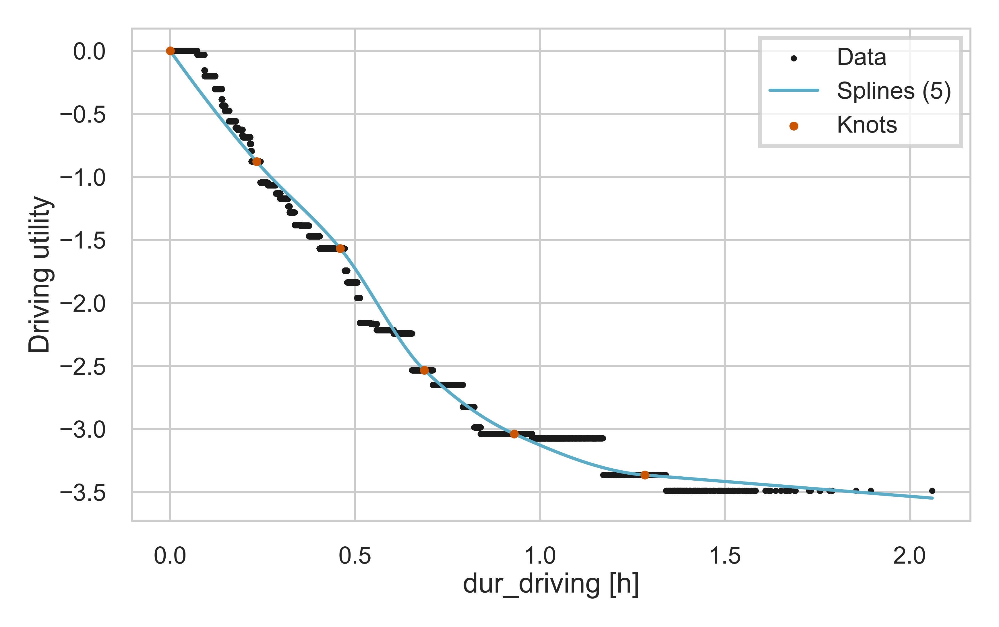

In [192]:
best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True, linear_extrapolation=True)

##### First and last knots fixed, with optimise off bic=True, optimise = False, n_iter=1, first_last_knot_fixed=True, linear_extrapolation=True)


In [193]:
# param_space = {'0':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_0', 3, 7,1)),
#'dur_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_walking', 3, 7,1))},
#'1':{'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_1', 3, 7,1)),
#'dur_cycling': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_cycling', 3, 7,1))},
#'2':{'cost_transit': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_transit', 3, 7,1)),
##'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_2', 3, 7,1)),
#'dur_pt_access': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_access', 3, 7,1)),
#'dur_pt_bus': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_bus', 3, 7,1)),
#'dur_pt_int_waiting': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_waiting', 3, 7,1)),
#'dur_pt_int_walking': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_int_walking', 3, 7,1)),
#'dur_pt_rail': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_pt_rail', 3, 7,1))},
#'3':{'cost_driving_fuel': hyperopt.pyll.scope.int(hyperopt.hp.quniform('cost_driving_fuel', 3, 7,1)),
#'distance': hyperopt.pyll.scope.int(hyperopt.hp.quniform('distance_3', 3, 7,1)),
#'driving_traffic_percent': hyperopt.pyll.scope.int(hyperopt.hp.quniform('driving_traffic_percent', 3, 7,1)),
#'dur_driving': hyperopt.pyll.scope.int(hyperopt.hp.quniform('dur_driving', 3, 7,1))}
# }

# optimal number of splines (number of knots-1)
param_space = {
    "0": {"distance": 4, "dur_walking": 5},
    "1": {"distance": 7, "dur_cycling": 6},
    "2": {
        "cost_transit": 3,
        "dur_pt_access": 3,
        "dur_pt_bus": 7,
        "dur_pt_int_waiting": 4,
        "dur_pt_int_walking": 7,
        "dur_pt_rail": 4,
    },
    "3": {
        "cost_driving_fuel": 3,
        "distance": 4,
        "driving_traffic_percent": 5,
        "dur_driving": 5,
    },
}

In [194]:
def objective(space):
    dataset_train, _, _ = load_preprocess_LPMC(path="../Data/")
        
    weights = weights_to_plot_v2(LPMC_model_fully_trained)

    spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['distance', 'dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_access', 'dur_pt_int_walking', 'dur_pt_int_waiting'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}

    target = 'choice'

    spline_collection = space

    x_opt, x_first, x_last, loss = optimal_knots_position(weights, dataset_train, dataset_train, dataset_train[target], spline_utilities, spline_collection, max_iter = 200, bic=True, optimise = False, n_iter=1, first_last_knot_fixed=True, linear_extrapolation=True)

    return {'loss': loss, 'x_opt':x_opt, 'status': hyperopt.STATUS_OK, 'x_first': x_first, 'x_last': x_last}

n=50
#n=1
trials = hyperopt.Trials()
best_classifier = hyperopt.fmin(fn=objective,
                                space=param_space,
                                algo=hyperopt.tpe.suggest,
                                max_evals=n,
                                trials=trials)

best_classifier['_best_loss'] = trials.best_trial['result']['loss']
best_classifier['_x_opt'] = trials.best_trial['result']['x_opt']
best_classifier['_x_first'] = trials.best_trial['result']['x_first']
best_classifier['_x_last'] = trials.best_trial['result']['x_last']

  0%|          | 0/50 [00:00<?, ?trial/s, best loss=?]

1/1:74323.84747361018                                 
1/1:74323.84747361018                                                          
1/1:74323.84747361018                                                          
1/1:74323.84747361018                                                          
1/1:74323.84747361018                                                          
1/1:74323.84747361018                                                          
1/1:74323.84747361018                                                          
1/1:74323.84747361018                                                          
1/1:74323.84747361018                                                          
1/1:74323.84747361018                                                          
1/1:74323.84747361018                                                           
1/1:74323.84747361018                                                           
1/1:74323.84747361018                                          

In [195]:
weights = weights_to_plot_v2(LPMC_model_fully_trained)

# spline_collection = {'0':{'distance': int(best_classifier['distance_0']),
#                     'dur_walking': int(best_classifier['dur_walking'])},
#             '1':{'distance': int(best_classifier['distance_1']),
#                     'dur_cycling': int(best_classifier['dur_cycling'])},
#             '2':{'cost_transit': int(best_classifier['cost_transit']),
#                     #'distance': int(best_classifier['distance_2']),
#                     'dur_pt_access': int(best_classifier['dur_pt_access']),
#                     'dur_pt_bus': int(best_classifier['dur_pt_bus']),
#                     'dur_pt_int_waiting': int(best_classifier['dur_pt_int_waiting']),
#                     'dur_pt_int_walking': int(best_classifier['dur_pt_int_walking']),
#                     'dur_pt_rail': int(best_classifier['dur_pt_rail'])},
#             '3':{'cost_driving_fuel': int(best_classifier['cost_driving_fuel']),
#                     'distance': int(best_classifier['distance_3']),
#                     'driving_traffic_percent': int(best_classifier['driving_traffic_percent']),
#                     'dur_driving': int(best_classifier['dur_driving'])}
#                 }


spline_collection = {
    "0": {"distance": 4, "dur_walking": 5},
    "1": {"distance": 7, "dur_cycling": 6},
    "2": {
        "cost_transit": 3,
        "dur_pt_access": 3,
        "dur_pt_bus": 7,
        "dur_pt_int_waiting": 4,
        "dur_pt_int_walking": 7,
        "dur_pt_rail": 4,
    },
    "3": {
        "cost_driving_fuel": 3,
        "distance": 4,
        "driving_traffic_percent": 5,
        "dur_driving": 5,
    },
}
spline_utilities = {'0':['distance', 'dur_walking'],'1':['distance', 'dur_cycling'], '2':['dur_pt_rail', 'dur_pt_bus', 'cost_transit', 'dur_pt_int_waiting', 'dur_pt_int_walking', 'dur_pt_access'], '3': ['distance', 'dur_driving','cost_driving_fuel', 'driving_traffic_percent']}
x_knots_dict = map_x_knots(trials.best_trial['result']['x_opt'], spline_collection, trials.best_trial['result']['x_first'], trials.best_trial['result']['x_last'])
util_collection = updated_utility_collection(weights, LPMC_train, spline_collection, spline_utilities, mean_splines=False, x_knots = x_knots_dict, linear_extrapolation=True)

y_pred = smooth_predict(LPMC_test, util_collection)
CE_final = cross_entropy(y_pred, LPMC_test['choice'])
best_classifier['_on_test_set'] = CE_final

print(f'Smoothed final cross entropy loss: {CE_final}')

Smoothed final cross entropy loss: 0.691868971094891


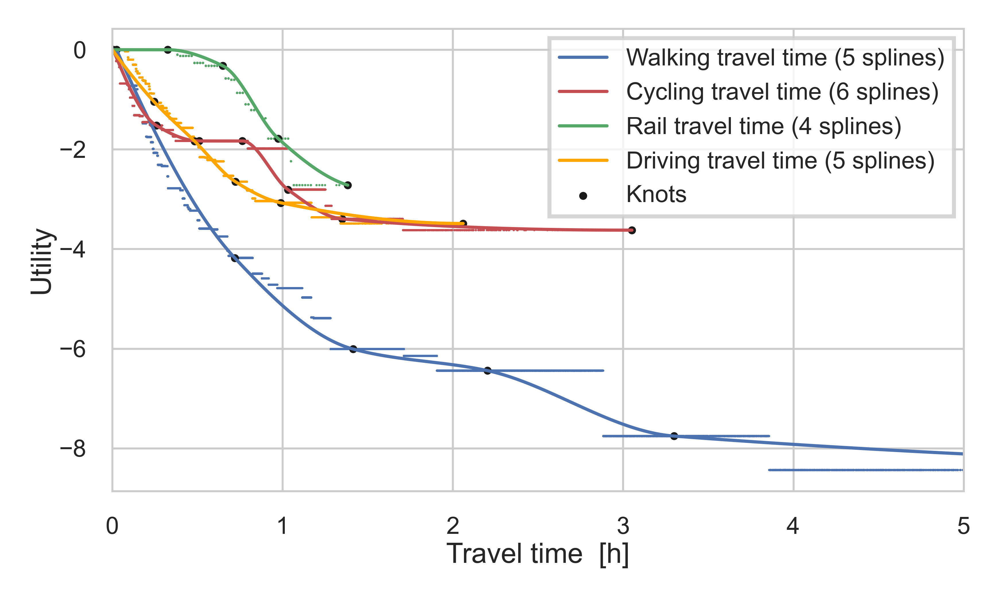

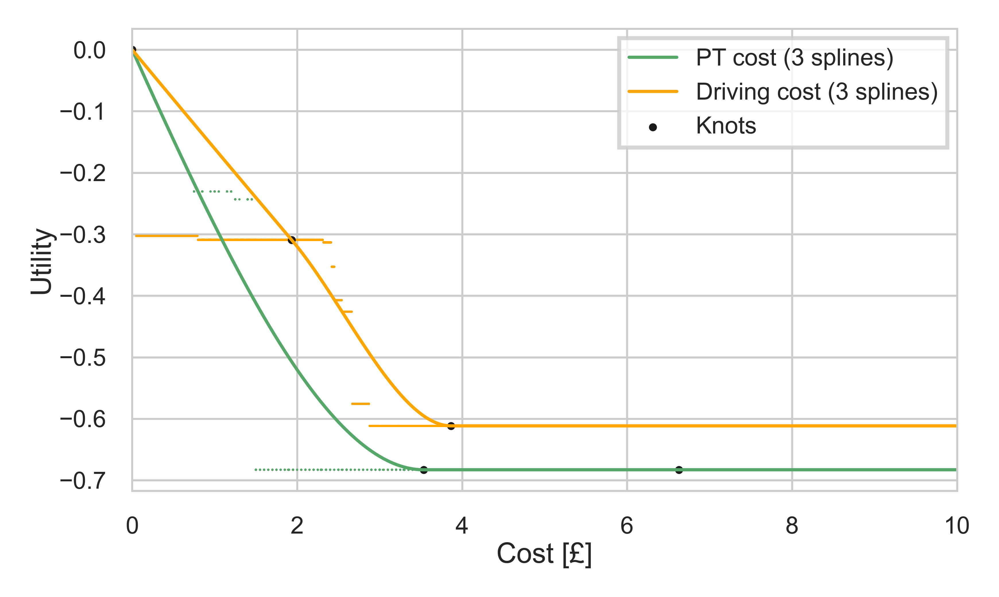

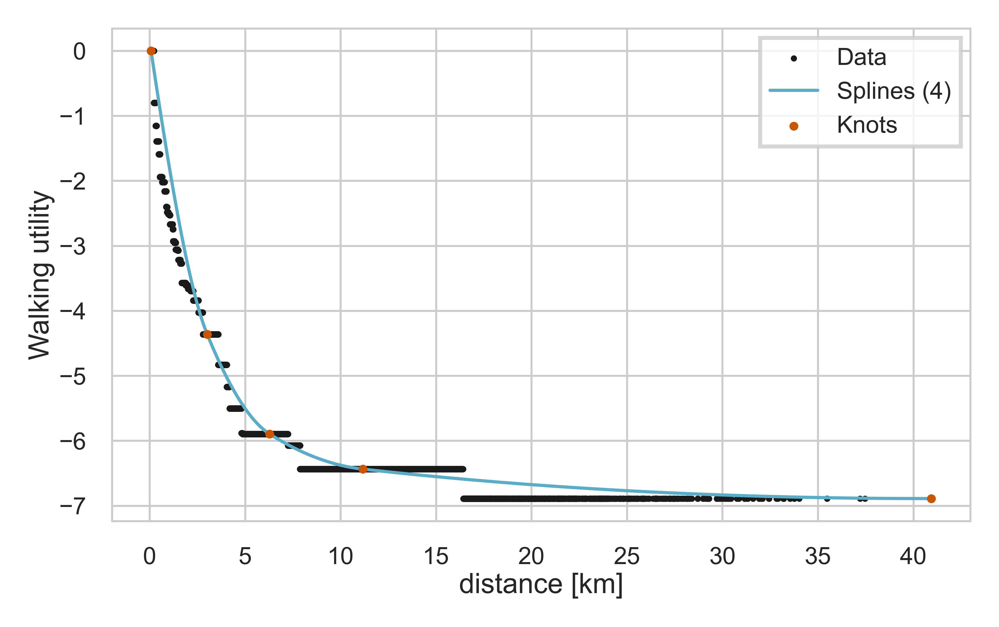

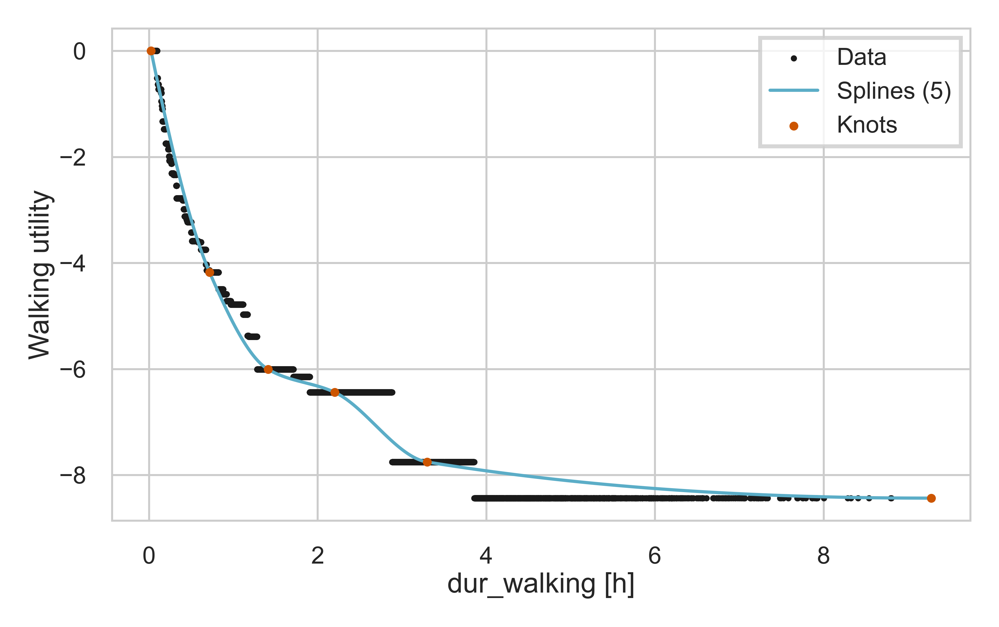

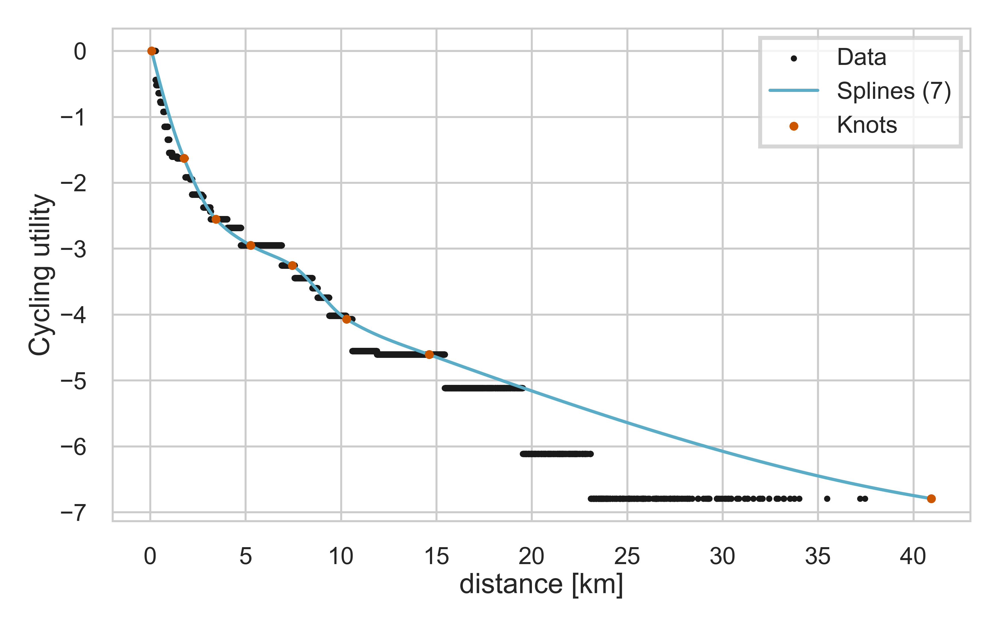

...

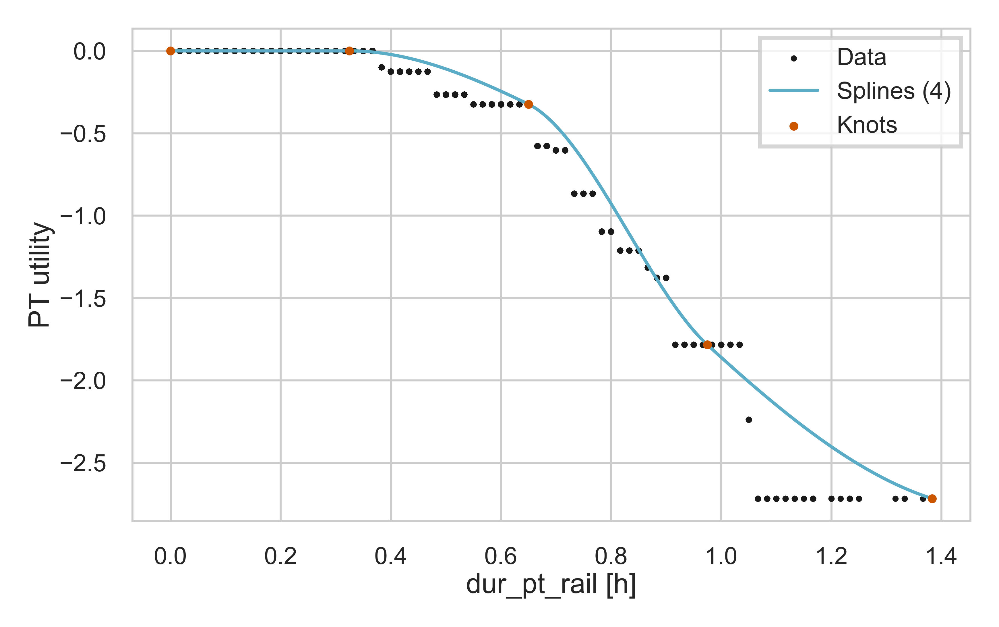

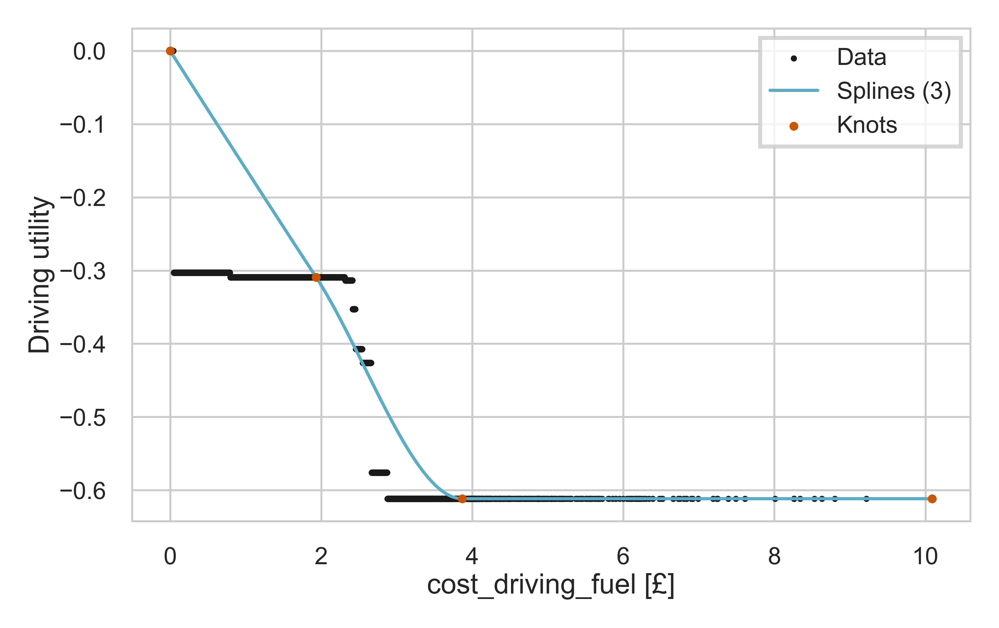

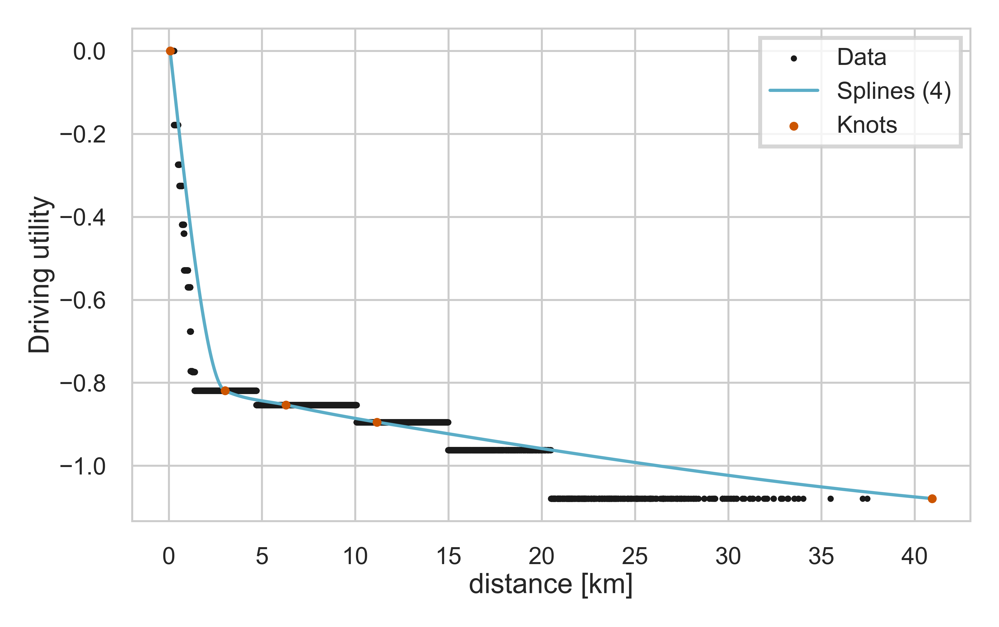

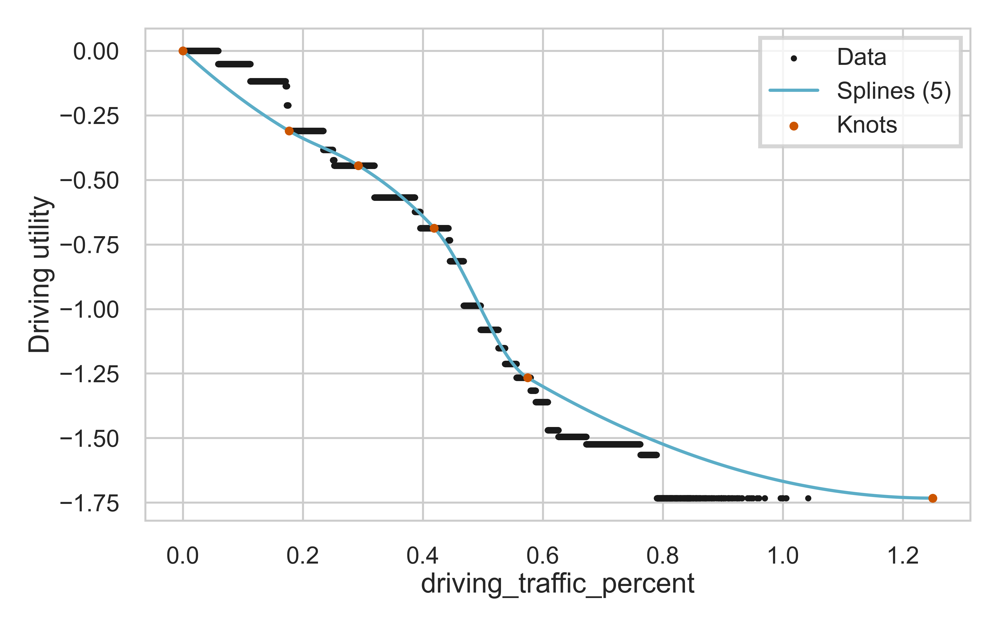

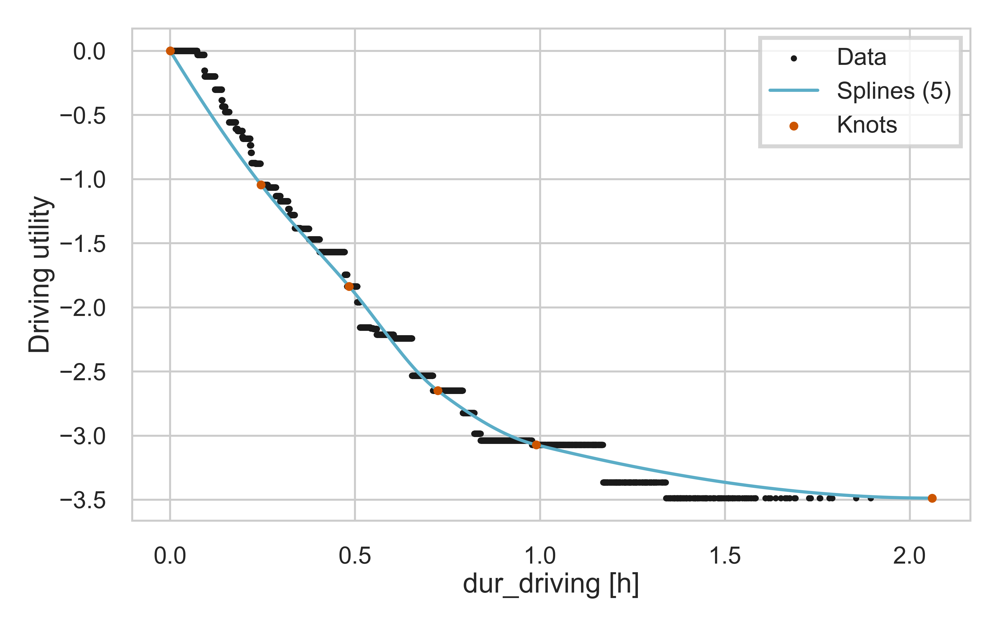

In [ ]:
best_splines = spline_collection
utility_names = {'0':'Walking', '1':'Cycling', '2':'PT', '3':'Driving'}
plot_spline(LPMC_model_fully_trained,LPMC_train,best_splines, utility_names, x_knots_dict=x_knots_dict, lpmc_tt_cost=True, linear_extrapolation=True)

# References

Salvadé, N., & Hillel, T. (2024). Rumboost: Gradient Boosted Random Utility Models. *arXiv preprint [arXiv:2401.11954](https://arxiv.org/abs/2401.11954)*

Hillel, T., Elshafie, M.Z.E.B., Jin, Y., 2018. Recreating passenger mode choice-sets for transport simulation: A case study of London, UK. Proceedings of the Institution of Civil Engineers - Smart Infrastructure and Construction 171, 29–42. https://doi.org/10.1680/jsmic.17.00018